# What Ever Happened To The Simpsons?
---

In this `jupyter notebook`, the widely known series *The Simpsons* is investigated - namely, how the series has changed over the 30 years it has been on television. The series has been on television for 30 years but has seen it's popularity decline rapidly over the years. 

Some say it’s because of new writers, but here the goal is dig into scripts and the synopsis of each episode in order to see if any patterns can be detected that could help us understand what has happened to the series.


A lot of data was collected, cleaned and analyzed in order to see if there are any patterns that emerge or if there have been any significant changes within the essence of the series itself that could explain the reduced popularity. 

The synopsis for each episode are analyzed and from that, networks for each season are created in order to investigate the interaction between characters. 

The scripts for the first 26 seasons will be analyzed in order to see if there are any changes in the way the show is written in regards to sentimental value and the words spoken in each season. 

A website has been created that is dedicated to telling the story of this project and its findings. The webiste can be found [here](https://audurannaj.github.io/the-simpsons/). A seperate website dedicated to visualizing the networks created for this project can be found [here](https://audurannaj.github.io/the-simpsons/networks.html).

---

# Table of Contents

### [1. Motivation](#one)

### [2. Data Collection, Cleaning and Initial Analysis](#two)

* #### [2.1 Data Collection and Cleaning](#two.one)

    * [2.1.1 Episode Information](#two.one.one)

    * [2.1.2 Episode Ratings](#two.one.two)

    * [2.1.3 Scripts of Episodes](#two.one.three)

    * [2.1.4 Wikipedia (Simpsons.fandom) Pages of Each Episode](#two.one.four)

    * [2.1.5 Creating Text Files of Synopsis](#two.one.five)

    * [2.1.6 Characters](#two.one.six)

    * [2.1.7 Cleaning of Character Names](#two.one.seven)

    * [2.1.8 Demographic Ratings](#two.one.eight)

* #### [2.2 Visualizing the Downfall of The Simpsons](#two.two)

    * [2.2.1 Changes between Demographics](#two.two.one)

    * [2.2.2 Summary of Findings](#two.two.two)


### [3. Tools, Theory and Analysis](#three)
* #### [3.1 TF-IDF Analysis and Words Spoken](#three.one)

    * [3.1.1 Synopsis TF-IDF](#three.one.one)
        * [3.1.1.1 Synopsis Preparation](#three.one.one.one)
        * [3.1.1.2 Synopsis TF-IDF Analysis](#three.one.one.two)

    * [3.1.2 Scripts TF-IDF](#three.one.two)
        * [3.1.2.1 Scripts Preparation](#three.one.two.one)
        * [3.1.2.2 Scripts TF-IDF Analysis](#three.one.two.two)

    * [3.1.3 TF-IDF per Character per Season](#three.one.three)   
        * [3.1.3.1 Homer Simpson](#three.one.three.one)
        * [3.1.3.2 Marge Simpson](#three.one.three.two)
        * [3.1.3.3 Bart Simpson](#three.one.three.three)
        * [3.1.3.4 Lisa Simpson](#three.one.three.four)
    
    * [3.1.4 Summary of Findings](#three.one.four)

* #### [3.2 Sentimental Analysis](#three.two)
    * [3.2.1 Sentiment Analysis for the Seasons](#three.two.one)
    * [3.2.2 Sentiment Analysis of each Character in each Season](#three.two.two)
    * [3.2.3 Sentiment Analysis of the Synopsis](#three.two.three)
    * [3.2.4 Summary of Findings](#three.two.four)


* #### [3.3 The Networks for each Season](#three.three)

    * [3.3.1 Creating the Networks](#three.three.one)

    * [3.3.2 Analyzing the Networks](#three.three.two)

        * [3.3.2.1 Changes in Number of Nodes and Edges](#three.three.two.one)
    
        * [3.3.2.2 The Importance of Characters - Centrality Analysis](#three.three.two.two)
            * [3.3.2.2.1 Degree Centrality](#three.three.two.two.one)
            * [3.3.2.2.2 Betweenness Centrality](#three.three.two.two.two)
            * [3.3.2.2.3 Eigenvector Centrality](#three.three.two.two.three)
        
    * [3.3.3 Summary of Findings](#three.three.three)

* #### [3.4 The Combined Network of all Seasons ](#three.four)

    * [3.4.1 Creating the Network](#three.four.one)

    * [3.4.2 Community Analysis](#three.four.two)

    * [3.4.3 Summary of Findings](#three.four.three)

* #### [3.5 Summary of Findings](#three.five)


### [4. Discussion](#four)

### [5. Contributions](#five)

In [69]:
import requests
import pandas as pd
from bs4 import BeautifulSoup
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import urllib.request
import unidecode
import json
import io
import random
import os
import os.path
import nltk, re, pprint
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import itertools
import networkx as nx
from fa2 import ForceAtlas2
from collections import Counter
import warnings
import community
from community import community_louvain
import sklearn
from sklearn import preprocessing
import colorsys
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
warnings.filterwarnings("ignore")
from nltk import sent_tokenize
import pingouin as pg
from wordcloud import WordCloud

# 1. Motivation  <a class="anchor" id="one"></a>

In order to create the networks and analyze text related to the series, a lot of data needed to be collected and cleaned. 

The following table explains what datasets were used throughout the project, their attributes, size and how they were obtained. 


| Dataset             | Info                                                                                          | Originally obtained from       |Size|  |
|---------------------|-----------------------------------------------------------------------------------------------|---------------------|----|----------|
| **Episode Information** | Each episode's relevant information, such as how many viewers saw the episode, airdate, etc.  | Wikipedia       | 47KB  | [Download](data_to_download/episode_information.csv) |
| **Ratings**             | Each episode's rating                                                                         | IMDB            |  18KB  | [Download](data_to_download/ratings.csv) |
| **Demographic Ratings** | Each episode's rating for different demographics                                              | IMDB            |  77KB  | [Download](data_to_download/demographic_ratings.csv) |
| **Characters**          | Each character that has appeared in The Simpsons                                              | Simpsons.Fandom.com| 21KB | [Download](data_to_download/characters.csv) |
| **Scripts**             | A dataset comprised of the lines that appear in each episode (Seasons 1-26)                   | Data.World      |  36MB  | [Download](data_to_download/script_extended.csv) |
| **Synopsis**            | Each episode's synopsis                                                                       | Simpsons.Fandom.com| 339KB | [Download (Zipped)](data_to_download/syns.zip) |

The **Episode Information** dataset was obtained from Wikipedia with web-scraping in order to have an overview of relevant information for all the episodes of the series. This information would later be used in order to connect most of the other datasets obtained together. The dataset holds information about 662 episodes of The Simpsons, all the way back from December 17 1989 to May 12 2019. 

The **Ratings** for each episodes were obtained with the same strategy as the episode information, but now [IMDB's rating site for The Simpsons](https://www.imdb.com/search/title/?series=tt0096697&view=simple&count=250&sort=user_rating,desc&ref_=tt_eps_rhs_sm) was scraped. One rating for each episode was obtained along with the episode's name for all episodes to date. These two datasets (Episode Information and Ratings) were then combined in order to have a larger dataset that held more information. 

The **Demographic Ratings** for each episode were obtained in a similar manner that the **Ratings** dataframe was obtained, by scraping *IMDB*. This time, [each episodes rating site](https://www.imdb.com/title/tt0701122/ratings?ref_=tt_ov_rt) was scraped in order to obtain ratings from different age groups for both genders, namely *Males under 18*, *Males between 18 and 29*, *Males between 30 and 44*, *Males over 45*, *Females under 18*, *Females between 18 and 29*, *Females between 30 and 44*, *Females over 45*. Of course this dataset could have been a part of the **Ratings** dataset, but as the idea of scraping for demographic ratings came as the project had already progressed a bit, these dataframes were kept seperate. 


The **Characters** dataframe was obtained from [Simpsons.Fandom](https://simpsons.fandom.com/wiki/Category:Characters) Wiki page. All the names of every character that has appeared in the series was scraped along with their relevant Simpsons.Fandom Wiki link, which was used later in order to determine which characters appear in each episode. A total of 556 distinct characters ended up in the dataframe. 

A dataset holding the **Script** for each episode was hard to come by. The dataset that was used was found on [Data.Word](https://data.world/data-society/the-simpsons-by-the-data/workspace/file?filename=simpsons_script_lines.csv). 

In order to obtain the **Synopsis**, [Simpsons.Fandom](https://simpsons.fandom.com/wiki/List_of_Episodes) was again scraped, but this time each episode's page was scraped in order to obtain the synopsis for each and every episode in *HTML* format.


# 2. Data Collection, Cleaning and Initial Analysis <a class="anchor" id="two"></a>

In this section, the necessary data is collected, cleaned and some initial analysis is carried out, mostly in order to see the distribution of the data and how the ratings and number of viewers have developed.

The package `BeautifulSoup` is utilized a lot in this section in order to scrape websites for relevant information.

## 2.1 Data Collection and Cleaning <a class="anchor" id="two.one"></a>

### 2.1.1 Episode Information <a class="anchor" id="two.one.one"></a>

Getting all episode names, dates and relevant information is possible by scraping Wikipedia: 

In [16]:
episode_1_20_url = 'https://en.wikipedia.org/wiki/List_of_The_Simpsons_episodes_(seasons_1%E2%80%9320)#Episodes'
episode_21_31_url = "https://en.wikipedia.org/wiki/List_of_The_Simpsons_episodes"

As there are so many episodes, Wikipedia has seperate pages for the first 20 seasons and the latter 10.

In [17]:
res = requests.get(episode_1_20_url).text
soup = BeautifulSoup(res,'html')
arr = []
next_season = 1
for table in soup.find_all('table', class_='wikiepisodetable'):
    if(table.previous.previous.previous.text != 'The Simpsons Movie'):
        season = table.previous.previous.previous.text.split('(')[1].split(')')[0].split(" ")[1]
        for row in table.find_all('tr')[1::1]:
            data = row.find_all(['th','td'])
            no = data[0].text
            no_in_season = data[1].text
            episode_name = data[2].text[1:len(data[2].text)-1] #Remove the " " 
            airdate = data[5].text
            viewers = data[7].text.split("[")[0]
            arr.append([no,season,no_in_season,episode_name,airdate,viewers])
df_1 = pd.DataFrame(arr)
df_1.columns = ['no_overall','season','no_in_season','episode_name','airdate','viewers (millions)']

Seasons 1 to 20:

In [18]:
df_1.head(3)

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions)
0,1,1,1,Simpsons Roasting on an Open Fire,"December 17, 1989 (1989-12-17)",26.7
1,2,1,2,Bart the Genius,"January 14, 1990 (1990-01-14)",24.5
2,3,1,3,Homer's Odyssey,"January 21, 1990 (1990-01-21)",27.5


Now, the rest of the seasons are retrieved:

In [19]:
res = requests.get(episode_21_31_url).text
soup = BeautifulSoup(res,'html')
arr = []
next_season = 1
for table in soup.find_all('table', class_='wikiepisodetable'):
    if(table.previous.previous.previous.text != 'The Longest Daycare' and table.previous.previous.previous.text):
        season = table.previous.previous.previous.text.split('(')[1].split(')')[0].split(" ")[1]
        for row in table.find_all('tr')[1::1]:
            data = row.find_all(['th','td'])
            no = data[0].text
            no_in_season = data[1].text
            episode_name = data[2].text[1:len(data[2].text)-1] #Remove the " " 
            airdate = data[5].text
            viewers = data[7].text.split("[")[0]
            arr.append([no,season,no_in_season,episode_name,airdate,viewers])
        if(season=='30'):
            break
df_2 = pd.DataFrame(arr)
df_2.columns = ['no_overall','season','no_in_season','episode_name','airdate','viewers (millions)']

Seasons 21 to 30:

In [20]:
df_2.tail(3)

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions)
217,660,30,21,D'oh Canada,"April 28, 2019 (2019-04-28)",1.93
218,661,30,22,Woo-Hoo Dunnit?,"May 5, 2019 (2019-05-05)",1.79
219,662,30,23,Crystal Blue-Haired Persuasion,"May 12, 2019 (2019-05-12)",1.50


Concatinating them together will create the final dataframe for the episodes:

In [21]:
df_episodes = pd.concat([df_1,df_2])

In [22]:
df_episodes.reset_index(inplace=True)
df_episodes.drop('index',axis=1,inplace=True)

df_episodes['no_overall'] = df_episodes['no_overall'].apply(lambda x: int(x))
df_episodes['season'] = df_episodes['season'].apply(lambda x: int(x))
df_episodes['no_in_season'] = df_episodes['no_in_season'].apply(lambda x: int(x))

It is necessary to clean **season 28** of this dataframe is episodes **608** and **609** are consider to be the same episode, as can be seen below. Splitting the episode up into episode **608** and **609** will make the data make more sense, as the overall episode count will be linear. 

In [23]:
df_episodes.iloc[607]

no_overall                                   608609
season                                           28
no_in_season                                   1213
episode_name          The Great Phatsby Parts 1 & 2
airdate               January 15, 2017 (2017-01-15)
viewers (millions)                             6.90
Name: 607, dtype: object

In [24]:
df_episodes.drop(607,axis=0,inplace=True)

In [25]:
insert_into = pd.DataFrame(data = [{'no_overall':608, 'season':28,'no_in_season': 12, 
                            'episode_name':'The Great Phatsby','airdate': 'January 15, 2017 (2017-01-15)', 
                            'viewers (millions)': 6.90}, {'no_overall':609, 'season':28,'no_in_season': 13, 
                            'episode_name':'The Great Phatsby','airdate': 'January 15, 2017 (2017-01-15)', 
                            'viewers (millions)': 6.90}], index=[607,608])

df_episodes = pd.concat([df_episodes.iloc[:608], insert_into, df_episodes[608:]])

### 2.1.2 Episode Ratings <a class="anchor" id="two.one.two"></a>

Getting the ratings for each episode is possible by scraping IMDB. There exist several pages of ratings for the series on IMDB. Going through each one of them will yield every episode's rating:

In [26]:
imdb_ratings_url = 'https://www.imdb.com/list/ls052175596/?st_dt=&mode=simple&page={}&ref_=ttls_vw_smp&sort=release_date,asc'
pages = range(1,8)

In [27]:
ratings = []
for page in range(1,8):
    url = imdb_ratings_url.format(page)
    res = requests.get(url).text
    soup = BeautifulSoup(res,'html')
    container = soup.find('div',class_='lister')
    for item in container.find_all('div', class_='lister-item'):
        as_ = item.find('span',class_='lister-item-header').find_all('a')
        episode_name = as_[1].text
        rating = item.find('div',class_='col-imdb-rating').text.strip()
        ratings.append([episode_name,rating])

df_ratings = pd.DataFrame(ratings)
df_ratings.columns = ['episode_name','IMDB rating']

In [28]:
df_ratings.tail(10)

,episode_name,IMDB rating
660,Crystal Blue-Haired Persuasion,5.8
661,The Winter of Our Monetized Content,5.7
662,Go Big or Go Homer,6
663,The Fat Blue Line,6.6
664,Treehouse of Horror XXX,7
665,Gorillas on the Mast,6.4
666,Marge the Lumberjill,5.4
667,Livin la Pura Vida,6.2
668,Thanksgiving of Horror,7.3
669,"Todd, Todd, Why Hast Thou Forsaken Me?",6.6


The last few rows will be dropped as the pertain to **season 31**.

In [29]:
df_ratings = df_ratings[:661]

In [30]:
df_ratings.tail(2)

,episode_name,IMDB rating
659,Woo-Hoo Dunnit?,5.9
660,Crystal Blue-Haired Persuasion,5.8


Concatinating these two DataFrames will yield more informative data. However, a simple merge on the names will not do because the names are not exactly identical on IMDB and Wikipedia. The `NaN` values will be looked at and manually fixed: 

In [31]:
df_episodes_ratings = pd.merge(df_episodes, df_ratings, on='episode_name',how='left')

The following episodes do not get a rating after the join because the naming convention are different between IMDB and Wikipedia.

In [32]:
df_episodes_ratings[df_episodes_ratings['IMDB rating'].isna()]

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions),IMDB rating
13,14,2,1,"Bart Gets an ""F""","October 11, 1990 (1990-10-11)",33.6,NaN
21,22,2,9,Itchy & Scratchy & Marge,"December 20, 1990 (1990-12-20)",22.2,NaN
28,29,2,16,"Bart's Dog Gets an ""F""","March 7, 1991 (1991-03-07)",23.9,NaN
88,89,5,8,Boy-Scoutz 'n the Hood,"November 18, 1993 (1993-11-18)",20.1,NaN
90,91,5,10,"$pringfield (or, How I Learned to Stop Worryin...","December 16, 1993 (1993-12-16)",17.9,NaN
127,128,6,25,Who Shot Mr. Burns? (Part One),"May 21, 1995 (1995-05-21)",15.0,NaN
128,129,7,1,Who Shot Mr. Burns? (Part Two),"September 17, 1995 (1995-09-17)",16.0,NaN
130,131,7,3,Home Sweet Homediddly-Dum-Doodily,"October 1, 1995 (1995-10-01)",14.5,NaN
134,135,7,7,King-Size Homer,"November 5, 1995 (1995-11-05)",17.0,NaN
137,138,7,10,The Simpsons 138th Episode Spectacular,"December 3, 1995 (1995-12-03)",16.4,NaN


A list of the names of the episodes that are missing their ratings can be created: 

In [33]:
missing = df_episodes_ratings[df_episodes_ratings['IMDB rating'].isna()].reset_index()
missing_episodes = missing['index']
for episode in missing_episodes:
    print(df_ratings.iloc[episode]['episode_name'],df_ratings.iloc[episode]['IMDB rating'])

Bart Gets an F 8.3
Itchy and Scratchy and Marge 8.1
Bart's Dog Gets an F 7.5
Boy Scoutz 'n the Hood 8.7
$pringfield (Or, How I Learned to Stop Worrying and Love Legalized Gambling) 8.6
Who Shot Mr. Burns? Part One 9.2
Who Shot Mr. Burns? Part Two 9
Home Sweet Home-Dum-Diddly Doodily 8.4
King Size Homer 9
The Simpsons 138th Episode Spectacular! 7.5
Raging Abe Simpson and His Grumbling Grandson in 'The Curse of the Flying Hellfish' 8.4
Summer of 4'2" 8.4
El Viaje Misterioso De Nuestro Jomer 8.6
Homer vs. the 18th Amendment 8.9
Lisa Gets an 'A' 8.1
Homer Simpson in: 'Kidney Trouble' 7.3
Marge Simpson in 'Screaming Yellow Honkers' 7.4
The Old Man and the 'C' Student 7.3
Thirty Minutes Over Tokyo 8
Alone Again, Natura-Diddly 7.7
Lisa the Treehugger 7.2
Hungry Hungry Homer 7.5
Bye Bye Nerdy 6.6
I Am Furious Yellow 7.7
Papa's Got a Brand New Badge 7.9
Bart vs. Lisa vs. 3rd Grade 7.1
Today, I Am a Clown 6.4
I, (Annoyed Grunt)-Bot 7.3
Co-Dependent's Day 6.7
Thank God It's Doomsday 7.2
Homer and

As can be seen by comparing the two lists, these are the episodes that are missing a rating in the final dataframe. Now, an array can be created with the ratings of these episodes, extracted from `df_ratings`. 

In [34]:
missing_ratings = []
for episode in missing_episodes:
    missing_ratings.append([episode,df_episodes.iloc[episode]['episode_name'],df_ratings.iloc[episode]['IMDB rating']])

In [35]:
for episode in missing_ratings: 
    index = episode[0]
    rating = episode[2]
    df_episodes_ratings.at[index, 'IMDB rating'] = rating

In [36]:
df_episodes_ratings[df_episodes_ratings['IMDB rating'].isna()]

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions),IMDB rating


The DataFrame holding each episode's information along with it's rating is now complete, but the airdate column can use a little bit of cleaning:

In [37]:
df_episodes_ratings.head(2)

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions),IMDB rating
0,1,1,1,Simpsons Roasting on an Open Fire,"December 17, 1989 (1989-12-17)",26.7,8.2
1,2,1,2,Bart the Genius,"January 14, 1990 (1990-01-14)",24.5,7.8


In [38]:
df_episodes_ratings['year'] = df_episodes_ratings['airdate'].apply(lambda x: str(x).split("(")[1].split("-")[0])
df_episodes_ratings['month'] = df_episodes_ratings['airdate'].apply(lambda x: str(x).split("(")[1].split("-")[1].split('-')[0])
df_episodes_ratings['day'] = df_episodes_ratings['airdate'].apply(lambda x: str(x).split("(")[1].split("-")[2].replace(")",""))

In [39]:
df_episodes_ratings.head(2)

,no_overall,season,no_in_season,episode_name,airdate,viewers (millions),IMDB rating,year,month,day
0,1,1,1,Simpsons Roasting on an Open Fire,"December 17, 1989 (1989-12-17)",26.7,8.2,1989,12,17
1,2,1,2,Bart the Genius,"January 14, 1990 (1990-01-14)",24.5,7.8,1990,01,14


The Airdate column can now be dropped:

In [40]:
df_episodes_ratings.drop('airdate',axis=1,inplace=True)

And finally, the IMDB rating column should hold float values:

In [41]:
df_episodes_ratings['IMDB rating'] = df_episodes_ratings['IMDB rating'].apply(lambda x: float(x))

There are still some `NaN` values in the column `viewers (millions)`

In [42]:
df_episodes_ratings[df_episodes_ratings['viewers (millions)'] == 'N/A']

,no_overall,season,no_in_season,episode_name,viewers (millions),IMDB rating,year,month,day
159,160,8,7,Lisa's Date with Density,N/A,7.9,1996,12,15
160,161,8,8,Hurricane Neddy,N/A,8.8,1996,12,29
172,173,8,20,The Canine Mutiny,N/A,7.7,1997,04,13


These values will be set as the average of the viewers for the season that they belong to.

In [43]:
avg_season_8 = np.average([float(viewer) for viewer in df_episodes_ratings[(df_episodes_ratings['viewers (millions)'] != 'N/A') & (df_episodes_ratings['season'] == 8)]['viewers (millions)']])

The values that need to be filled in are in places 159, 160 and 172:

In [44]:
fill_na_indices = [index for index in df_episodes_ratings[df_episodes_ratings['viewers (millions)'] == 'N/A'].reset_index()['index']]

In [45]:
for index in fill_na_indices:    
    df_episodes_ratings.at[index,'viewers (millions)'] = avg_season_8

This column should also hold float values.

In [46]:
df_episodes_ratings['viewers (millions)'] = df_episodes_ratings['viewers (millions)'].apply(lambda x: float(x))

The distribution of viewers and ratings can now be visualized: 

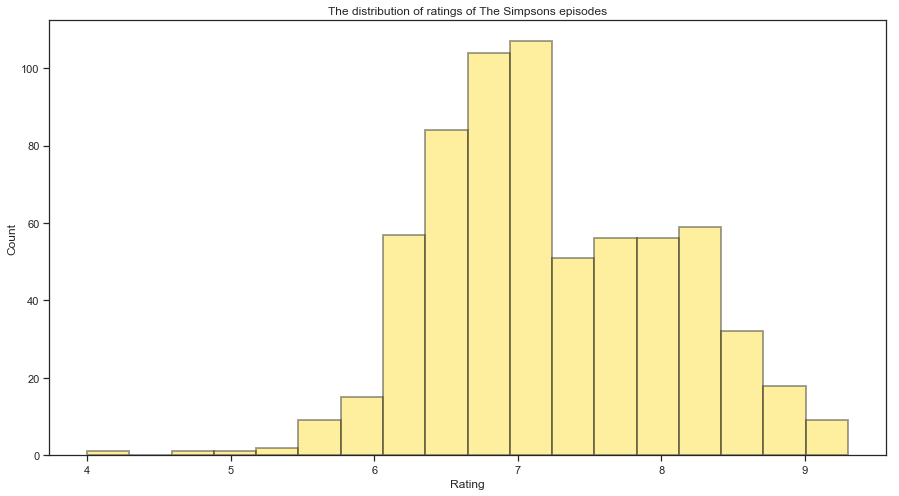

In [47]:
plt.figure(figsize=(15,8))

sns.distplot(df_episodes_ratings['IMDB rating'], kde=False, hist_kws=dict(edgecolor="k", linewidth=2), color='#FED90F')
plt.title("The distribution of ratings of The Simpsons episodes")
plt.xlabel('Rating')
plt.ylabel('Count')
plt.show()

The most common ratings are between 6 and 8, with a few episodes going above 8 and even fewer going below 6. The distribution is almost normally distributed, but it seems to be a little skewed to the left. 

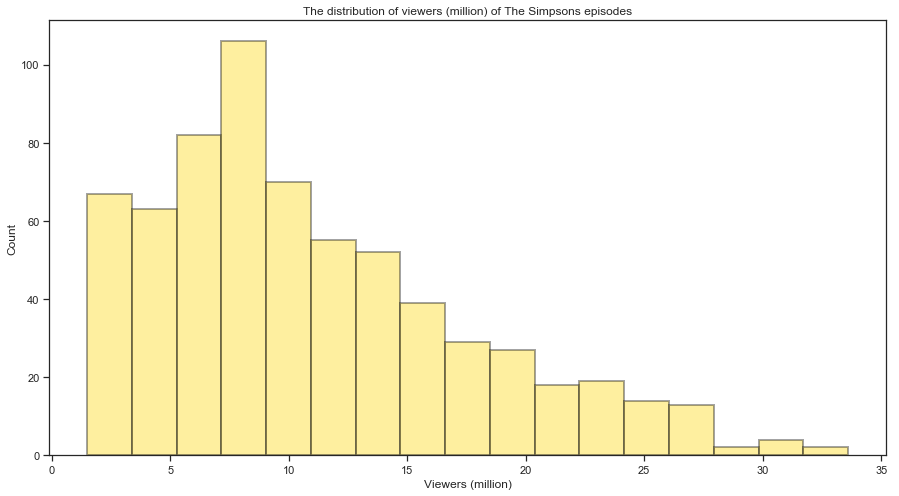

In [48]:
plt.figure(figsize=(15,8))

sns.distplot(df_episodes_ratings['viewers (millions)'], kde=False, hist_kws=dict(edgecolor="k", linewidth=2), color='#FED90F')
plt.title("The distribution of viewers (million) of The Simpsons episodes")
plt.xlabel('Viewers (million)')
plt.ylabel('Count')
plt.show()

This distribution is skewed to the left, with the most common viewer amount being between 5 and 10 millions viewers. 

### 2.1.3 Scripts of Episodes <a class="anchor" id="two.one.three"></a>

The scripts for each episode were only available up to season 28. For this, an alternative dataset was downloaded and fitted to the data that we have. 

In [35]:
df_script = pd.read_csv('the-simpsons-by-the-data-QueryResult.csv', low_memory = False)
df_script_episodes = pd.read_csv('the-simpsons-by-the-data-QueryResult_episodes.csv')
df_script_episodes.columns = ['episode_id','episode_name']

A little name-cleaning is needed for the episode id dataframe.

In [36]:
df_script_episodes[df_script_episodes['episode_name'].str[-1] == ']']

,episode_id,episode_name
323,598,"Friends and Family""[203]"
324,599,"The Town""[205]"
325,600,"Treehouse of Horror XXVII""[207]"


In [37]:
df_script_episodes.at[323,'episode_name'] = 'Friends and Family'
df_script_episodes.at[324,'episode_name'] = 'The Town'
df_script_episodes.at[325,'episode_name'] = 'Treehouse of Horror XXVII'

In [38]:
df_script['episode_id'].nunique() == df_script['episode_id'].nunique()

True

Attaching relevant attributes to the `df_script` DataFrame in order to accrue more information:

In [39]:
df_episode_attributes = df_episodes_ratings[['episode_name','no_overall','season','no_in_season']]

In [40]:
df_script = pd.merge(df_script,df_script_episodes,on='episode_id',how='left')

In [41]:
df_script.sort_values('episode_id').head(3)

,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name
148909,1,146,Homer Simpson: (GRABBING IT) Gimme that!,true,Homer Simpson,Circus of Values,Gimme that!,gimme that,Simpsons Roasting on an Open Fire
149011,1,247,Clerk: Less costume purchase --,true,Clerk,PERSONNEL OFFICE,Less costume purchase --,less costume purchase --,Simpsons Roasting on an Open Fire
149010,1,246,Homer Simpson: Santa?,true,Homer Simpson,PERSONNEL OFFICE,Santa?,santa,Simpsons Roasting on an Open Fire


In [42]:
df_script = pd.merge(df_script,df_episode_attributes,on='episode_name',how='left')

Here, some NaN values appear because the names of the episodes seem to slightly differ between datasets.

In [43]:
df_script[df_script['season'].isna()]['episode_name'].unique()

array(['Alone Again, Natura-diddily', 'Bye, Bye, Nerdie',
       "I'm Spelling As Fast As I Can", 'A Star Is Born-Again',
       "Thank God It's Doomsday", 'Million-Dollar Abie',
       "Dial 'N' for Nerder", "Ned 'n Edna's Blend",
       'Love is a Many-Splintered Thing'], dtype=object)

In [44]:
"I'm Spelling As Fast As I Can" == "I'm Spelling as Fast as I Can"

False

Seen below are the episodes that differ in naming conventions, and how they are corrected:

In [45]:
df_episodes_ratings[(df_episodes_ratings['episode_name'].str.contains('Nerder')) | 
                    (df_episodes_ratings['episode_name'].str.contains('Natura-')) |
                    (df_episodes_ratings['episode_name'].str.contains('Nerdie')) |
                    (df_episodes_ratings['episode_name'].str.contains('Star Is Born')) |
                    (df_episodes_ratings['episode_name'].str.contains('Dollar Abie')) |
                    (df_episodes_ratings['episode_name'].str.contains('Blend')) |
                    (df_episodes_ratings['episode_name'].str.contains('Splintered')) |
                    (df_episodes_ratings['episode_name'].str.contains('Spelling'))]                    

,no_overall,season,no_in_season,episode_name,viewers (millions),IMDB rating,year,month,day
239,240,11,14,"Alone Again, Natura-Diddily",10.80,7.7,2000,02,13
263,264,12,16,Bye Bye Nerdie,16.10,6.6,2001,03,11
302,303,14,12,I'm Spelling as Fast as I Can,22.10,7.2,2003,02,16
303,304,14,13,A Star Is Born Again,14.40,6.9,2003,03,02
371,372,17,16,Million Dollar Abie,7.83,6.3,2006,04,02
413,414,19,14,"Dial ""N"" for Nerder",7.30,7.3,2008,03,09
506,507,23,21,Ned 'n' Edna's Blend Agenda,4.07,6.5,2012,05,13
519,520,24,12,Love Is a Many-Splintered Thing,4.19,6.2,2013,02,10


In [46]:
correct_names = [name for name in df_episodes_ratings[(df_episodes_ratings['episode_name'].str.contains('Nerder')) | 
                    (df_episodes_ratings['episode_name'].str.contains('Natura-')) |
                    (df_episodes_ratings['episode_name'].str.contains('Nerdie')) |
                    (df_episodes_ratings['episode_name'].str.contains('Star Is Born')) |
                    (df_episodes_ratings['episode_name'].str.contains('Dollar Abie')) |
                    (df_episodes_ratings['episode_name'].str.contains('Blend')) |
                    (df_episodes_ratings['episode_name'].str.contains('Splintered')) |
                    (df_episodes_ratings['episode_name'].str.contains('Spelling'))]['episode_name']]

In [47]:
correct_names

['Alone Again, Natura-Diddily',
 'Bye Bye Nerdie',
 "I'm Spelling as Fast as I Can",
 'A Star Is Born Again',
 'Million Dollar Abie',
 'Dial "N" for Nerder',
 "Ned 'n' Edna's Blend Agenda",
 'Love Is a Many-Splintered Thing']

In [48]:
incorrect_names = [name for name in df_script[df_script['season'].isna()]['episode_name'].unique()]

Further cleaning is necessary as the names of identical episodes in the two dataframes do not seem to be identical. 

In [49]:
incorrect_names

['Alone Again, Natura-diddily',
 'Bye, Bye, Nerdie',
 "I'm Spelling As Fast As I Can",
 'A Star Is Born-Again',
 "Thank God It's Doomsday",
 'Million-Dollar Abie',
 "Dial 'N' for Nerder",
 "Ned 'n Edna's Blend",
 'Love is a Many-Splintered Thing']

In [50]:
df_incorrect_names = df_script_episodes[df_script_episodes['episode_name'].isin(incorrect_names)].sort_values('episode_id')
df_incorrect_names_indices = [index for index in df_incorrect_names.reset_index()['index']]

In [51]:
for i,name in enumerate(correct_names):
    df_script_episodes.at[df_incorrect_names_indices[i], 'episode_name'] = correct_names[i]

Now, the merge is carried out again to get rid of the NaN values: 

In [52]:
df_script.drop(['season','no_overall','no_in_season','episode_name'],axis=1,inplace=True)
df_script = pd.merge(df_script,df_script_episodes,on='episode_id',how='left')
df_script = pd.merge(df_script,df_episode_attributes,on='episode_name',how='left')

In [53]:
df_script[df_script['season'].isnull()]

,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name,no_overall,season,no_in_season
135022,520,11,Male Gps: ...so you will obey.,true,Male Gps,NEUTRAL LOCATION,...so you will obey.,so you will obey,Love is a Many-Splintered Thing,NaN,NaN,NaN
135066,520,0,(NEUTRAL LOCATION: INt. neutral location - DAY),false,NaN,NEUTRAL LOCATION,NaN,NaN,Love is a Many-Splintered Thing,NaN,NaN,NaN
135067,520,3,"Gps: In three-tenths of a mile, make a right t...",true,Gps,NEUTRAL LOCATION,"In three-tenths of a mile, make a right turn.",in three-tenths of a mile make a right turn,Love is a Many-Splintered Thing,NaN,NaN,NaN
135068,520,4,"Marge Simpson: Homer, listen to the G.P.S.",true,Marge Simpson,NEUTRAL LOCATION,"Homer, listen to the G.P.S.",homer listen to the gps,Love is a Many-Splintered Thing,NaN,NaN,NaN
135069,520,5,Marge Simpson: (INSTRUCTIONS/BACKSEAT DRIVING ...,true,Marge Simpson,NEUTRAL LOCATION,"Turn right onto First Street, head east. Homer...",turn right onto first street head east homer w...,Love is a Many-Splintered Thing,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
148430,520,138,Adult Bart: (SAD NOISE),false,Adult Bart,COMMUNITY CENTER,NaN,NaN,Love is a Many-Splintered Thing,NaN,NaN,NaN
148431,520,244,Adult Bart: And that's when I learned Cupid wa...,true,Adult Bart,LIMBO BACKGROUND,And that's when I learned Cupid was just a fat...,and thats when i learned cupid was just a fat ...,Love is a Many-Splintered Thing,NaN,NaN,NaN
148432,520,246,Adult Bart: Love? What is it? What does it mea...,true,Adult Bart,LIMBO BACKGROUND,Love? What is it? What does it mean? How do yo...,love what is it what does it mean how do you s...,Love is a Many-Splintered Thing,NaN,NaN,NaN
148433,520,248,Adult Bart: (SAD SIGH) Married?,true,Adult Bart,LIMBO BACKGROUND,Married?,married,Love is a Many-Splintered Thing,NaN,NaN,NaN


In [54]:
df_script.head(2)

,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name,no_overall,season,no_in_season
0,32,209,"Miss Hoover: No, actually, it was a little of ...",true,Miss Hoover,Springfield Elementary School,"No, actually, it was a little of both. Sometim...",no actually it was a little of both sometimes ...,Lisa's Substitute,32.0,2.0,19.0
1,32,210,Lisa Simpson: (NEAR TEARS) Where's Mr. Bergstrom?,true,Lisa Simpson,Springfield Elementary School,Where's Mr. Bergstrom?,wheres mr bergstrom,Lisa's Substitute,32.0,2.0,19.0


### 2.1.4 Wikipedia (Simpsons.fandom) Pages of Each Episode <a class="anchor" id="two.one.four"></a>

In order to scour through each episode's synopsis, scraping a Wiki fan-page of the series is necessary.

In [55]:
wiki_url = 'https://simpsons.fandom.com/wiki/List_of_Episodes'

In [56]:
links_array = []
res = requests.get(wiki_url).text
soup = BeautifulSoup(res,'html')
no_overall = 1
for table in soup.find_all('table', class_='wikitable')[1:31]: #Skip the overview table and only take the first 30 seasons
    for row in table.find_all('tr'):
            links = row.find_all('a')
            for link in links:
                if(link['href'].split('/wiki/')[1] != 'The_Simpsons_Movie'):
                    links_array.append([no_overall,link['href'].split('/wiki/')[1]])
                    no_overall = no_overall + 1

In [57]:
df_episode_wiki = pd.DataFrame(links_array)
df_episode_wiki.columns = ['no_overall','wiki_link']

Again, the episode 'The Great Phatsby' (episode 608/609), is causing problems. It can be solved as it was before:

In [58]:
phatsby_insert = pd.DataFrame({'no_overall':609, 'wiki_link':'The_Great_Phatsby'},index=[608])
phatsby_insert
df_episode_wiki = pd.concat([df_episode_wiki.iloc[:608], phatsby_insert, df_episode_wiki[608:]])
df_episode_wiki.reset_index(inplace=True, drop=True)
df_episode_wiki_no_correction = df_episode_wiki.iloc[609:]
df_episode_wiki_no_correction['no_overall'] = df_episode_wiki_no_correction['no_overall'].apply(lambda x: x+1)
df_episde_wiki = pd.concat([df_episode_wiki.iloc[:608], df_episode_wiki_no_correction])

In [59]:
df_episodes_ratings = pd.merge(df_episodes_ratings,df_episode_wiki)

### 2.1.5 Creating text files of Synopsis <a class="anchor" id="two.one.five"></a>

Here, each synopsis is fetched and saved as a text file in order to analyze them later. 

In [60]:
if not os.path.exists('synopsis'):
        os.mkdir('synopsis')

synopsis = []

for season in df_episodes_ratings['season'].unique():
    if not os.path.exists('synopsis/'+'season'+str(season)):
        os.mkdir('synopsis/'+'season'+str(season))

save_path = os.getcwd()+'/synopsis/'
for episode in df_episodes_ratings['wiki_link']:
    res = requests.get("https://simpsons.fandom.com/wiki/{}".format(episode)).text
    ep_number = df_episodes_ratings[df_episodes_ratings['wiki_link']==episode]['no_overall'].values[0]
    season = int(df_episodes_ratings[df_episodes_ratings['wiki_link']==episode]['season'].values[0])
    soup = BeautifulSoup(res,'html')
    if(episode == 'The_Old_Man_and_the_Key'): # An edge case
        syn=str(soup.find_all('p')[1])
    elif(soup.find('span', {'id':'Synopsis'})):
        firstp = soup.find('span', {'id':'Synopsis'}).parent.findNext('p')
        syn = str(firstp)
        while(firstp.nextSibling.name=='p'):
            syn = str(syn) + ' ' + str(firstp.nextSibling)
            firstp = firstp.nextSibling
    elif(soup.find('span', {'id':'Synopsis.'})):
        syn = str(soup.find('span', {'id':'Synopsis.'}).parent.findNext('p'))
    elif(soup.find('span', {'id':'Summary'})):
        syn = str(soup.find('span', {'id':'Summary'}).parent.findNext('p'))
    complete_name = os.path.join(os.path.expanduser('~'),save_path+'season'+str(season)+'/',str(ep_number)+'.txt')
    with io.open(complete_name, "w", encoding="utf-8") as f: 
        f.write(str(syn))
        f.close()

It is then necessary to copy episode 608 and create episode 609, as these two episodes are the same episode - often referred to as episode "608609". 

In [61]:
save_path = os.getcwd()+'/synopsis/season28/'
path = save_path+"608.txt"
text = io.open(path,'r',encoding='utf-8').read()
with io.open(save_path+'609.txt', "w", encoding="utf-8") as f: 
    f.write(str(text))
    f.close()

One important addition to the `df_episode_ratings` dataframe is registering the main characters for each episode. This can be found on the episodes wikipedia page. 

In [62]:
df_main_characters = []

for wiki_link in df_episodes_ratings['wiki_link']:
    res = requests.get("https://simpsons.fandom.com/wiki/{}".format(wiki_link)).text
    ep_number = df_episodes_ratings[df_episodes_ratings['wiki_link']==wiki_link]['no_overall'].values[0]
    soup = BeautifulSoup(res,'html')
    for elem in soup(text=re.compile(r'Main character\(s\)')):
        main_chars_html = elem.parent.findNext('div')
        main_chars = re.findall(r'href=\"\/wiki\/(.*?)\"',str(main_chars_html))
        df_main_characters.append([ep_number, main_chars])
        

In [63]:
df_main_characters = pd.DataFrame(df_main_characters,columns=['no_overall','main_characters'])

In [64]:
df_episodes_ratings = pd.merge(df_episodes_ratings, df_main_characters,how='left')

In [65]:
df_episodes_ratings['main_characters'] = df_episodes_ratings['main_characters'].fillna('')

### 2.1.6 Characters <a class="anchor" id="two.one.six"></a>

Now, a list of characters is needed in order to create the actual nodes of the networks. Mining Simpsons Fandom Wiki page for this data proved useful. Getting the actual wiki link of the characters is more useful than getting the name because this insures consistency in the naming of characters. However, we also store the full name of each character.

In [66]:
char_url = 'https://simpsons.fandom.com/wiki/Portal:All_Simpson_Characters'
res = requests.get(char_url).text
soup = BeautifulSoup(res,'html')
characters = []
for item in soup.find_all('div', class_='wikia-gallery-item'):
    wiki_link_container = item.find('div', class_='lightbox-caption')
    if(wiki_link_container.find('a',href=True)):
        wiki_link = wiki_link_container.find('a',href=True)['href']
        characters.append([item.text,wiki_link.replace('/wiki/','')])

In [67]:
df_char = pd.DataFrame(characters)
df_char.columns = ['name', 'char_wiki_link']

In [68]:
df_char['extra_wiki_link'] = df_char['char_wiki_link'].apply(lambda x: x.split('_')[0])

In [69]:
df_char.drop_duplicates(inplace=True)

One thing that must be noted is that some characters will not be referred to by their first name or even last name. For example, Abraham Simpson II will more often than not be referred to as *Grampa* or *Abe*. The same can be said about Charles Montgomery Burns will most likely be referred to as *Mr. Burns* or *Burns*. 

The character of Robert Terwilliger will most likely be referred to as *Sideshow Bob*. 

In [70]:
df_char.at[5,'name'] = 'Abe'
df_char.at[7,'name'] = 'Mr. Burns'

df_char.at[df_char.index[df_char['name'] == 'Robert Terwilliger'].tolist(), 'name'] = 'Sideshow Bob'

A total of 718 characters are listed on the original page, but there are some duplicates. Some cleaning of this dataset has to be done. 

In [71]:
len(df_char)

719

In [72]:
df_char.reset_index(inplace=True, drop=True)

### 2.1.7 Cleaning of Character Names <a class="anchor" id="two.one.seven"></a>

In [73]:
first_names = df_char['name'].apply(lambda x: x.split())

In [74]:
fnames = []
for i,names in enumerate(first_names):
    rid = False
    for name in names:
        if('\'s' in name or 's\'' in name):
            rid = True
            break
        elif('the' in name):
            rid = False
        elif(name[0].islower()):
            if(name != 'bin' and name != 'von'):
                rid = True
                break
        elif(name.isdigit()):
            rid = True
            break
    if(rid):
        fname = ''
        for name in names:
            fname = fname + ' ' + name
        fnames.append(fname[1:])

In [75]:
df_char = df_char[~df_char['name'].isin(fnames)]

In [76]:
df_char['name'] = df_char['name'].apply(lambda x: x.replace("\"",""))

In [77]:
df_char.reset_index(inplace=True, drop=True)

In [78]:
# Characters that are irrelevant

rid_of_chars = [18, 120, 138, 255, 254, 253, 260, 276, 281, 287, 288, 295, 315, 482, 487,
                498, 501, 502, 504, 505, 517, 526, 529, 533, 542,543, 547, 557, 559, 561, 562, 
                599, 600, 601, 602, 603, 605, 606, 610, 611, 612, 613, 614, 615, 616, 617, 618, 
                619, 620, 621, 622, 607, 608, 579, 524, 604, 320, 593]

In [79]:
df_char.drop(rid_of_chars,inplace=True)

In [80]:
df_char.reset_index(inplace=True, drop=True)

There are now 566 **distinct** characters that appear in The Simpsons, which are believed to be somewhat relevant to the analysis that is carried on below. 

In [81]:
len(df_char)

566

### 2.1.8 Demographic Ratings <a class="anchor" id="two.one.eight"></a>

In order to see if age and gender has anything to do with the series' ratings, or if some demographic group is actually causing the ratings to go down, the relevant ratings for different demographics and genders will need to be collected. 

This is done by extracting each episodes' *"rating site"* from IMDB. 

**Get each episode's IMDB page**

In [82]:
imdb_ratings_url = 'https://www.imdb.com/list/ls052175596/?st_dt=&mode=simple&page={}&ref_=ttls_vw_smp&sort=release_date,asc'
pages = range(1,8)
links = []
for page in pages:
    url = imdb_ratings_url.format(page)
    res = requests.get(url).text
    soup = BeautifulSoup(res,'html')
    container = soup.find('div',class_='lister')

    for item in container.find_all('div', class_='lister-item'):
        as_ = item.find('span',class_='lister-item-header').find_all('a',href=True)
        for a in as_:
            if(a['href']!='/title/tt0096697/'): # The link to The Simpsons page
                links.append([a.text, a['href']])
                
df_imdb_links = pd.DataFrame(links)
df_imdb_links.columns = ['episode_name','IMDB link']

In [83]:
df_imdb_links = df_imdb_links[:661]

In [84]:
df_imdb_links = pd.merge(df_imdb_links, df_episodes_ratings[['episode_name','IMDB rating']], how = 'left')

The same "name-fix" is applied as before.

In [85]:
missing = df_imdb_links[df_imdb_links['IMDB rating'].isna()].reset_index()
missing_episodes = missing['index']

missing_ratings = []

for episode in missing_episodes:
    missing_ratings.append([episode,df_episodes.iloc[episode]['episode_name'],df_ratings.iloc[episode]['IMDB rating']])
for episode in missing_ratings: 
    index = episode[0]
    rating = episode[2]
    df_imdb_links.at[index, 'IMDB rating'] = rating

In [86]:
df_imdb_links.columns = ['episode_name','IMDB link','overall Rating']

Now it is necessary to find the link to each episode's ratings site

In [87]:
imdb_url = "https://www.imdb.com{}"

rating_sites = []
for link in df_imdb_links['IMDB link'].unique():
    episode_name = df_imdb_links[df_imdb_links['IMDB link'] == link]['episode_name'].values[0]
    url = imdb_url.format(link)
    res = requests.get(url).text
    soup = BeautifulSoup(res,'html')
    rating_wrapper = soup.find('div',class_='ratings_wrapper')
    rating_link = rating_wrapper.find('a',href=True)
    rating_sites.append([episode_name,rating_link.text, rating_link['href']])
    
df_imdb_rating_sites = pd.DataFrame(rating_sites,columns=['episode_name','rating counts','rating_link'])

In [88]:
df_imdb = pd.merge(df_imdb_links, df_imdb_rating_sites, how='left')

Now, scraping of the ratings by demograpic is possible. 

In [89]:
imdb_url = "https://www.imdb.com{}"
demographics = ['All Ages','<18','18-29','30-44','45+']
genders = ['All','Males','Females']
all_ratings = []
for link in df_imdb['rating_link'].unique():
    episode_name = df_imdb[df_imdb['rating_link'] == link]['episode_name'].values[0]
    url = imdb_url.format(link)
    res = requests.get(url).text
    soup = BeautifulSoup(res,'html')
    first_heading = soup.find('div', class_='tableHeadings', text='All Ages')
    table = first_heading.find_parent('table')
    
    amounts = []
    ratings = []
    for td in table.findAll('td',class_='ratingTable')[5:]:
        if(td.find('div',class_='bigcell').text!='-'):
            ratings.append(float(td.find('div',class_='bigcell').text))
        else:
            ratings.append(td.find('div',class_='bigcell').text)
        if(td.find('div',class_='smallcell')):
            amounts.append(int(td.find('div',class_='smallcell').text.strip().replace(',','')))
        else:
            amounts.append(0)
    
    all_ratings.append([episode_name,*ratings,*amounts])


In [90]:
df_all_ratings = pd.DataFrame(all_ratings, columns = ['episode_name',
                                                      'males_all','males_below_18','males_18_29',
                                                      'males_30_44','males_45_plus',
                                                      'females_all','females_below_18','females_18_29',
                                                      'females_30_44','females_45_plus',
                                                     'males_all_amount','males_below_18_amount','males_18_29_amount',
                                                      'males_30_44_amount','males_45_plus_amount',
                                                      'females_all_amount','females_below_18_amount','females_18_29_amount',
                                                      'females_30_44_amount','females_45_plus_amount'])

In [91]:
df_all_ratings = pd.merge(df_all_ratings, df_episodes_ratings[['episode_name','season']],how='left')

In [92]:
missing = df_all_ratings[df_all_ratings['season'].isna()].reset_index()
missing_episodes = missing['index']

missing_seasons = []

for episode in missing_episodes:
    missing_seasons.append([episode,df_episodes.iloc[episode]['episode_name'],df_episodes.iloc[episode]['season']])
for episode in missing_seasons: 
    index = episode[0]
    season = episode[2]
    df_all_ratings.at[index, 'season'] = season

In [93]:
df_all_ratings['season'] = df_all_ratings['season'].apply(lambda x: int(x))
df_all_ratings.reset_index(inplace=True)
df_all_ratings.columns = df_all_ratings.columns[1:].insert(0,'no_overall')
df_all_ratings['no_overall'] = df_all_ratings['no_overall'].apply(lambda x: int(x)+1)

If there is no rating given for a specific demographic, this rating is set to the overall (all) rating given by the other demographics within that gender.

In [94]:
demography_columns = [col for col in df_all_ratings.columns[2:len(df_all_ratings.columns)-1]]

In [95]:
df_all_ratings[df_all_ratings[demography_columns]=='-'].any()

no_overall                 False
episode_name               False
males_all                  False
males_below_18             False
males_18_29                False
males_30_44                False
males_45_plus              False
females_all                False
females_below_18            True
females_18_29              False
females_30_44              False
females_45_plus             True
males_all_amount           False
males_below_18_amount      False
males_18_29_amount         False
males_30_44_amount         False
males_45_plus_amount       False
females_all_amount         False
females_below_18_amount    False
females_18_29_amount       False
females_30_44_amount       False
females_45_plus_amount     False
season                     False
dtype: bool

There are only missing ratings for some females between 18 and 29, and females above 45. There is only one episode that is missing ratings from both these demographics, **episode 656**, and that is the only episode missing a rating from females above 45.

As for the column `females_below_18`, there are so many missing values that this column will be dropped. 

In [96]:
len(df_all_ratings[df_all_ratings['females_below_18']=='-'])

589

In [97]:
df_all_ratings.drop('females_below_18',axis=1,inplace=True)

In [98]:
df_all_ratings[df_all_ratings['females_45_plus']=='-']

,no_overall,episode_name,males_all,males_below_18,males_18_29,males_30_44,males_45_plus,females_all,females_18_29,females_30_44,...,males_below_18_amount,males_18_29_amount,males_30_44_amount,males_45_plus_amount,females_all_amount,females_below_18_amount,females_18_29_amount,females_30_44_amount,females_45_plus_amount,season
655,656,E My Sports,6.2,4.0,6.8,5.9,6.1,6.1,6.3,5.5,...,2,64,113,42,22,0,8,11,0,30


In [99]:
df_all_ratings.at[655,'females_45_plus'] = df_all_ratings.iloc[655]['females_all']

In [100]:
demography_columns.remove('females_below_18')

In [101]:
for col in demography_columns:
    df_all_ratings[col] = df_all_ratings[col].apply(lambda x: float(x))

In [102]:
df_all_ratings['no_overall'] = df_all_ratings['no_overall'].apply(lambda x: int(x))

The distribution of ratings across the demographics can now be visualized: 

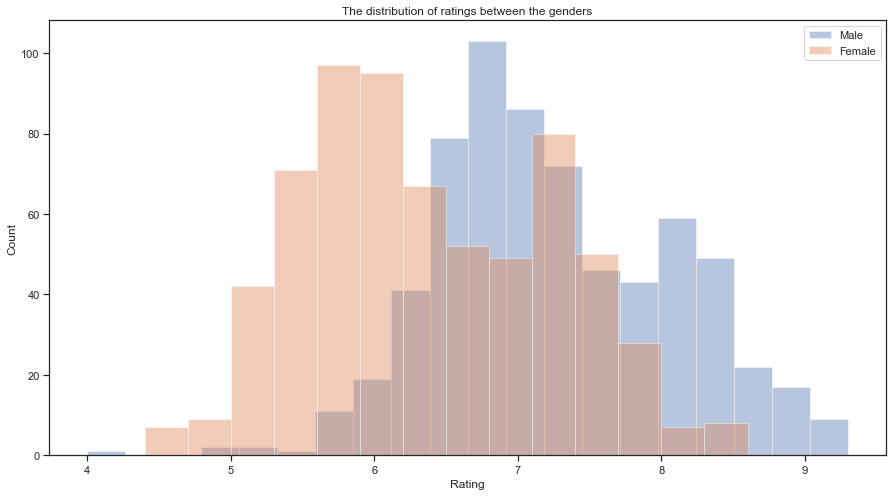

In [103]:
plt.figure(figsize=(15,8))
sns.distplot(df_all_ratings['males_all'], kde=False)
sns.distplot(df_all_ratings['females_all'], kde=False)
plt.ylabel('Count')
plt.xlabel('Rating')
plt.title("The distribution of ratings between the genders")
plt.legend(labels=['Male','Female'])
plt.show()

It seems that females in general have a lesser opinion on the series throughout these 30 years, as the male distribution is more dense around 6.5 - 7.5, where as the female rating's distribution is most dense around 6.0. 

## 2.2 Visualizing the Downfall of The Simpsons <a class="anchor" id="two.two"></a>

The data that has been pertained holds information about the change in both the amount of viewers per episode and the rating that episode got. The change over the years can now be visualized in order to see if the series has actually been declining over the years, and when that happened. 

**Plot the ratings of each episode.**

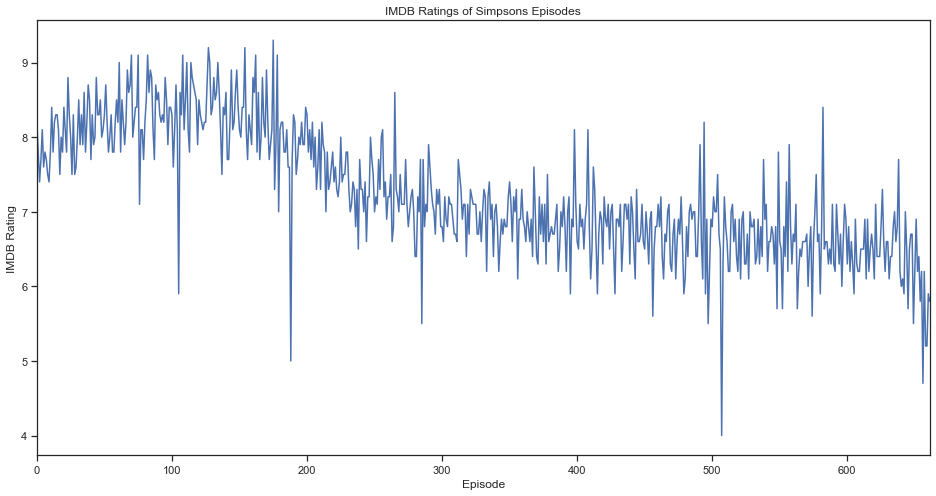

In [104]:
df_episodes_ratings.plot(y='IMDB rating',figsize=(16,8),legend=None)
plt.xlabel('Episode')
plt.ylabel('IMDB Rating')
plt.title("IMDB Ratings of Simpsons Episodes")
plt.show()

Here it can be seen that the rating per episode has steadily been declining over the years. However, there exist a lot of fluctuations within each season, i.e. one season might have an episode that is really good (rating vise) and also an episode that is really bad. Looking at the average rating per season should shed light on each season as a whole. 

**Plot the average rating of a season.**

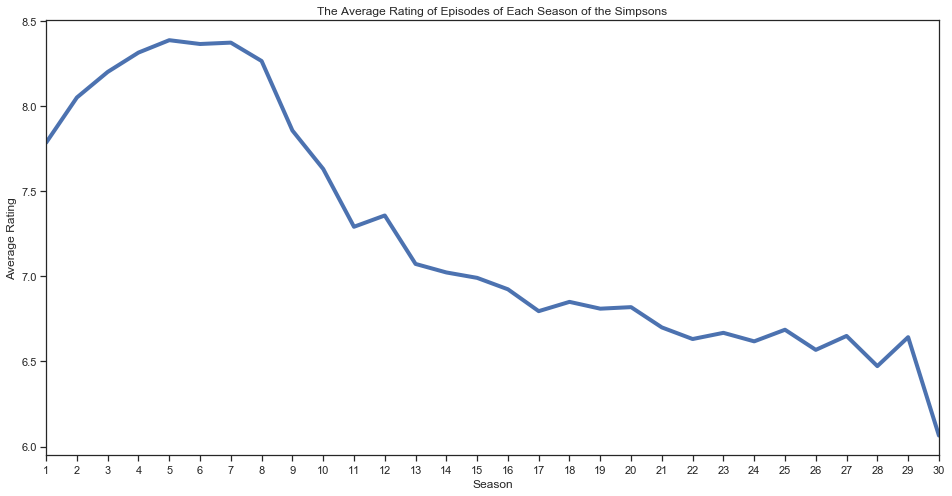

In [105]:
df_episodes_ratings.groupby('season').mean()['IMDB rating'].reset_index().plot(x='season',y='IMDB rating',legend=False,figsize=(16,8), lw=4)
plt.title("The Average Rating of Episodes of Each Season of the Simpsons")
plt.xticks(range(1,31))
plt.ylabel('Average Rating')
plt.xlabel('Season')
plt.show()

This depcits the decline of the series over the years really well. Around season 8, the average rating per season takes a really big hit and a steep decline in ratings is introduced that keeps going down on average until present day. 

People obviously started disliking the series more and more over the years, but have they continued watching? 

**Plot the average number of viewers per season.**

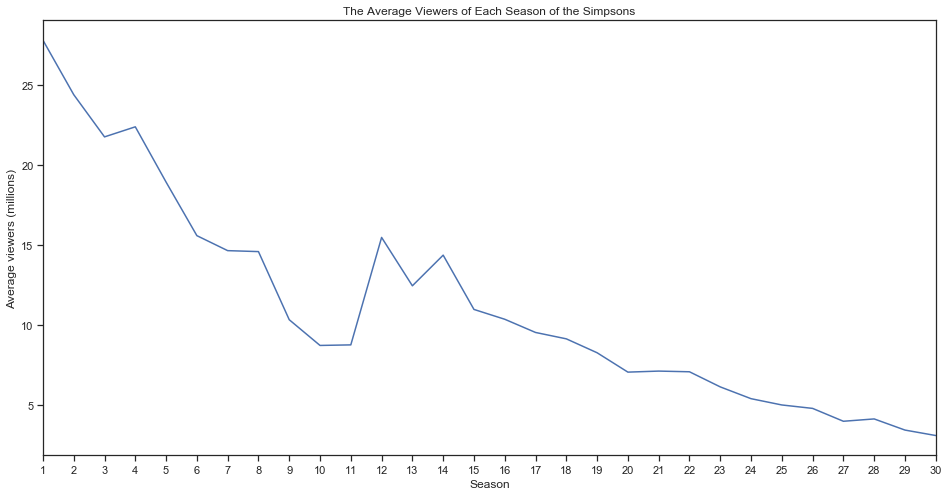

In [106]:
df_episodes_ratings.groupby('season').mean()['viewers (millions)'].reset_index().plot(x='season',y='viewers (millions)',legend=False,figsize=(16,8))
plt.title("The Average Viewers of Each Season of the Simpsons")
plt.xticks(range(1,31))
plt.ylabel('Average viewers (millions)')
plt.xlabel('Season')
plt.show()

The average viewers (in millions) have really gone down over the years, having been around 20 million viewers per while season 2-6 were aired, but now well below 5 million viewers. 

From these graphs it can clearly be seen that the series have been declining over the years. 

### 2.2.1 Changes between Demographics <a class="anchor" id="two.two.one"></a>

**Do the genders view the series similarly? Lets plot the ratings for both genders.**

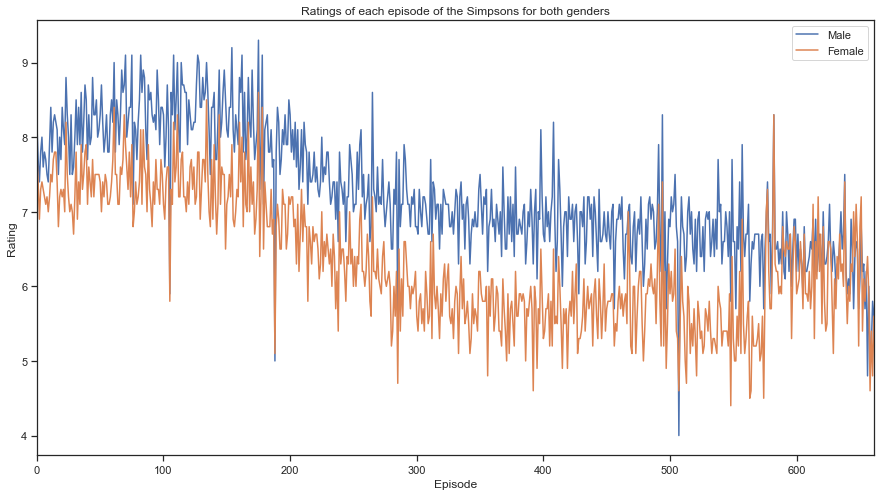

In [107]:
plt.figure(figsize=(15,8))

df_all_ratings['males_all'].plot()
df_all_ratings['females_all'].plot()

plt.title('Ratings of each episode of the Simpsons for both genders')
plt.ylabel('Rating')
plt.xlabel('Episode')
plt.legend(['Male','Female'])
plt.show()

It does seem that overall, men like the series more. However, as the series progress, the ratings collide and the difference in opinion by gender seems to diminish. This could potentially be seen better if the **average rating per season** is visualized. 

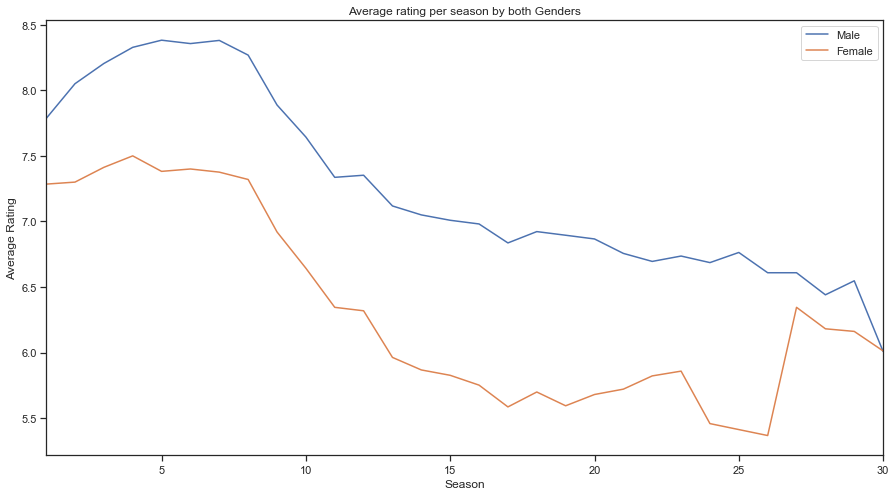

In [108]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['males_all'].plot()
df_all_ratings.groupby('season').mean()['females_all'].plot()

plt.title('Average rating per season by both Genders')
plt.ylabel('Average Rating')
plt.xlabel('Season')
plt.legend(['Male','Female'])
plt.show()

From this it can be deducted that both gender's opinion on the series has dwindled from the serie's conception, but it seems that in very recent years, female's opinion on the series has started to rise. 

Over the years, it seems that the show does appeal more to the male audience than the female audience. This seems to be changing.

**What about gender AND age?**

In [109]:
df_all_ratings.columns

Index(['no_overall', 'episode_name', 'males_all', 'males_below_18',
       'males_18_29', 'males_30_44', 'males_45_plus', 'females_all',
       'females_18_29', 'females_30_44', 'females_45_plus', 'males_all_amount',
       'males_below_18_amount', 'males_18_29_amount', 'males_30_44_amount',
       'males_45_plus_amount', 'females_all_amount', 'females_below_18_amount',
       'females_18_29_amount', 'females_30_44_amount',
       'females_45_plus_amount', 'season'],
      dtype='object')

**Plot how the ratings have developed, considering males in different age groups.**

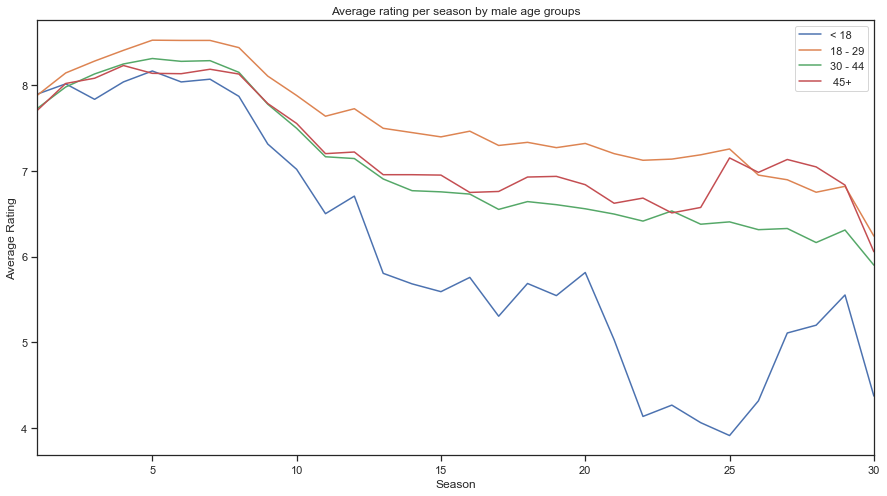

In [110]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['males_below_18'].plot()
df_all_ratings.groupby('season').mean()['males_18_29'].plot()
df_all_ratings.groupby('season').mean()['males_30_44'].plot()
df_all_ratings.groupby('season').mean()['males_45_plus'].plot()

plt.title('Average rating per season by male age groups')
plt.ylabel('Average Rating')
plt.xlabel('Season')
plt.legend(['< 18 ','18 - 29', '30 - 44',' 45+'])
plt.show()

It does seem that while the series has progressed, the younger audience's opinion has changed the most. This could mean that while The Simpsons did appeal a lot to the younger audience in the 90's, young people now a days do not seem to like the show that much. 

Other age groups' ratings have also been steadily going down, but not as drastically. 

**Plot how the ratings have devaloped, considering females in different age groups.**

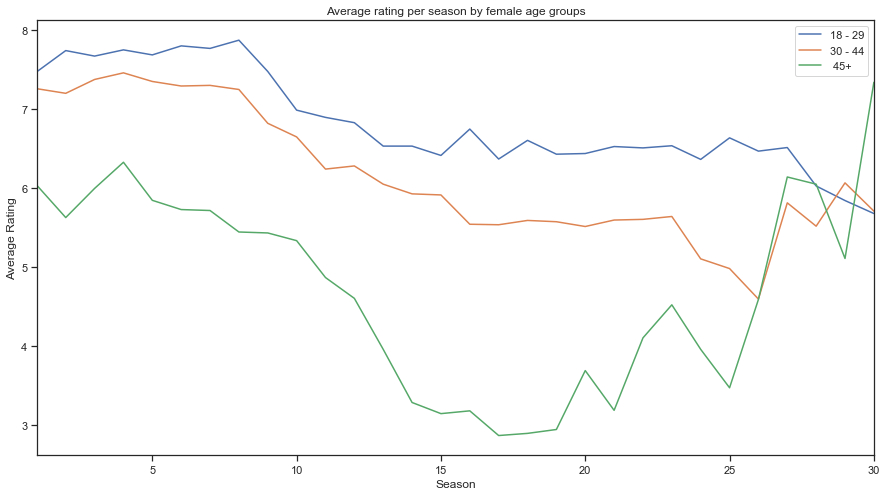

In [111]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['females_18_29'].plot()
df_all_ratings.groupby('season').mean()['females_30_44'].plot()
df_all_ratings.groupby('season').mean()['females_45_plus'].plot()

plt.title('Average rating per season by female age groups')
plt.ylabel('Average Rating')
plt.xlabel('Season')
plt.legend(['18 - 29', '30 - 44',' 45+'])
plt.show()

The series does seem to be appealing more and more to females aged 45 over the past recent years, while the other age groups for women have been steadily going down.

It seems that the series **has lost it's appeal to the younger male audience while gaining popularity from the older female audience**.

**But how many are actually voting within each demographic group?**

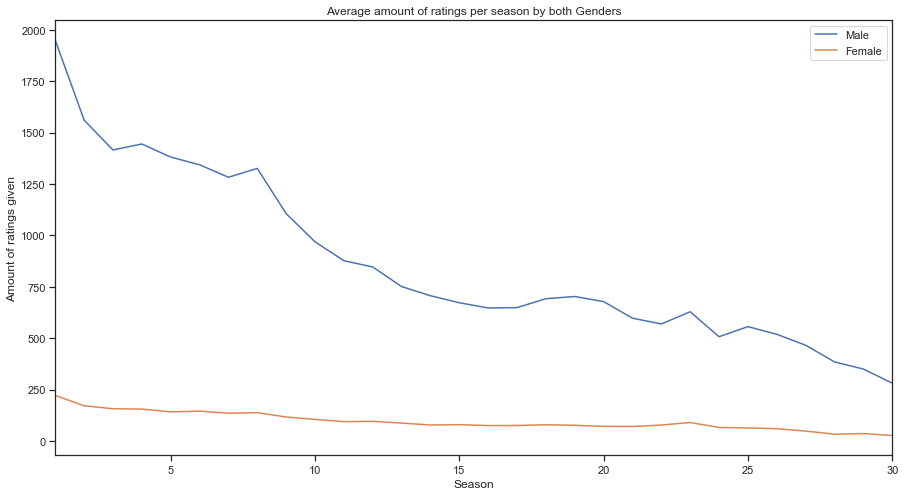

In [112]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['males_all_amount'].plot()
df_all_ratings.groupby('season').mean()['females_all_amount'].plot()

plt.title('Average amount of ratings per season by both Genders')
plt.ylabel('Amount of ratings given')
plt.xlabel('Season')
plt.legend(['Male','Female'])
plt.show()

Here it can be seen that females aren't given as many ratings as males, so the men are really responsible for the change in the series ratings, as they are the ones that are actually rating the show.

**Plot the number of ratings for females in different age groups.**

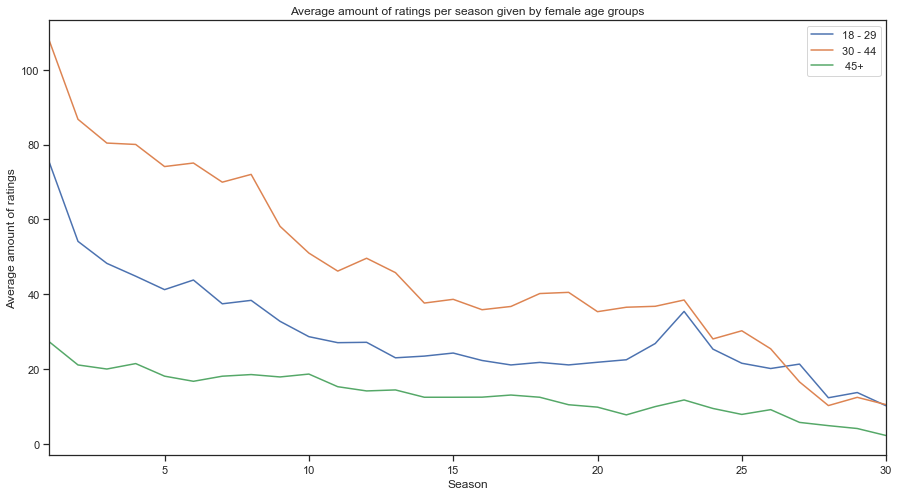

In [113]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['females_18_29_amount'].plot()
df_all_ratings.groupby('season').mean()['females_30_44_amount'].plot()
df_all_ratings.groupby('season').mean()['females_45_plus_amount'].plot()

plt.title('Average amount of ratings per season given by female age groups')
plt.ylabel('Average amount of ratings')
plt.xlabel('Season')
plt.legend(['18 - 29', '30 - 44',' 45+'])
plt.show()

**Plot the number of ratings for males in different age groups.**

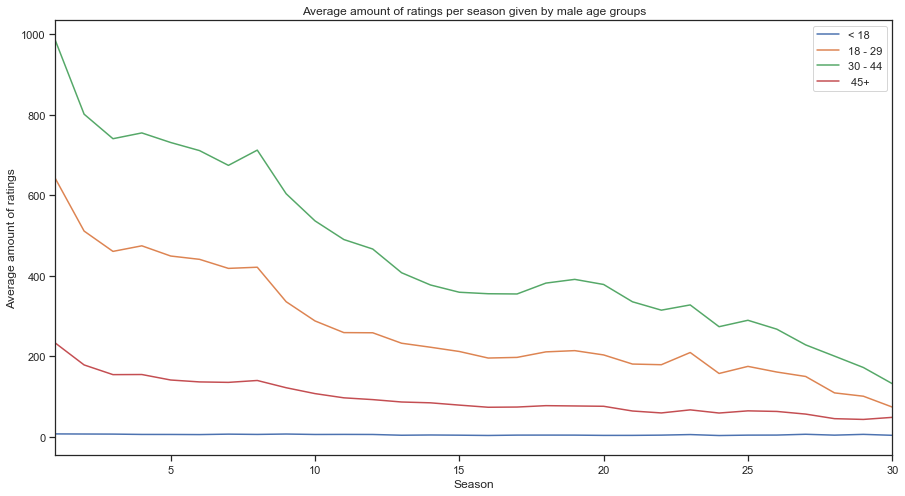

In [114]:
plt.figure(figsize=(15,8))

df_all_ratings.groupby('season').mean()['males_below_18_amount'].plot()
df_all_ratings.groupby('season').mean()['males_18_29_amount'].plot()
df_all_ratings.groupby('season').mean()['males_30_44_amount'].plot()
df_all_ratings.groupby('season').mean()['males_45_plus_amount'].plot()

plt.title('Average amount of ratings per season given by male age groups')
plt.ylabel('Average amount of ratings')
plt.xlabel('Season')
plt.legend(['< 18', '18 - 29', '30 - 44',' 45+'])
plt.show()

Here it can be seen that males between the age 30-44 give the most ratings, and after that, males between 18-29. However, this shouldn't be that surprising as most of the IMDB users are probably within that age group. This also applies for females.

The ratings for males under 18 are really few and thus we cannot draw any conclusions for the changes in ratings for this age group. The same can be said about the rating for women over 45, where the average rating seemed to growing fast for the past few seasons.

The difference in the amounts of votes over the years can be explained by the fact that there has been more time since season 1 aired, so obviously there will be more opportunity for people to rate the episodes in that season. 

**Distribution of Ratings**

In order to visualize how the rating patterns for the demographics have changed, the distribution of ratings for the first 15 seasons will be compared to the distribution of ratings for the last 15 seasons for the relevant demographics.

In [115]:
df_all_ratings_first_15 = df_all_ratings[df_all_ratings['season']<15]
df_all_ratings_last_15 = df_all_ratings[df_all_ratings['season']>=15]

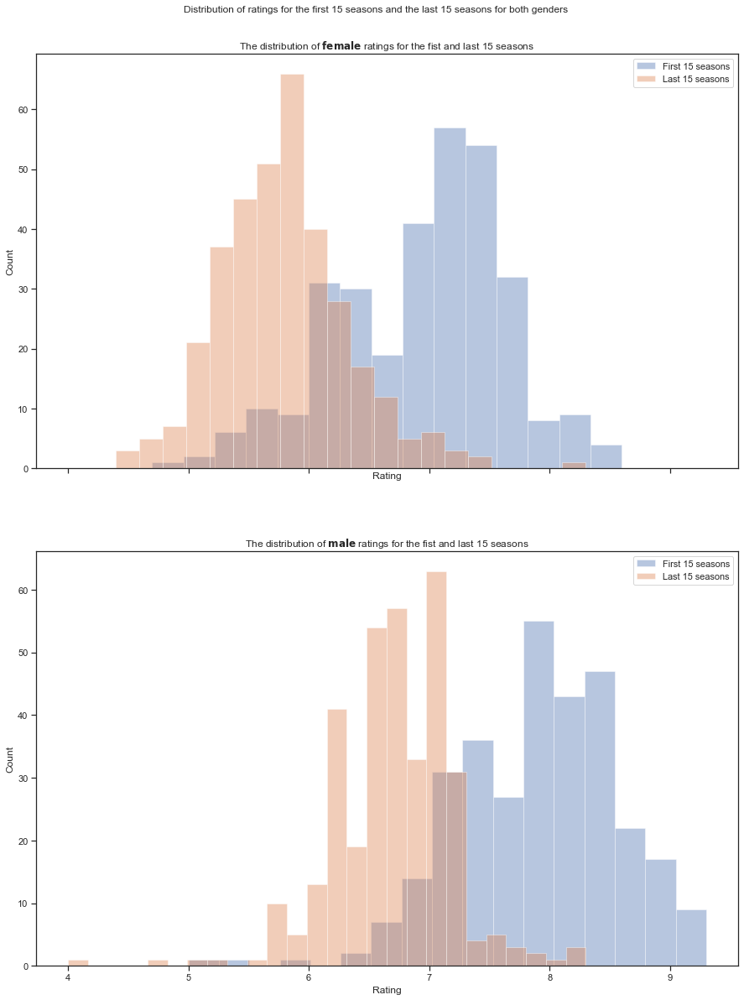

In [116]:
fig, (ax1, ax2) = plt.subplots(2, sharex=True, figsize=(15,20))

plt.suptitle('Distribution of ratings for the first 15 seasons and the last 15 seasons for both genders', y=0.92)

plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.20)

sns.distplot(df_all_ratings_first_15['females_all'], kde=False, ax=ax1)
sns.distplot(df_all_ratings_last_15['females_all'], kde=False, ax=ax1)

ax1.set_title("The distribution of "+ r"$\bf{female}$ ratings for the fist and last 15 seasons")
ax1.set_ylabel('Count')
ax1.set_xlabel('Rating')
ax1.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['males_all'], kde=False, ax=ax2)
sns.distplot(df_all_ratings_last_15['males_all'], kde=False, ax=ax2)

ax2.set_title("The distribution of "+ r"$\bf{male}$ ratings for the fist and last 15 seasons")
ax2.set_ylabel('Count')
ax2.set_xlabel('Rating')
ax2.legend(labels=['First 15 seasons','Last 15 seasons'])



plt.show()

Males and females do seem to rate the first 15 seasons higher, with some overlap. However, this is to be suspected as the last 15 seasons have a much lower average rating then the first 15 seasons. 

The ratings for males also seem to be more distributed, reaching both higher for the first 15 seasons and lower for the last 15 seasons, while females distribute their ratings lower for the first 15 seasons and a little bit higher for the last 15 seasons. 

**But are there significant changes within the age groups of these demographics?**

In [117]:
df_all_ratings.columns

Index(['no_overall', 'episode_name', 'males_all', 'males_below_18',
       'males_18_29', 'males_30_44', 'males_45_plus', 'females_all',
       'females_18_29', 'females_30_44', 'females_45_plus', 'males_all_amount',
       'males_below_18_amount', 'males_18_29_amount', 'males_30_44_amount',
       'males_45_plus_amount', 'females_all_amount', 'females_below_18_amount',
       'females_18_29_amount', 'females_30_44_amount',
       'females_45_plus_amount', 'season'],
      dtype='object')

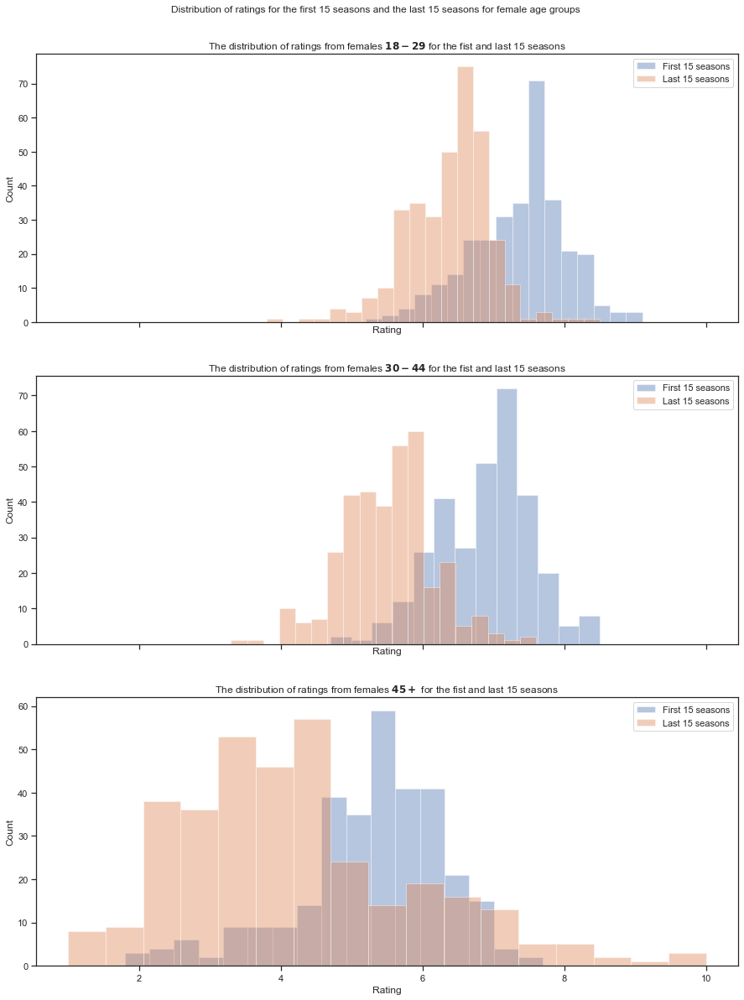

In [118]:
fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, figsize=(15,20))


plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.20)

sns.distplot(df_all_ratings_first_15['females_18_29'], kde=False, ax=ax1)
sns.distplot(df_all_ratings_last_15['females_18_29'], kde=False, ax=ax1)

ax1.set_title("The distribution of ratings from females "+ r"$\bf{18-29}$ for the fist and last 15 seasons")
ax1.set_ylabel('Count')
ax1.set_xlabel('Rating')
ax1.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['females_30_44'], kde=False, ax=ax2)
sns.distplot(df_all_ratings_last_15['females_30_44'], kde=False, ax=ax2)

ax2.set_title("The distribution of ratings from females "+ r"$\bf{30-44}$ for the fist and last 15 seasons")
ax2.set_ylabel('Count')
ax2.set_xlabel('Rating')
ax2.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['females_45_plus'], kde=False, ax=ax3)
sns.distplot(df_all_ratings_last_15['females_45_plus'], kde=False, ax=ax3)

ax3.set_title("The distribution of ratings from females "+ r"$\bf{45+}$ for the fist and last 15 seasons")
ax3.set_ylabel('Count')
ax3.set_xlabel('Rating')
ax3.legend(labels=['First 15 seasons','Last 15 seasons'])

plt.suptitle('Distribution of ratings for the first 15 seasons and the last 15 seasons for female age groups', y=0.92)


plt.show()

For the first two age groups, the last 15 seasons are rated somewhat lower than the first 15 seasons, with some overlap. When the age group of **45+** is analyzed, it can be seen that while the distribution of ratings for the last 15 seasons lies heavily on the left side of the ratings, it does seep into the higher ratings with more occurances than the first 15 seasons. 

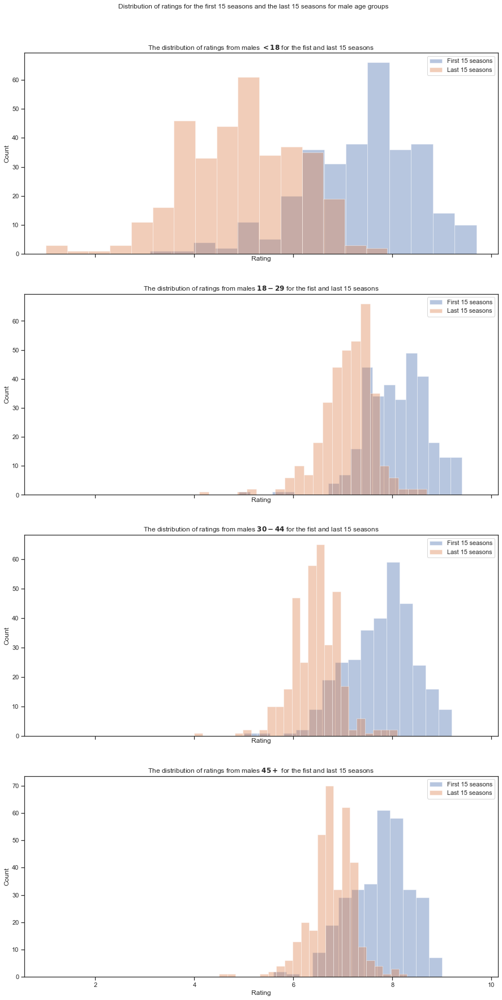

In [119]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, sharex=True, figsize=(15,30))


plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.20)

sns.distplot(df_all_ratings_first_15['males_below_18'], kde=False, ax=ax1)
sns.distplot(df_all_ratings_last_15['males_below_18'], kde=False, ax=ax1)

ax1.set_title("The distribution of ratings from males "+ r"$\bf{<18}$ for the fist and last 15 seasons")
ax1.set_ylabel('Count')
ax1.set_xlabel('Rating')
ax1.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['males_18_29'], kde=False, ax=ax2)
sns.distplot(df_all_ratings_last_15['males_18_29'], kde=False, ax=ax2)

ax2.set_title("The distribution of ratings from males "+ r"$\bf{18-29}$ for the fist and last 15 seasons")
ax2.set_ylabel('Count')
ax2.set_xlabel('Rating')
ax2.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['males_30_44'], kde=False, ax=ax3)
sns.distplot(df_all_ratings_last_15['males_30_44'], kde=False, ax=ax3)

ax3.set_title("The distribution of ratings from males "+ r"$\bf{30-44}$ for the fist and last 15 seasons")
ax3.set_ylabel('Count')
ax3.set_xlabel('Rating')
ax3.legend(labels=['First 15 seasons','Last 15 seasons'])

sns.distplot(df_all_ratings_first_15['males_45_plus'], kde=False, ax=ax4)
sns.distplot(df_all_ratings_last_15['males_45_plus'], kde=False, ax=ax4)

ax4.set_title("The distribution of ratings from males "+ r"$\bf{45+}$ for the fist and last 15 seasons")
ax4.set_ylabel('Count')
ax4.set_xlabel('Rating')
ax4.legend(labels=['First 15 seasons','Last 15 seasons'])

plt.suptitle('Distribution of ratings for the first 15 seasons and the last 15 seasons for male age groups', y=0.92)


plt.show()

In all the age groups for men, the last 15 seasons have a distribution of ratings lower than the first 15 seasons, with a small overlap. 

Here it can be seen that the distribution of ratings for men below 18 does capture the lowest ratings given for the last 15 seasons. 

### 2.2.2 Summary of Findings <a class="anchor" id="two.two.two"></a>

The ratings and number of viewers have been declining through the years.

Each demographic's amounts of ratings has gone down over the years and fewer people are watching the show. 

The main conclusions that can be drawn for this analysis is that the average ratings for females have not fallen as much as for males, but it does seem that it is the male demographic and the change in their ratings that is effecting the series' ratings.

This does pose the question if **the show's essence and the interaction of characters has changed in a way that does invite the female audience to engage more with the series, while resulting in the loss of interest with young men.**

# 3. Tools, Theory and Analysis  <a class="anchor" id="three"></a>

In this chapther the data obtained will be analysed using network science teqniques, as well a using TF-IDF and sentimental analysis.

## 3.1 TF-IDF Analysis and Words Spoken <a class="anchor" id="three.one"></a>

A very important measure that can be used to analyze a text is the TF-IDF score. It combines the Term Frequency of a word in a document with the Inverse Document Frequency (fraction of documents the word is present in) to give a score for each word in each document. This score measures how much a word is characteristic of that document and thus how the word itself distinguishes the document from the others.

### 3.1.1 Synopsis TF-IDF <a class="anchor" id="three.one.one"></a>

#### 3.1.1.1 Synopsis Preparation <a class="anchor" id="three.one.one.one"></a>

In the following, the tf-idf scores per season of the words will be considered, thus the various seasons will be the documents, because the goal is to extract the main themes that distinguish the various seasons from the others. Following this, partecipants' names are not interesting. The dataframe prepared before (with just the `char_wiki_link` split) will be flattened to make sure every name or nickname belonging to characters is removed.

In [120]:
clean_names = pd.read_csv('clean_chars.csv')
clean_names.head(10)

,Unnamed: 0,name,aka,first_name
0,0,Homer,['Homer'],Homer
1,1,Marge,['Marge'],Marge
2,2,Bart,['Bart'],Bart
3,3,Lisa,['Lisa'],Lisa
4,4,Maggie,['Maggie'],Maggie
5,5,Abe,['Abe'],Abe
6,6,Ned Flanders,"['Ned', 'Flanders']",Ned
7,7,Mr. Burns,['Burns'],Burns
8,8,Krusty the Clown,"['Krusty', 'the', 'Clown']",Krusty
9,9,Moe Szyslak,"['Moe', 'Szyslak']",Moe


In [121]:
# Flatten and clean name column
clean_names_splitted = clean_names['name'].apply(lambda x: str(x).split())
clean_names_splitted = [el for list_names in clean_names_splitted for el in list_names]
clean_names_splitted = re.sub(r'[^\w]', ' ', ' '.join(clean_names_splitted)).split()

# Flatten and clean aka column
clean_names_aka = re.sub(r'[^\w]', ' ', ' '.join(clean_names['aka'])).split()
clean_names_aka.extend(clean_names_splitted)
clean_names_aka.append('Simpsons') # append Simpsons as it is not properly a
                                   # proper name but it's just referring the family

# Put all together in a list
splitted_names = list(set(clean_names_aka))
sorted(splitted_names)

['3rd',
 'Abbie',
 'Abe',
 'Abernathy',
 'Abraham',
 'Adrian',
 'Agnes',
 'Akira',
 'Albertson',
 'Albright',
 'Alex',
 'Alger',
 'Alice',
 'Allen',
 'Allison',
 'Alvarine',
 'Amadopolis',
 'Amber',
 'Amico',
 'Anastasia',
 'Andy',
 'Angelica',
 'Annie',
 'Annika',
 'Anoop',
 'Ant',
 'Apu',
 'Aristotle',
 'Arnie',
 'Arnold',
 'Arthur',
 'Artie',
 'Ashley',
 'Atkins',
 'Augusta',
 'Bailey',
 'Ballerina',
 'Bambi',
 'Bancroft',
 'Band',
 'Banner',
 'Barbara',
 'Barber',
 'Barks',
 'Barlow',
 'Barney',
 'Bart',
 'Base',
 'Bashir',
 'Beardly',
 'Becky',
 'Beggar',
 'Belew',
 'Benjamin',
 'Berger',
 'Bernice',
 'Bernstein',
 'Betty',
 'Bill',
 'Billy',
 'Birch',
 'Bisque',
 'Bitey',
 'Black',
 'Bleeding',
 'Blinky',
 'Blue',
 'Bluella',
 'Blues',
 'Bob',
 'Bobbins',
 'Bobo',
 'Bodhi',
 'Bolivian',
 'Bomb',
 'Bonnie',
 'Booberella',
 'Book',
 'Bortner',
 'Borton',
 'Botzcowski',
 'Bouvier',
 'Boy',
 'Boyman',
 'Brawn',
 'Brittany',
 'Brockman',
 'Brodka',
 'Brunella',
 'Bumblebee',
 'Burns',

The synopsis data extracted before was saved in external files. Now those will be read and cleaned. It will be saved in a dictionary.

In [122]:
# Root path for the synopsis
syn_path = 'synopsis/'

# Dictionary with all synopsys
synopsis = {}

# Get all the stopwords
stop_words = set(stopwords.words('english'))

# Iterate through all files
for subdir, dirs, files in os.walk(syn_path):
    for file in files:
        complex_path = os.path.join(subdir, file)
        ep_syn = io.open(complex_path,'r',encoding='utf-8').read()
        
        soup = BeautifulSoup(ep_syn,'html')
        ep_syn = soup.text
        
        # Remove punctuation and numbers
        ep_syn = re.sub(r'[^\w]', ' ', ep_syn)
        
        # Tokenize the synopsis and remove the proper names
        ep_syn_tok = word_tokenize(ep_syn)
        ep_syn_tok = [el.lower() for el in ep_syn_tok if el not in splitted_names]
        synopsis[file.split('.')[0]] = [el for el in ep_syn_tok if el not in stop_words]

synopsis

{'1': ['merry',
  'plans',
  'cut',
  'bonuses',
  'spend',
  'family',
  'savings',
  'erase',
  'tattoo',
  'thought',
  'would',
  'make',
  'great',
  'present',
  'learns',
  'getting',
  'bonus',
  'life',
  'gets',
  'even',
  'tighter',
  'breadwinner',
  'except',
  'take',
  'second',
  'job',
  'shopping',
  'mall',
  'santa'],
 '10': ['purchases',
  'spy',
  'camera',
  'catalogue',
  'goes',
  'stag',
  'party',
  'local',
  'restaurant',
  'rest',
  'family',
  'goes',
  'restaurant',
  'coincidentally',
  'snaps',
  'picture',
  'dancing',
  'belly',
  'dancer',
  'soon',
  'sees',
  'picture',
  'orders',
  'house',
  'takes',
  'burlesque',
  'show',
  'explain',
  'take',
  'advantage',
  'women'],
 '11': ['flushes',
  'cherry',
  'bomb',
  'toilet',
  'suggests',
  'partake',
  'foreign',
  'exchange',
  'scheme',
  'transferred',
  'france',
  'working',
  'criminals',
  'spike',
  'wine',
  'antifreeze',
  'meanwhile',
  'back',
  'adil',
  'hoxha',
  'albanian',
 

This dictonary now contains the clean synopsis for each of the episodes. It will be appended as a column to the complessive dataframe built earlier, matching the season and the episode to have a broader view on the data.

In [123]:
# Order the dictionary so that the episodes are ordered following the episode number
# This will allow to have correspondance with the old dataset
df_episodes_ratings['synopsis'] = dict(sorted(synopsis.items(), reverse=False, key=lambda x: int(x[0]))).values()

df_episodes_ratings

,no_overall,season,no_in_season,episode_name,viewers (millions),IMDB rating,year,month,day,wiki_link,main_characters,synopsis
0,1,1,1,Simpsons Roasting on an Open Fire,26.70,8.2,1989,12,17,Simpsons_Roasting_on_an_Open_Fire,[Homer_Simpson],"[merry, plans, cut, bonuses, spend, family, sa..."
1,2,1,2,Bart the Genius,24.50,7.8,1990,01,14,Bart_the_Genius,[Bart_Simpson],"[swaps, papers, class, intelligence, test, sch..."
2,3,1,3,Homer's Odyssey,27.50,7.4,1990,01,21,Homer%27s_Odyssey,"[Homer_Simpson, Mr._Burns]","[fired, job, technical, supervisor, nuclear, p..."
3,4,1,4,There's No Disgrace Like Home,20.20,7.7,1990,01,28,There%27s_No_Disgrace_Like_Home,[Homer_Simpson],"[takes, family, unorthodox, counselor, uses, s..."
4,5,1,5,Bart the General,27.10,8.1,1990,02,04,Bart_the_General,"[Bart_Simpson, Abraham_Simpson_II]","[defending, school, bully, becomes, latest, sc..."
...,...,...,...,...,...,...,...,...,...,...,...,...
657,658,30,19,Girl's in the Band,2.07,6.2,2019,03,31,Girl%27s_in_the_Band,,"[director, capitol, philharmonic, takes, notic..."
658,659,30,20,I'm Just a Girl Who Can't Say D'oh,1.61,5.2,2019,04,07,I%27m_Just_a_Girl_Who_Can%27t_Say_D%27oh,,"[becomes, director, local, theater, armed, scr..."
659,660,30,21,D'oh Canada,1.93,5.2,2019,04,28,D%27oh_Canada,,"[go, niagara, falls, goes, falls, mistakenly, ..."
660,661,30,22,Woo-Hoo Dunnit?,1.79,5.9,2019,05,05,Woo-hoo_Dunnit%3F,,"[college, fund, goes, missing, documentary, cr..."


Now the `groupby()` function can be used to cluster episodes in the corresponding season. This groupby will enable the computation of the TF-IDF score over seasons.

In [124]:
# Group the synopsis by season
seasons_words = df_episodes_ratings.groupby('season')['synopsis'].apply(lambda x: x.sum())
seasons_words

season
1     [merry, plans, cut, bonuses, spend, family, sa...
2     [told, grades, slipping, fails, complete, anot...
3     [thanks, leaving, lucky, red, hat, pile, washe...
4     [spend, six, weeks, kamp, however, camp, seems...
5     [flashback, 1985, chief, later, replaced, hit,...
6     [parody, alfred, hitchcock, classic, rear, win...
7     [convinced, one, pulled, trigger, drunk, confe...
8     [seventh, annual, treehouse, horror, episode, ...
9     [driven, brink, insanity, appointed, status, d...
10    [chosen, introduce, new, student, elementary, ...
11    [get, go, preview, screening, mel, gibson, lat...
12    [g, g, ghost, dad, killed, choking, piece, bro...
13    [opening, scares, hell, halloween, hex, segmen...
14    [send, clones, ends, cloning, begins, wreaking...
15    [another, annual, halloween, special, see, bec...
16    [title, card, two, year, remodeling, kitchen, ...
17    [falls, football, betting, scam, owes, money, ...
18    [school, befriends, son, put, commi

Now there is one more observation. Confronting a lot of wordclouds and seasons will be prohibitive, because of the huge number of words and also how different these words are. To make this manageable while keeping it relevant, seven distinct seasons have been taken into account:

* **Top 2 seasons in the first 9**. This because these are considered the best seasons in the show's history. The ones with the best ranking will be used to be as accurate as possible in the analysis
* **Worst 2 seasons after the 17th**. This because the rating decay gets slower after the 17th season. It still remains bad compared to the first seasons, but it's not improving. These seasons can give an insight on the cause.
* **Seasons 11, 12, 13**. What is that brought the show from such a high rating to a pretty low one? These seasons, which are in the middle of the rating decay, will be analyzed: the choice has fallen on these because it happens that season 12 improves the rating of the previous season, just to fall down again with the 13th. This has then to be a focal point for the analysis.

**Notice that every following TF-IDF analysis will be done evaluating only these critical seasons** following the motivation just given above. Still the TF-IDF score is computed considering all the seasons, otherwise it would be relevant just for the chosen seasons and not for the whole history of the show.

In [125]:
# Array to store seasons to analyze
analyze_seasons = []

# Group the episodes by season and find the mean rating
seasons_only_ratings = df_episodes_ratings.groupby('season').mean()['IMDB rating'].reset_index()[:26]

# Add the maximum score in the first 9 seasons
idx = pd.Index(seasons_only_ratings['IMDB rating'][:9]).argmax()
max_score = seasons_only_ratings['season'].iloc[idx]
analyze_seasons.append(max_score)

# Find the second best one
# First remove the old max
seasons_only_ratings = seasons_only_ratings.drop(idx)
idx = pd.Index(seasons_only_ratings['IMDB rating'][:9]).argmax()
max_score = seasons_only_ratings['season'].iloc[idx]
analyze_seasons.append(max_score)

# Add 11, 12, 13 to have them now in order
analyze_seasons.extend([11, 12, 13])

# Find the worst one after season 17
# Indexes are tilted because we removed one season
idx = pd.Index(seasons_only_ratings['IMDB rating'][15:]).argmin()
min_score = seasons_only_ratings['season'][15:].iloc[idx]
analyze_seasons.append(min_score)

# Find the second worse
# Since the worse is the 26th we can just not consider it in the array
idx = pd.Index(seasons_only_ratings['IMDB rating'][15:24]).argmin()
min_score = seasons_only_ratings['season'][15:24].iloc[idx]
analyze_seasons.append(min_score)
print("Seasons to analyze: ", analyze_seasons)

Seasons to analyze:  [5, 7, 11, 12, 13, 26, 24]


#### 3.1.1.2 Synopsis TF-IDF Analysis <a class="anchor" id="three.one.one.two"></a>

Data is now compute TF scores for every season. To do this it is applied the `FreqDist()` function of nltk, which just returns a dictionary with the word as key and the count of its appearences as value.

In [126]:
# Setup the dictionary for TFs and a variable as index
seasons_tf = {}
s = 1

# Compute the FreqDist for each season
for s in range(1,31):
    seasons_tf[s] = dict(nltk.FreqDist(seasons_words[s]))

seasons_tf

{1: {'merry': 1,
  'plans': 1,
  'cut': 1,
  'bonuses': 1,
  'spend': 1,
  'family': 4,
  'savings': 1,
  'erase': 1,
  'tattoo': 1,
  'thought': 1,
  'would': 1,
  'make': 1,
  'great': 1,
  'present': 1,
  'learns': 1,
  'getting': 1,
  'bonus': 1,
  'life': 2,
  'gets': 2,
  'even': 1,
  'tighter': 1,
  'breadwinner': 1,
  'except': 1,
  'take': 2,
  'second': 1,
  'job': 2,
  'shopping': 1,
  'mall': 1,
  'santa': 1,
  'swaps': 1,
  'papers': 1,
  'class': 1,
  'intelligence': 1,
  'test': 2,
  'school': 5,
  'psychologist': 1,
  'compiles': 1,
  'results': 1,
  'believes': 1,
  'switch': 1,
  'refers': 1,
  'enriched': 1,
  'learning': 1,
  'center': 1,
  'gifted': 1,
  'children': 2,
  'new': 2,
  'laid': 1,
  'back': 4,
  'liberal': 1,
  'ethos': 1,
  'suits': 1,
  'brilliant': 1,
  'way': 1,
  'asked': 1,
  'show': 3,
  'evidence': 1,
  'neglected': 1,
  'genius': 1,
  'fired': 1,
  'technical': 1,
  'supervisor': 1,
  'nuclear': 1,
  'power': 2,
  'plant': 2,
  'unable': 2,
  

Compute the IDFs Scores.

In [127]:
# Create a vocabulary of all unique words flattening the synopsis series
all_words = set(seasons_words.sum())

# Now set up the placeholders
seasons_idf = {}
n_documents = 30 # we have 30 seasons

for word in all_words:
    
    # Count in how many documents the word is in
    count = 0
    for s in range(1,31):
        if word in seasons_words[s]:
            count += 1
    
    # Store the idf
    seasons_idf[word] = np.log(n_documents/count)
    
seasons_idf

{'america': 2.70805020110221,
 'soldiers': 3.4011973816621555,
 'frustrates': 3.4011973816621555,
 'tripped': 3.4011973816621555,
 'feet': 2.0149030205422647,
 'actress': 3.4011973816621555,
 'stolen': 1.791759469228055,
 'chief': 1.0986122886681098,
 'economy': 3.4011973816621555,
 'cow': 2.70805020110221,
 'recalling': 3.4011973816621555,
 'structures': 3.4011973816621555,
 'pack': 2.70805020110221,
 'dioguardi': 3.4011973816621555,
 'healthy': 2.70805020110221,
 'restoring': 3.4011973816621555,
 'hovers': 3.4011973816621555,
 'woosterfield': 3.4011973816621555,
 'gulf': 3.4011973816621555,
 'time': 0.22314355131420976,
 'sour': 2.70805020110221,
 'almost': 1.791759469228055,
 'logo': 2.70805020110221,
 'stupor': 3.4011973816621555,
 'allowed': 2.0149030205422647,
 'detonate': 2.70805020110221,
 'amazon': 3.4011973816621555,
 'republican': 2.70805020110221,
 'marlon': 3.4011973816621555,
 'faces': 3.4011973816621555,
 'electrons': 3.4011973816621555,
 'lung': 3.4011973816621555,
 'th

Finally compute the whole TF-IDF score and save it into a dictionary as well. For the TF-IDF storage dictionaries will be used.

In [128]:
# Placeholder
seasons_tf_idf = {}

# Iterate through each TF dictionary for the seasons
for s in range(1,31):
    # Support dictionary for IDFs
    tmp = {}
    
    # Now compute TF-IDF and save it in the support dict
    for word, tf in seasons_tf[s].items():
         tmp[word] = tf * seasons_idf[word]
            
    # Append the support dict to the whole one
    seasons_tf_idf[s] = tmp
    
seasons_tf_idf

{1: {'merry': 3.4011973816621555,
  'plans': 0.31015492830383945,
  'cut': 1.455287232606842,
  'bonuses': 3.4011973816621555,
  'spend': 1.0033021088637848,
  'family': 0.13560620670272566,
  'savings': 2.0149030205422647,
  'erase': 3.4011973816621555,
  'tattoo': 2.70805020110221,
  'thought': 1.6094379124341003,
  'would': 1.0986122886681098,
  'make': 0.31015492830383945,
  'great': 1.6094379124341003,
  'present': 1.6094379124341003,
  'learns': 0.8362480242006185,
  'getting': 0.4567584024957149,
  'bonus': 3.4011973816621555,
  'life': 0.44628710262841953,
  'gets': 0.13798574297390284,
  'even': 1.0986122886681098,
  'tighter': 3.4011973816621555,
  'breadwinner': 3.4011973816621555,
  'except': 2.0149030205422647,
  'take': 0.5314063314660114,
  'second': 0.9162907318741551,
  'job': 1.0216512475319814,
  'shopping': 1.791759469228055,
  'mall': 1.3217558399823195,
  'santa': 0.7621400520468967,
  'swaps': 3.4011973816621555,
  'papers': 2.70805020110221,
  'class': 0.7621400

The wordclouds for the chosen seasons can be finally generated. First strings will be created for each season, with every word appearing a number of time equal to the integer conversion of the TF-IDF scores. This because the `WordCloud()` function takes as argument a string.

In [129]:
seasons_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in seasons_tf_idf[s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    seasons_ready[s] = ' '.join(tmp)

In [132]:
# Dictionary containing all the WordClouds
wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(seasons_ready[s])

Here the wordclouds are plotted. The commented part of the code has been used to save even the wordclouds for the seasons not considered in this analysis. It requires a small change in the two cells above (in the `for` cycle use `range(1,31)` instead of the selected seasons `analyze_seasons`).

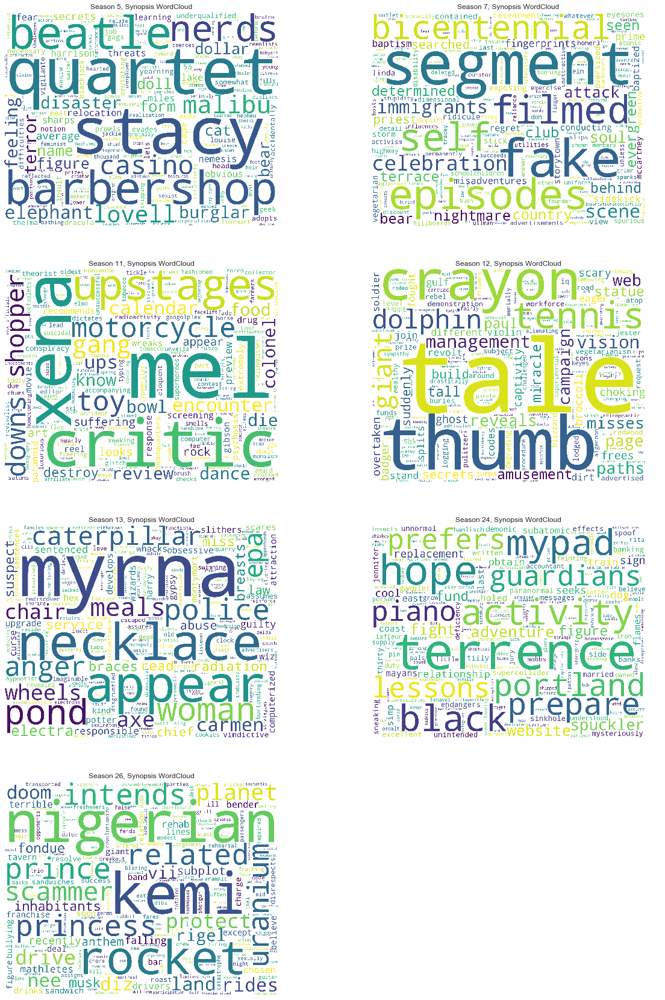

'\n# Here save all the wordclouds for lated usage\ns_no = 1\nfor i in range(1, 31):\n    plt.imshow(wc_dict[s_no])\n    plt.title("Season {}, Synopsis WordCloud".format(s_no))\n    plt.axis(\'off\')\n    plt.savefig(\'WordClouds/Season_Synopsis_WordClouds/season{}.png\'.format(s_no))\n    s_no += 1\n'

In [133]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(wc_dict[5])
ax[0,0].set_title("Season {}, Synopsis WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(wc_dict[7])
ax[0,1].set_title("Season {}, Synopsis WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(wc_dict[11])
ax[1,0].set_title("Season {}, Synopsis WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(wc_dict[12])
ax[1,1].set_title("Season {}, Synopsis WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(wc_dict[13])
ax[2,0].set_title("Season {}, Synopsis WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(wc_dict[24])
ax[2,1].set_title("Season {}, Synopsis WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(wc_dict[26])
ax[3,0].set_title("Season {}, Synopsis WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

'''
# Here save all the wordclouds for lated usage
s_no = 1
for i in range(1, 31):
    plt.imshow(wc_dict[s_no])
    plt.title("Season {}, Synopsis WordCloud".format(s_no))
    plt.axis('off')
    plt.savefig('WordClouds/Season_Synopsis_WordClouds/season{}.png'.format(s_no))
    s_no += 1
'''

Here words with bigger dimension have more relevance according to TF-IDF. Still, just with the eye, some of the magnitude relationships can not be distinguished (the problem is which one is bigger). To give a better insight barplots of the 10 words with higherst score per season are used.

In [134]:
# Sort the dictionaries and make them dataframes to ease the plotting
# SEASON 5
s5 = dict(sorted(seasons_tf_idf[5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(seasons_tf_idf[7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(seasons_tf_idf[11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(seasons_tf_idf[12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(seasons_tf_idf[13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(seasons_tf_idf[24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(seasons_tf_idf[26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

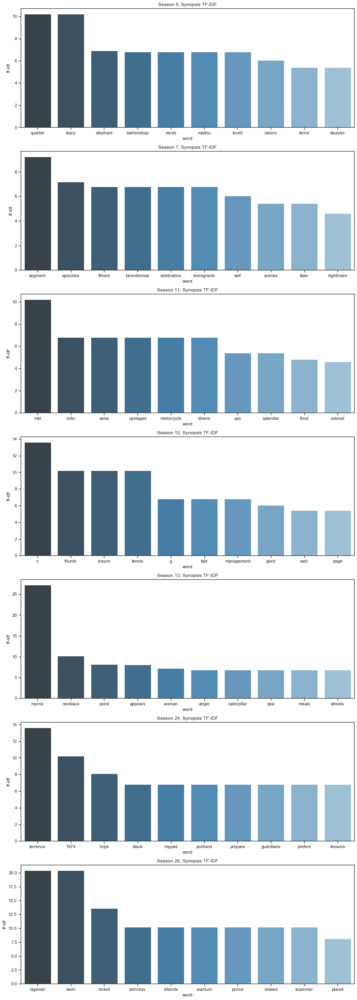

In [135]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Synopsis TF-IDF".format(5))
ax2.set_title("Season {}, Synopsis TF-IDF".format(7))
ax3.set_title("Season {}, Synopsis TF-IDF".format(11))
ax4.set_title("Season {}, Synopsis TF-IDF".format(12))
ax5.set_title("Season {}, Synopsis TF-IDF".format(13))
ax6.set_title("Season {}, Synopsis TF-IDF".format(24))
ax7.set_title("Season {}, Synopsis TF-IDF".format(26))

plt.show()

*In the following analysis the bold words are the words found with the TF-IDF analysis.*

The first evident thing is that these WordClouds do not seem to help a lot in the quest of analyzing the evolution of the Simpsons' show. It can probably be said that the synopsis for the episodes are not deep or detailed enough to identify the main themes for each single season, but just for some of them.

The focus should be first on the best (season 5, 1993-1994) and the worst (season 26, 2014-2015) seasons:
* Season 5 has as one of the most distinctive themes music. **quartet** and **barbershop** refer to the famous *Homer's Barbershop Quartet*, appearing in the very famous first episode of the season. Music is something everyone likes and probably this episode reached out to a lot of people and thus got a high rating. Then already two different political/ethical topics are introduced: **stacy** refers to a doll (Malibu Stacy) which, in Lisa's opinion, gave a bad image of women and an **elephant** is present in one of the episodes, bringin to the public the problem of having animal refuges. There are also situations that can more resemble a real one: Homer does not have the knkowledge to carry on his work at the nuclear plant so he is sent back to school in which he is helped by **nerds**.
* Season 26 (2014-2015) seems to have as most distinctive topic the environment: there is **uranium**, which is a hot recurrent topic even now. In 2015 the US stipulated a deal with Iran on research on nuclear power to stop them from having nuclear bombs (deal still discussed nowadays). This is treated in the show with a **nigerian** (top word for that season) **princess** (**kemi**) coming to Springfield and making deals with Mr. Burns. It does seem to cover a more relevant role wrt the immigrants topic in season 7 as explained in the following point, and thus it may be perceived as more invasive by the audience.

There are some other hot political/ethical topics that distinguish the various seasons from the others:
* **immigrants** in season 7 (1995-1996) has been a hot topic for decades now, but the rising of it in the 90s (in which it reached around 1 million immigrants/year) is the real breakpoint. Everyone started talking about it and having concerns about national security. This is probably why people was interested in it to the point of accepting some reflexion about it even in a relaxing tv show, in which the topic was presented: key was probably insert it not in an annoying way (it can be stated this because the word is not one of the top 5 scoring words, while keeping a high importance, such to be one of the top 10).
    - *Source:* [article](https://www.prb.org/us-migration-trends/)
* **caterpillar**, **epa** (Environmental Protection Agency), **pond** in season 13 (2001-2002) are the prominent words. These are very clearly all linked to environmental issues, which can inferred as the most relevant topic treated in season 13. Since it is in the middle of the downfall of the rating, bringing the score down while season 12 tried to bring it up, it is a very central one to analyze. It can be stated from this that the environmental topics are not that popular amongst the audience: a lot of the ratings are given by US citizens, who have a lot of controversial opinions about safeguarding environment. This might also raise doubts on why the Simpsons' film was all about environment as well, if not just to try to educate people even more on the topic.

At the end, seeing that these hot actual topics, both strictly political and ethical, seem to be introduced later on in the show, may arise the suspicion that the show went from representing a parody of a typical american family to educate people on the current relevant hot topics. This might have beeen seen by fans as a forced introduction into the show, changing its nature and so lowering its value. Another possible explanation is just that the few political topics in the first seasons were presented in a different and in a way that better suited the interest of the audience.

In fact looks like people are not liking a lot the environmental issues, presented over and over after season 10, probably because they feel like it's a distant problem: vice-versa immigration of season 7 seems to affect them in a more direct way. This, though, is in contrast with season 5 that exposes the safeguard of animals problem: maybe animated beings have more value to people than plants, or maybe that season was simply very appreciated that this topic didn't affect it too much.

There is also the need to confront this with the audience graphs. Both male adults and teens ratings did decrease a lot during the years. This happens for the female audience as well, but more aged women (45+) do give higher scores to some of the lastest seasons. This is probably because of the introduction of more appealing topics for them: the nigerian princess, given a lot of power and the quest to negotiate with a powerful buisnessman is a clear example of this. Still the number of these viewers is not enough to stop the drop of the rating.

Now the scripts of the episodes will be analyzed to confirm more about this: they should hold on to more informations.

### 3.1.2 Scripts TF-IDF<a class="anchor" id="three.one.two"></a>

#### 3.1.2.1 Scripts Preparation <a class="anchor" id="three.one.two.one"></a>

Here the work is the same as the previous section, but this time using the full scripts of the episodes. Just 26 seasons have the complete scripts, so it's not possible to compare the previous results for seasons 27 to 30.

The first observation, when checking the scripts dataframe, is that there are lines that are not speech, but noises or actions.

In [136]:
df_script[df_script['speaking_line'] == 'false']

,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name,no_overall,season,no_in_season
8,32,225,(Springfield Elementary School: EXT. ELEMENTAR...,false,NaN,Springfield Elementary School,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
19,32,236,Bart Simpson: (ANGUISHED SCREAM),false,Bart Simpson,Springfield Elementary School,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
21,263,106,(Moe's Tavern: Int. Moe's - evening),false,NaN,Moe's Tavern,NaN,NaN,"Hungry, Hungry Homer",263.0,12.0,15.0
24,32,217,(Apartment Building: Ext. apartment building -...,false,NaN,Apartment Building,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
35,32,243,(Train Station: int. train station - afternoon),false,NaN,Train Station,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...
158194,32,132,(Springfield Elementary School: INT. ELEMENTAR...,false,NaN,Springfield Elementary School,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
158205,32,143,(Simpson Home: INT. SIMPSON HOUSE - LIVINGING ...,false,NaN,Simpson Home,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
158215,32,153,(Museum: INT. MUSEUM - ADMISSION AREA - DAY),false,NaN,Museum,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0
158243,32,181,(SIMPSON HOUSE - BASEMENT STAIRCASE: INT. SIMP...,false,NaN,SIMPSON HOUSE - BASEMENT STAIRCASE,NaN,NaN,Lisa's Substitute,32.0,2.0,19.0


To have a real understanding of the speech these rows have to be ignored.

In [137]:
df_script_speech = df_script[df_script['speaking_line'] == 'true']

Then a cleaning of the extracted data is needed. The most important column is `raw_text` as it is the one containing the actual sentences the characters say. Two particular things have to be considered apart from the stopwords and character names removal:
* Each sentence starts with *Character Name:*, so just delete everything before the first occurence of character *:*
* After the name, if the sentence is said in some specific way (crying, reading, whispering), this is indicated with a standard syntax, eg. *(WHISPERING)*. This has been removed as well.

In [138]:
# Function to call on each sentence
def clean_speech(sent):
    # Remove the names at the beginning of the sentence
    sent = re.sub(r'^.*:', '', sent)
    
    # Remove the action
    sent = re.sub(r'^\([A-Z]*\)', '', sent)
    
    # Remove punctuation and numbers
    sent = re.sub(r'[^\w]', ' ', sent)

    # Tokenize and remove the proper names
    sent_tok = word_tokenize(sent)
    sent_tok = [el.lower() for el in sent_tok if el not in splitted_names]
    sent_tok = [el for el in sent_tok if el not in stop_words]
    
    # Return the clean sentence
    return sent_tok

# Print an example
print(df_script_speech['raw_text'][0])
print(clean_speech(df_script_speech['raw_text'][0]))

# Clean the data
df_script_speech['raw_text'] = df_script_speech['raw_text'].apply(clean_speech)

Miss Hoover: No, actually, it was a little of both. Sometimes when a disease is in all the magazines and all the news shows, it's only natural that you think you have it.
['actually', 'little', 'sometimes', 'disease', 'magazines', 'news', 'shows', 'natural', 'think']


Now that the dataset is cleaner, the data is grouped in the same fashion as with the synopsis.

In [139]:
# Group the scripts by season
script_seasons_words = df_script_speech.groupby('season')['raw_text'].apply(lambda x: x.sum())
script_seasons_words

season
1.0     [ooo, careful, time, careful, late, hushed, vo...
2.0     [actually, little, sometimes, disease, magazin...
3.0     [softly, hey, groggy, six, alarmed, something,...
4.0     [phew, never, mind, well, children, last, day,...
5.0     [singing, self, human, roaches, feeding, garba...
6.0     [well, certainly, job, today, sun, oh, rats, s...
7.0     [uncertain, hey, hey, cotton, mouth, ugh, mout...
8.0     [ohmigod, look, whispers, hear, whispers, mayb...
9.0     [chauffeur, thanks, lift, car, wha, uh, oh, co...
10.0    [look, dad, got, every, kind, paper, looseleaf...
11.0    [think, gon, na, sick, kind, air, want, leave,...
12.0    [perfect, awed, wow, vain, yes, go, hey, cut, ...
13.0    [ew, hurry, halloween, upon, us, put, decorati...
14.0    [know, neighboreenos, halloween, fun, séance, ...
15.0    [chump, good, grief, candy, terrible, increasi...
16.0    [moan, another, setback, return, keepin, starr...
17.0    [right, rolls, eyes, boss, hell, whoa, baby, c...
18.0   

#### 3.1.2.2 Scripts TF-IDF Analysis <a class="anchor" id="three.one.two.two"></a>

Now compute the TF-IDF score as done before.

In [140]:
# Setup the dictionary for TFs and a variable as index
script_seasons_tf = {}
s = 1

# Compute the FreqDist for each season
for s in range(1,27):
    script_seasons_tf[s] = dict(nltk.FreqDist(script_seasons_words[s]))

script_seasons_tf

{1: {'ooo': 3,
  'careful': 4,
  'time': 59,
  'late': 9,
  'hushed': 1,
  'voice': 6,
  'sorry': 53,
  'excuse': 9,
  'us': 71,
  'pardon': 4,
  'simultaneously': 2,
  'hey': 142,
  'going': 73,
  'got': 118,
  'dragged': 2,
  'heh': 22,
  'ya': 9,
  'galoshes': 1,
  'chuckles': 26,
  'unrehearsed': 1,
  'wonderful': 7,
  'santas': 1,
  'many': 14,
  'lands': 1,
  'presented': 1,
  'entire': 1,
  'second': 15,
  'grade': 7,
  'class': 19,
  'oh': 296,
  'shy': 1,
  'nervous': 6,
  'frohlich': 1,
  'weihnachten': 1,
  'german': 1,
  'merry': 6,
  'germany': 1,
  'santa': 32,
  'servant': 1,
  'ruprecht': 1,
  'gives': 2,
  'presents': 7,
  'good': 94,
  'children': 25,
  'whipping': 1,
  'rods': 3,
  'parents': 6,
  'bad': 21,
  'ones': 9,
  'meri': 1,
  'kurimasu': 1,
  'hotseiosha': 1,
  'japanese': 1,
  'priest': 1,
  'acts': 3,
  'like': 145,
  'claus': 3,
  'eyes': 15,
  'back': 50,
  'head': 25,
  'better': 37,
  'behave': 2,
  'nearby': 1,
  'presenting': 2,
  'tawanga': 1,
  's

In [141]:
# Create a vocabulary of all unique words flattening the scripts series
script_all_words = set(script_seasons_words.sum())

# Now set up the placeholders
script_seasons_idf = {}
n_documents = 26 # we have 26 seasons

for word in script_all_words:
    
    # Count in how many documents the word is in
    count = 0
    for s in range(1,27):
        if word in script_seasons_words[s]:
            count += 1
    
    # Store the idf
    script_seasons_idf[word] = np.log(n_documents/count)
    
script_seasons_idf

{'silly': 0.12260232209233228,
 'poets': 3.258096538021482,
 'soldiers': 0.9555114450274363,
 'lenford': 2.5649493574615367,
 'calmness': 3.258096538021482,
 'maui': 2.5649493574615367,
 'actress': 1.1786549963416462,
 'chevy': 1.3121863889661687,
 'enviously': 3.258096538021482,
 'aorta': 3.258096538021482,
 'kzmb': 3.258096538021482,
 'stolen': 0.4248831939652659,
 'assured': 1.466337068793427,
 'loaf': 1.466337068793427,
 'cinder': 3.258096538021482,
 'petty': 1.0608719606852626,
 'economy': 0.4855078157817008,
 'cow': 0.26236426446749106,
 'laurence': 3.258096538021482,
 'stiffed': 2.5649493574615367,
 'ahem': 1.8718021769015913,
 'drugged': 1.6486586255873816,
 'dopey': 2.159484249353372,
 'comrades': 3.258096538021482,
 'meringue': 2.159484249353372,
 'oat': 3.258096538021482,
 'reeling': 2.5649493574615367,
 'taboo': 3.258096538021482,
 'conceitedness': 3.258096538021482,
 'bleach': 1.8718021769015913,
 'gem': 1.8718021769015913,
 'stonewall': 2.5649493574615367,
 'ner': 0.61903

In [142]:
# WHOLE TF-IDF
# Placeholder
script_seasons_tf_idf = {}

# Iterate through each TF dictionary for the seasons
for s in range(1,27):
    # Support dictionary for IDFs
    tmp = {}
    
    # Now compute TF-IDF and save it in the support dict
    for word, tf in script_seasons_tf[s].items():
         tmp[word] = tf * script_seasons_idf[word]
            
    # Append the support dict to the whole one
    script_seasons_tf_idf[s] = tmp

script_seasons_tf_idf

{1: {'ooo': 0.117662139459844,
  'careful': 0.6682163386526649,
  'time': 0.0,
  'late': 0.0,
  'hushed': 0.36772478012531734,
  'voice': 0.0,
  'sorry': 0.0,
  'excuse': 0.0,
  'us': 0.0,
  'pardon': 1.0494570578699642,
  'simultaneously': 5.1298987149230735,
  'hey': 0.0,
  'going': 0.0,
  'got': 0.0,
  'dragged': 1.9110228900548727,
  'heh': 3.675189862589657,
  'ya': 0.0,
  'galoshes': 2.5649493574615367,
  'chuckles': 0.0,
  'unrehearsed': 2.159484249353372,
  'wonderful': 0.0,
  'santas': 2.5649493574615367,
  'many': 0.0,
  'lands': 1.0608719606852626,
  'presented': 1.466337068793427,
  'entire': 0.0,
  'second': 0.0,
  'grade': 0.0,
  'class': 0.0,
  'oh': 0.0,
  'shy': 0.3136575588550416,
  'nervous': 0.0,
  'frohlich': 3.258096538021482,
  'weihnachten': 3.258096538021482,
  'german': 0.16705408466316624,
  'merry': 2.206348680751904,
  'germany': 1.1786549963416462,
  'santa': 2.5613666455531634,
  'servant': 1.466337068793427,
  'ruprecht': 3.258096538021482,
  'gives': 0.

Now produce the wordclouds.

In [143]:
script_seasons_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in script_seasons_tf_idf[s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    script_seasons_ready[s] = ' '.join(tmp)

In [144]:
# Dictionary containing all the WordClouds
script_wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    script_wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(script_seasons_ready[s])

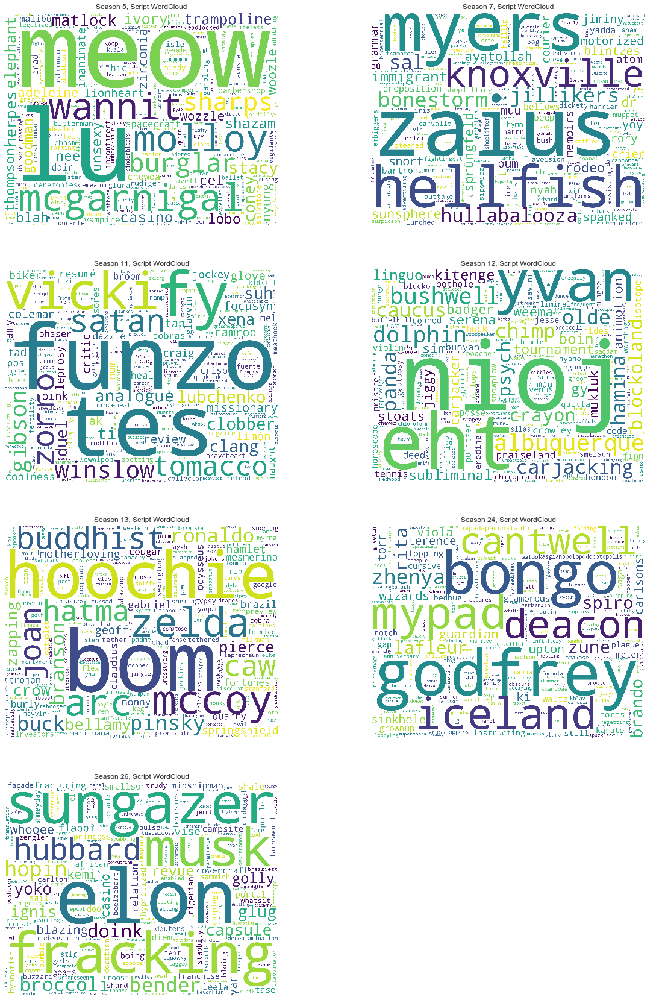

In [145]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(script_wc_dict[5])
ax[0,0].set_title("Season {}, Script WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(script_wc_dict[7])
ax[0,1].set_title("Season {}, Script WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(script_wc_dict[11])
ax[1,0].set_title("Season {}, Script WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(script_wc_dict[12])
ax[1,1].set_title("Season {}, Script WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(script_wc_dict[13])
ax[2,0].set_title("Season {}, Script WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(script_wc_dict[24])
ax[2,1].set_title("Season {}, Script WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(script_wc_dict[26])
ax[3,0].set_title("Season {}, Script WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

Now, same as before, plot the TF-IDF scores to have a better insight for the evaluation.

In [146]:
# Sort the dictionaries to ease the plotting
# SEASON 5
s5 = dict(sorted(script_seasons_tf_idf[5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(script_seasons_tf_idf[7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(script_seasons_tf_idf[11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(script_seasons_tf_idf[12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(script_seasons_tf_idf[13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(script_seasons_tf_idf[24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(script_seasons_tf_idf[26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

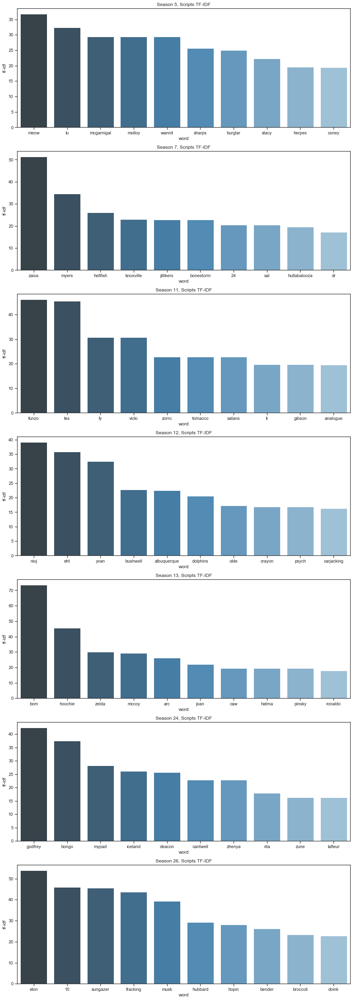

In [147]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Scripts TF-IDF".format(5))
ax2.set_title("Season {}, Scripts TF-IDF".format(7))
ax3.set_title("Season {}, Scripts TF-IDF".format(11))
ax4.set_title("Season {}, Scripts TF-IDF".format(12))
ax5.set_title("Season {}, Scripts TF-IDF".format(13))
ax6.set_title("Season {}, Scripts TF-IDF".format(24))
ax7.set_title("Season {}, Scripts TF-IDF".format(26))

plt.show()

In the script analysis the goal is to confirm and expand on what was inferred from the synopsis analysis, starting always confronting the best and the worst season. The results are not actually what one might expect: a lot of the words are different and they give a different view of these seasons.

In season 5 it can be seen that immigrants seems to not be as heavy as a distinguishing factor from the other seasons (and this complies to the fact that the problem is not treated in an annoying and repetitive way). Another confirmation comes from **stacy**, the sexist doll, which really seems to be a distinghuishing theme. The third word **mcgarnagal** just comes from a tv show announcement, about some crime show, always popular, but not very telling for the analysis. The other words refer mainly episode 11, when Lisa's sax is stolen by the cat (that's why **meow**) **burglar**, who's actually a senior named **malloy**. **lu** is probably connected to this as well, being most likely referring the police officer *Lou*.

Another confirmation comes from season 26: the top word is **elon** and then there is **musk**, obviously referring Elon Musk, on whom the 12th episode is centered about. The confirmation is that the show tries to adapt itself to new themes, which should reach to people, but the audience is not perceiving quality in this. Then there is the music theme again, with **sungazer**, which is the name of a hard-rock band. Homer tried to create a new garage band as well that episode, but it seems that this theme repeating again with the same recipe (Homer having a musical group, which happened even during his youth as well) is annoying for the audience. The last confirmation is how much environment is central in this season: **fracking** is a technique that exploits a liquid pressure (usually water) to create and propagate fractures in the underground. This is done illegally in this episode by Mr. Burns, who wants to make the most of the mineral resources under Springfield, not caring about putting the city in danger. Important is **broccoli** as well: when Homer wants to make Bart eat broccoli they fight, to the point that Marge has to sign them up for the Relation Ship to restore their relationship.

There is some environment discussion as well in season 11, with the **tomacco** a cultivation started by Homer by accidentally combining tomato and tobacco, while he was running from a duel inspired by **zorro** movies. **funzo** refers to a toy invented by a company who was exploiting the children of the school to have new ideas: this is clearly a sad theme, also because the setting is right before Christmas. **gibson** instead refers to *Mel Gibson*, who was helped by Homer in trying making his last film more violent: at the end the production crew gets mad at them and the film is appointed as very bad by everyone, showing how pointless violence is to avoid even in films.

For season 7 **zaius**, the first word, is very characteristic of the season, but does not have any particular meaning since is just part of the title of a song, *Dr. Zaius*. **myers** (better known as *Roger Meyers*) is a homeless and the real creator of the *Itchy & Scratchy Show* (feat claimed by another person): Bart and Lisa go through adventures to try to help him get recognized as the real creator, going through problems. The theme here is to show how even geniouses can be tricked and fall in disgrace. More about films is treated with **jillikers**, which is just a catchphrase said by Milhouse's character in a movie. **hellfish** is more interesting, because it refers to an episode talking about Grandpa's past as a soldier and veterans treasures. Veterans is always a dear topic to american citizen and that might have boosted a lot this season.

Again the environmental topic comes in in season 12, with Lisa rescuing a **dolphin** in the Halloween special, even though by doing that she is inadvertently dooming mankind. Also **bushwell** is linked to this topic. Again, like in the synopsis analysis the animals are present in positive seasons (and season 12 can be considered positive because the rating is not decreasing like in the 11th and 13th). **yvan eht nioj** can be linked to the 7th season positively perceived topic of the military: Bart has a boy band (again music, a topic frequently present in these positive seasons) and one of their song's video contains a subliminal message, which encourages to join the navy (read the sentence in reverse).

**hoochie** and **zelda** in season 13 are about an episode in which Grandpa is being used by a lady he's fallen in love with, Zelda: she has the need of a car and he gets his licence back just to impress and stay with her. That's why she's described as a hoocie and a reason why this episode can be considered controversial by showing this side of some women: the audience may have been bery empathic on that. The movie stars comes back, in the form of **mccoy**, Buck McCoy, fallen star that tries to get back on the scene just to fail again because of the alcohol. This is not a new story, since it happened to a lot of real stars, but it seems like people doesn't like (since this is a negative season) seeing their beloved stars being ruined.

The most characteristic word of season 24 is **godfrey**, which is a nickname Grandpa used back in the days when he was the famous wrestler *Glamorous Godfrey*: this sport has been very popular for a certain period during the early 2000s, so it may not seem to relevant to the audience because it was already out of fashion (something that can be considered an uncharacteristic by the show writers!). **bongo** refers to the episode in which Granpa has his retirement house destroyed and has to move in the house with the family. Homer loses their dog and states that he "never cared too much about dogs". That's when Granpa tells a hartbreaking story about young Homer and his best friend, the dog *Bongo*. As other episodes in which Granpa tells stories, even if the topic is about animals (that is so far one that seems to bring positive feedback to the show), the audience seem to not be interested in "the past". There are even more modern topics, like the addiction of Homer for the **mypad**, which is exposed very well, but not appreciated by the viewers (maybe because of their "dependency" from electronic devices as well). In another episode Homer gains the position of **deacon** of a new preacher in town: religion is another topic found in this negative season. 

One of the conclusions can be that the environment is a very discussed topic in the Simpsons' show (which was expected given the nature of Lisa's character). Still, looks like it is handled differently by the "declining" season from the first ones. It seems too pervasive and that could have annoyed the audience.

The military instead seems to be a well perceived and important argument to the audience: this can be understood by looking at how much americans feel the importance of having a respected army. Along with this Granpa Abe seems to gain a more relevance as the seasons go on, to the point of having some episodes focused on him. This, on the contrary wrt the military topic, has not brought a lot of interest in the show, since we can see how many episodes are focused on Granpa in the latest series: the audience may perceive having the focus this much on an old character and flashbacks as boring or not too interesting.

Political themes seem to be not as evident as in the synopsis analysis, but some ethic is put into environmental topics, perceived in different ways depending on how they were presented. Also a religious topic is exposed, but it is likely not really appreciated as it appears in one of the worst seasons.

Overall the analysis of the scripts pretty much confirmed and expanded what was inferred in the synopsis analysis, strenghtening the observations on the environment topic, adding the military, and confirming the presence of musical and artistic themes in well perceived seasons.

### 3.1.3 TF-IDF per Character per Season<a class="anchor" id="three.one.three"></a>

Now a closer look at characters developement is taken. This evolution affects for sure the show and analyzing the topics that are treated by the characters during the seasons and also even just the way they speak will tell a lot about the evolution of the show and the character themselves.

The data used has to be the script data, considering the speaking lines each character has. 

Analyze each character during all the 26 seasons is messy, confusing and prohibitive, so just the main ones have been taken into account. These will be the characters that speak the most in the scripts, most likely the best indicator of the importance of a character. Confronting this resulting list with the main characters known to everyone (the Simpson family and few others) confirms that.

In [148]:
# Count the speaking lines per character and check them
count_lines = df_script_speech.groupby("raw_character_text").count().sort_values("raw_text", ascending=False)

print("Top speaking characters:", count_lines[:16]["raw_text"])

# Define an array of the main characters
main_chars = list(count_lines.index[:16])

Top speaking characters: raw_character_text
Homer Simpson             27912
Marge Simpson             13193
Bart Simpson              13013
Lisa Simpson              10769
C. Montgomery Burns        3087
Moe Szyslak                2810
Seymour Skinner            2390
Ned Flanders               2057
Grampa Simpson             1807
Chief Wiggum               1796
Milhouse Van Houten        1750
Krusty the Clown           1704
Nelson Muntz               1145
Lenny Leonard              1144
Apu Nahasapeemapetilon      988
Waylon Smithers             965
Name: raw_text, dtype: int64


The analysis for all these 16 main characters can become very messy and confusing, thus losing the point of the analysis itself. The character list has then been reduced to just the Simpson family. This choice is also supported by the big difference in spoken lines that there is between the family and the other characters: in fact the least speaking Simpson is *Lisa*, with 10769 lines, while the following character (the first not belonging to the family) is *Mr. Burns* with just 3087 lines.

There will be a subsection to analyze each of these character's wordclouds and barplots.

In [149]:
main_chars = main_chars[:4]

Discard all the lines not needed (i.e. that belong to secondary characters).

In [150]:
df_main_characters = df_script_speech[df_script_speech['raw_character_text'].isin(main_chars)]
df_main_characters

,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name,no_overall,season,no_in_season
1,32,210,"[near, tears, bergstrom]",true,Lisa Simpson,Springfield Elementary School,Where's Mr. Bergstrom?,wheres mr bergstrom,Lisa's Substitute,32.0,2.0,19.0
3,32,212,"[life, worth, living]",true,Lisa Simpson,Springfield Elementary School,That life is worth living.,that life is worth living,Lisa's Substitute,32.0,2.0,19.0
7,32,224,"[see, touched]",true,Lisa Simpson,Apartment Building,"I see he touched you, too.",i see he touched you too,Lisa's Substitute,32.0,2.0,19.0
9,32,226,"[hey, thanks, vote, man]",true,Bart Simpson,Springfield Elementary School,"Hey, thanks for your vote, man.",hey thanks for your vote man,Lisa's Substitute,32.0,2.0,19.0
11,32,228,"[well, got, right, terri, sherri, thanks, vote...",true,Bart Simpson,Springfield Elementary School,"Well, you got that right. Thanks for your vote...",well you got that right thanks for your vote g...,Lisa's Substitute,32.0,2.0,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...
158259,32,197,[],true,Marge Simpson,SIMPSON HOUSE - BASEMENT STAIRCASE,No.,no,Lisa's Substitute,32.0,2.0,19.0
158260,32,198,[],true,Lisa Simpson,SIMPSON HOUSE - BASEMENT STAIRCASE,Does Bart have to be there?,does bart have to be there,Lisa's Substitute,32.0,2.0,19.0
158261,32,199,[yes],true,Marge Simpson,SIMPSON HOUSE - BASEMENT STAIRCASE,Yes.,yes,Lisa's Substitute,32.0,2.0,19.0
158262,32,200,[week],true,Lisa Simpson,SIMPSON HOUSE - BASEMENT STAIRCASE,Can we do it this week?,can we do it this week,Lisa's Substitute,32.0,2.0,19.0


The next step is group all the lines by character and season.

In [151]:
# Group the scripts by season
script_characters_season = df_main_characters.groupby(['season', 'raw_character_text'])['raw_text'].apply(lambda x: x.sum())
script_characters_season = pd.DataFrame(script_characters_season).reset_index()
script_characters_season

,season,raw_character_text,raw_text
0,1.0,Bart Simpson,"[sings, jingle, bells, batman, smells, robin, ..."
1,1.0,Homer Simpson,"[time, careful, late, simultaneously, hey, goi..."
2,1.0,Lisa Simpson,"[really, want, pony, really, really, good, yea..."
3,1.0,Marge Simpson,"[ooo, careful, hushed, voice, sorry, excuse, u..."
4,2.0,Bart Simpson,"[hey, thanks, vote, man, well, got, right, ter..."
...,...,...,...
99,25.0,Marge Simpson,"[panicked, cereal, way, get, take, air, quotes..."
100,26.0,Bart Simpson,"[dubious, know, kind, animal, dealing, hey, da..."
101,26.0,Homer Simpson,"[woo, hoo, reach, struggling, noise, must, mak..."
102,26.0,Lisa Simpson,"[three, feet, nine, inches, okay, enough, theo..."


Now the data is clean and ready for the TF-IDF processing. It will require various dictionaries to store every word per character per season. The first step is always calculating the TF score.

In [152]:
# This dictionary will gather all the information per character
main_chars_tf = {}

# Iterate on main characters
for char in main_chars:
    s = 1
    
    tmp_seasons_tf = {}
    
    # Compute the FreqDist for each season
    for s in range(1,27):
        # Dataframe row
        row = script_characters_season[(script_characters_season['season'] == s)
                                       & (script_characters_season['raw_character_text'] == char)]['raw_text']
        
        tmp_seasons_tf[s] = dict(nltk.FreqDist(row.item()))
    
    # Now place the TF by season in the characters dictionary
    main_chars_tf[char] = tmp_seasons_tf

main_chars_tf

{'Homer Simpson': {1: {'time': 17,
   'careful': 2,
   'late': 2,
   'simultaneously': 2,
   'hey': 28,
   'going': 22,
   'got': 22,
   'dragged': 1,
   'heh': 20,
   'ya': 3,
   'excuse': 2,
   'pardon': 2,
   'galoshes': 1,
   'chuckles': 18,
   'oh': 90,
   'groans': 4,
   'many': 4,
   'grades': 1,
   'school': 5,
   'phone': 9,
   'growing': 1,
   'mad': 6,
   'shall': 1,
   'say': 19,
   'calling': 5,
   'sister': 2,
   'yeah': 22,
   'forced': 1,
   'politeness': 1,
   'hello': 6,
   'trip': 3,
   'finished': 2,
   'stupid': 3,
   'letter': 1,
   'yet': 6,
   'extension': 1,
   'cord': 1,
   'sorry': 19,
   'big': 14,
   'kid': 10,
   'love': 14,
   'much': 11,
   'grumbling': 2,
   'every': 5,
   'year': 6,
   'want': 22,
   'one': 26,
   'pay': 6,
   'allowance': 1,
   'ello': 2,
   'okay': 18,
   'kids': 15,
   'prepare': 1,
   'dazzled': 1,
   'turn': 3,
   'juice': 1,
   'think': 27,
   'bart': 8,
   'lisa': 4,
   'bright': 2,
   'muttering': 3,
   'show': 8,
   'spill': 1

Now compute the IDF scores. There's the need to pack all the words together before computing it. Since the evolution of the characters is the interest here, the important part for that character are the words he says during the seasons, no matter what the other characters say. There will thus be a dictionary for the IDF scores for each character.

Because of the huge time the computation takes, there is a `print()` statement for each character that has finished his processing, to keep track of the progress.

In [153]:
# Produce a set of all words
main_chars_words = {}

for char in main_chars:
    # Select the rows of the considered character
    rows = script_characters_season[script_characters_season['raw_character_text'] == char]
    # Combine the rows and compute the set
    main_chars_words[char] = set(rows['raw_text'].sum())

main_chars_words

{'Homer Simpson': {'silly',
  'spangles',
  'america',
  'historically',
  'maguire',
  'soldiers',
  'lenford',
  'anthems',
  'scrooge',
  'tripped',
  'feet',
  'actress',
  'aorta',
  'stalk',
  'drabble',
  'stolen',
  'wheelchair',
  'shooter',
  'assured',
  'chief',
  'libido',
  'describes',
  'cinder',
  'loaf',
  'petty',
  'economy',
  'cow',
  'stiffed',
  'ahem',
  'eskimo',
  'recalling',
  'pack',
  'drugged',
  'stoutly',
  'lenore',
  'dopey',
  'healthy',
  'masturbate',
  'jus',
  'oat',
  'reeling',
  'mole',
  'taboo',
  'gulf',
  'time',
  'sour',
  'almost',
  'bleach',
  'seventeen',
  'logo',
  'stupor',
  'gem',
  'trace',
  'ner',
  'allowed',
  'basil',
  'pinchy',
  'republican',
  'tomorrow',
  'coconut',
  'faces',
  'gabbin',
  'contours',
  'noodle',
  'hallucinations',
  'electrons',
  'stupidflanders',
  'listened',
  'watchful',
  'lung',
  'thoughtful',
  'ponytail',
  'neyyy',
  'overloaded',
  'lordship',
  'doodletown',
  'kids',
  'roofer',
  '

In [154]:
# Now set up the placeholders
main_chars_idf = {}
n_documents = 26 # we have 26 seasons

for char in main_chars:
    tmp_idf = {}
    for word in main_chars_words[char]:
        
        # Count in how many documents the word is in
        count = 0
        for s in range(1,27):
            # Select the correct rows
            row = script_characters_season[(script_characters_season['season'] == s)
                                           & (script_characters_season['raw_character_text'] == char)]['raw_text']

            if word in row.item():
                count += 1

        # Store the idf
        tmp_idf[word] = np.log(n_documents/count)
       
    # Save the IDF per character
    main_chars_idf[char] = tmp_idf
    print("Char {} DONE".format(char))
    
main_chars_idf

Char Homer Simpson DONE
Char Marge Simpson DONE
Char Bart Simpson DONE
Char Lisa Simpson DONE


{'Homer Simpson': {'silly': 1.3121863889661687,
  'spangles': 3.258096538021482,
  'america': 0.12260232209233228,
  'historically': 3.258096538021482,
  'maguire': 2.5649493574615367,
  'soldiers': 2.5649493574615367,
  'lenford': 3.258096538021482,
  'anthems': 3.258096538021482,
  'scrooge': 3.258096538021482,
  'tripped': 2.159484249353372,
  'feet': 0.3136575588550416,
  'actress': 3.258096538021482,
  'aorta': 3.258096538021482,
  'stalk': 2.159484249353372,
  'drabble': 3.258096538021482,
  'stolen': 1.466337068793427,
  'wheelchair': 2.5649493574615367,
  'shooter': 2.5649493574615367,
  'assured': 3.258096538021482,
  'chief': 0.4855078157817008,
  'libido': 3.258096538021482,
  'describes': 3.258096538021482,
  'cinder': 3.258096538021482,
  'loaf': 3.258096538021482,
  'petty': 2.5649493574615367,
  'economy': 1.0608719606852626,
  'cow': 1.466337068793427,
  'stiffed': 3.258096538021482,
  'ahem': 3.258096538021482,
  'eskimo': 3.258096538021482,
  'recalling': 3.2580965380

Finally the TF-IDF score per character per season can be computed. This will tell the most identifying words of each character depending on the season: if a character uses a word very frequently in all of the seasons, that word will not be very telling about his developement. With this score the words very specific to a certain season for this character will be found, telling thus his developement.

In [155]:
main_chars_tf_idf = {}

for char in main_chars:
    tmp_tf_idf = {}
    
    # Iterate through each TF dictionary for the seasons
    for s in range(1,27):
        # Support dictionary for IDFs
        tmp = {}

        # Now compute TF-IDF and save it in the support dict
        for word, tf in main_chars_tf[char][s].items():
             tmp[word] = tf * main_chars_idf[char][word]

        # Append the support dict to the season
        tmp_tf_idf[s] = tmp

    # Append all the seasons to the character
    main_chars_tf_idf[char] = tmp_tf_idf
    
main_chars_tf_idf

{'Homer Simpson': {1: {'time': 0.0,
   'careful': 1.238078416812447,
   'late': 0.1600854153470727,
   'simultaneously': 6.516193076042964,
   'hey': 0.0,
   'going': 0.0,
   'got': 0.0,
   'dragged': 2.159484249353372,
   'heh': 8.497663879305318,
   'ya': 0.0,
   'excuse': 0.1600854153470727,
   'pardon': 3.7436043538031827,
   'galoshes': 3.258096538021482,
   'chuckles': 0.0,
   'oh': 0.0,
   'groans': 2.476156833624894,
   'many': 0.0,
   'grades': 1.466337068793427,
   'school': 0.19610356576640664,
   'phone': 0.0,
   'growing': 0.26236426446749106,
   'mad': 0.235324278919688,
   'shall': 0.6190392084062235,
   'say': 0.0,
   'calling': 0.19610356576640664,
   'sister': 1.238078416812447,
   'yeah': 0.0,
   'forced': 1.1786549963416462,
   'politeness': 2.5649493574615367,
   'hello': 0.0,
   'trip': 0.9409726765651247,
   'finished': 1.7204025304462232,
   'stupid': 0.0,
   'letter': 0.7731898882334817,
   'yet': 0.7356139325539937,
   'extension': 2.159484249353372,
   'cord'

#### 3.1.3.1 Homer Simpson<a class="anchor" id="three.one.three.one"></a>

The computation is the same as in the cases before.

In [156]:
homer_scripts_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in main_chars_tf_idf['Homer Simpson'][s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    homer_scripts_ready[s] = ' '.join(tmp)

In [157]:
# Dictionary containing all the WordClouds
homer_wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    homer_wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(homer_scripts_ready[s])

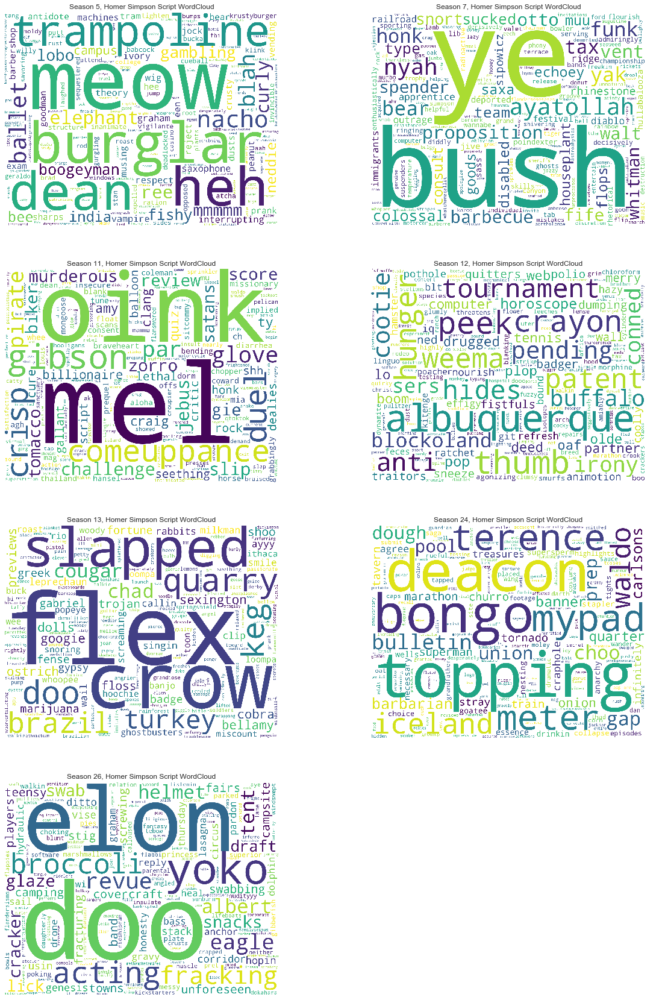

In [158]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(homer_wc_dict[5])
ax[0,0].set_title("Season {}, Homer Simpson Script WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(homer_wc_dict[7])
ax[0,1].set_title("Season {}, Homer Simpson Script WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(homer_wc_dict[11])
ax[1,0].set_title("Season {}, Homer Simpson Script WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(homer_wc_dict[12])
ax[1,1].set_title("Season {}, Homer Simpson Script WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(homer_wc_dict[13])
ax[2,0].set_title("Season {}, Homer Simpson Script WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(homer_wc_dict[24])
ax[2,1].set_title("Season {}, Homer Simpson Script WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(homer_wc_dict[26])
ax[3,0].set_title("Season {}, Homer Simpson Script WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

In [159]:
# Sort the dictionaries to ease the plotting
# SEASON 5
s5 = dict(sorted(main_chars_tf_idf['Homer Simpson'][5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(main_chars_tf_idf['Homer Simpson'][7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(main_chars_tf_idf['Homer Simpson'][11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(main_chars_tf_idf['Homer Simpson'][12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(main_chars_tf_idf['Homer Simpson'][13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(main_chars_tf_idf['Homer Simpson'][24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(main_chars_tf_idf['Homer Simpson'][26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

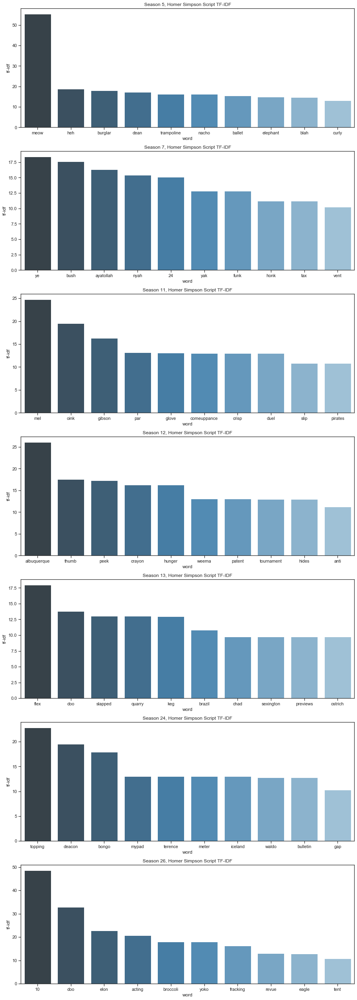

In [160]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Homer Simpson Script TF-IDF".format(5))
ax2.set_title("Season {}, Homer Simpson Script TF-IDF".format(7))
ax3.set_title("Season {}, Homer Simpson Script TF-IDF".format(11))
ax4.set_title("Season {}, Homer Simpson Script TF-IDF".format(12))
ax5.set_title("Season {}, Homer Simpson Script TF-IDF".format(13))
ax6.set_title("Season {}, Homer Simpson Script TF-IDF".format(24))
ax7.set_title("Season {}, Homer Simpson Script TF-IDF".format(26))

plt.show()

The first thing to notice here is that a lot of the words match the main themes of the respective season. This is logical also thinking that Homer is one of the main characters and the most speaking one and thus contributes a lot to the finding of the themes in the previous iterations of the analysis.

Following the previous observation there is no real comparison one could do in this case of the different language Homes uses. It is then how important or frivolus the topics he talks about are.

First thing to notice is that words that distinguish the various seasons wrt Homer are mostly pretty short, which usually reflects on the words to be common and easy, while long and elaborate words are more complex. This usage suites Homer's character since he is supposed to be simple-minded.

In season 11 it can be seen that he is an absolute protagonist: he gets along **mel gibson** and challenges people to **duel** with a **glove** in the tomacco episode. These findings perfectly overlap with the previous ones.

This can be seen as well in season 5, with **meow**, **burglar**, **elephant**. The important observation is then that Homer is very relevant in the best rated season. Still he is very central in a "declining" season as well, such as the 11th.

In season 7 instead there are a lot of silly behaviours by Homer, highlighted by **nyah**, used to joke on the children and **ayatollah** is used in a joke as well.

**albuquerque** and **crayon** seem to be the only big contribution for season 12's TF-IDF. The other words do not seem to hold any more information.

The same goes for season 13, in which there is not match between the distinguishing themes found before and what Homer talks of. **flex**, **doo** and **slapped** as most simbolic words, although, seem pretty silly words, which means that probably Homer has not changed his behaviours until this point.

It seems that he hasn't changed his behaviours in the last seasons as well, **doo** reappearing in season 26, in which he speaks a lot with **elon** Musk. In this season though he looks a bit more central having **fracking** and **broccoli** along with **elon** in common with the top scoring words in the scripts.

Overall it can be said the data has no real evidence to say Homer's behaviours changed a lot during time. Still, judging by the matches with the most relevant themes emerged from the TF-IDF scripts analysis it can be seen how his role gets less central as the seasons go on.

#### 3.1.3.2 Marge Simpson<a class="anchor" id="three.one.three.two"></a>

The computation is the same as in the cases before.

In [161]:
marge_scripts_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in main_chars_tf_idf['Marge Simpson'][s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    marge_scripts_ready[s] = ' '.join(tmp)

In [162]:
# Dictionary containing all the WordClouds
marge_wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    marge_wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(marge_scripts_ready[s])

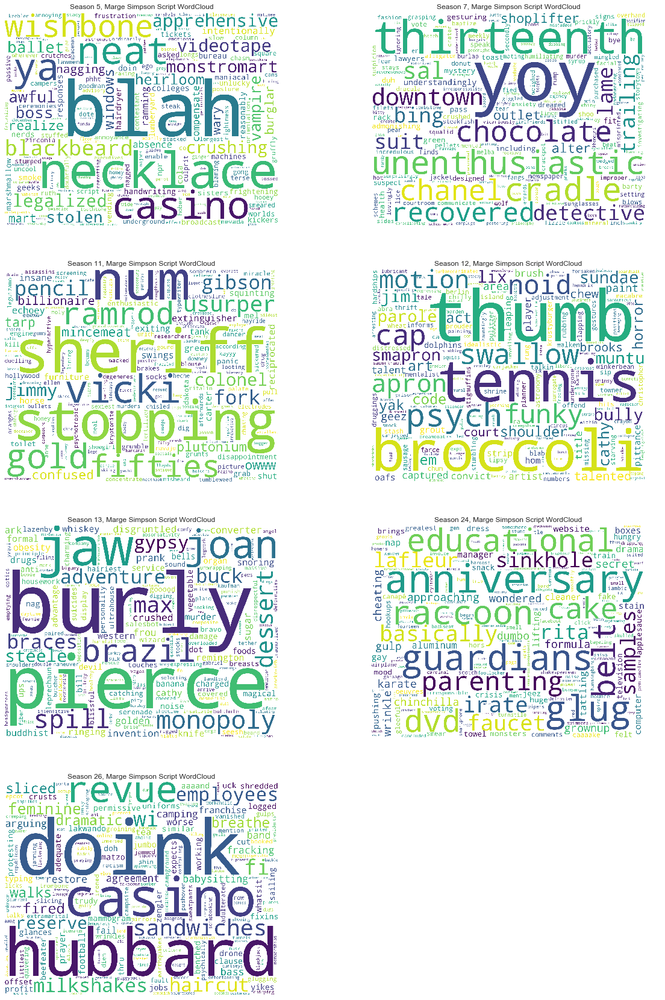

In [163]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(marge_wc_dict[5])
ax[0,0].set_title("Season {}, Marge Simpson Script WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(marge_wc_dict[7])
ax[0,1].set_title("Season {}, Marge Simpson Script WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(marge_wc_dict[11])
ax[1,0].set_title("Season {}, Marge Simpson Script WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(marge_wc_dict[12])
ax[1,1].set_title("Season {}, Marge Simpson Script WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(marge_wc_dict[13])
ax[2,0].set_title("Season {}, Marge Simpson Script WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(marge_wc_dict[24])
ax[2,1].set_title("Season {}, Marge Simpson Script WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(marge_wc_dict[26])
ax[3,0].set_title("Season {}, Marge Simpson Script WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

In [164]:
# Sort the dictionaries to ease the plotting
# SEASON 5
s5 = dict(sorted(main_chars_tf_idf['Marge Simpson'][5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(main_chars_tf_idf['Marge Simpson'][7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(main_chars_tf_idf['Marge Simpson'][11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(main_chars_tf_idf['Marge Simpson'][12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(main_chars_tf_idf['Marge Simpson'][13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(main_chars_tf_idf['Marge Simpson'][24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(main_chars_tf_idf['Marge Simpson'][26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

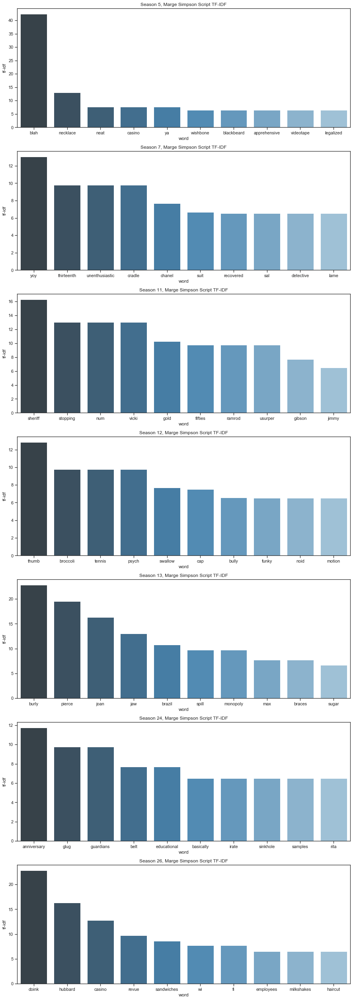

In [165]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Marge Simpson Script TF-IDF".format(5))
ax2.set_title("Season {}, Marge Simpson Script TF-IDF".format(7))
ax3.set_title("Season {}, Marge Simpson Script TF-IDF".format(11))
ax4.set_title("Season {}, Marge Simpson Script TF-IDF".format(12))
ax5.set_title("Season {}, Marge Simpson Script TF-IDF".format(13))
ax6.set_title("Season {}, Marge Simpson Script TF-IDF".format(24))
ax7.set_title("Season {}, Marge Simpson Script TF-IDF".format(26))

plt.show()

For Marge the straight observation is how high in season 5 is the word **blah**, a simple word, probably used very commonly when arguing with the children. The second word is **necklace**, making strong the stereotype on women liking jewels.

This happens again in season 7 with **chanel**, along with another not meaningful word such as **yay** as top scoring one. Also the other words seem to not have a strong connection with the main themes of the season.

For the intermediate seasons (11, 12, 13) there is nothing really relevant wrt to the main themes. In season 12 **broccoli** and **swallow** probably refer to dialogues had with her children, since making them eat vegetables is very typical of a mother: this remains an educative moment for people's alimentary habits. Still thanks to **thumb** we know she gets a bit more into the action, even if just by cutting Homer's thumb off. Her and Homer start playing **tennis**, becoming popular in town together. Still **burly**, attractive male mascot for Burly paper towel, in season 13 keeps Marge a bit far from the show light, being attracted by the mascot, but then fooled by the male members of her own family.

Finally in the last two seasons in which Marge is expected to have a bigger role, following the previous chapters' analysis. Still there are no real matches with the distinctive themes of the season.

There is though a lot of action around her, more than the previous seasons it seems, starting from the **anniversary** of her wedding with Homer in season 24. **educational** and **glug** then refer to her mother duties, always present, the latter referring to the act of suckling Maggie. **guardians** refers to this as well: after surviving a tornado Marge and Homer seek for guardians to protect their children.

The first word is **doink** in season 26, which refers to Marge complaining about Homer playing the bass, and that is the first time it can be observed this behaviour from Marge in this analysis. She also finds success with **sandwiches**, so much that she opens a franchise with a company, coming from **hubbard**: *Mother Hubbard's Sandwich Cupboard*.

It can be stated that Marge stands out a bit from her mother role after the first seasons, being envolved more with the action, but at the end she doesn't seem too central in distinguishing topics of the seasons. Still her character and characterization seems stronger in the last seasons, even though she has always been a strong woman.

From the analysis looks like her role as a mother is also becoming more central in the action and more dynamic, not just remaining in the house, but even acting to protect her children.

This importance growth seem to not have been perceived well by the audience, by seeing the raise of Marge during the worst seasons. It seems like the public preferred Marge to stay more in a classical mother role.

### 3.1.3.3 Bart Simpson<a class="anchor" id="three.one.three.three"></a>

The computation is the same as in the cases before.

In [166]:
bart_scripts_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in main_chars_tf_idf['Bart Simpson'][s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    bart_scripts_ready[s] = ' '.join(tmp)

In [167]:
# Dictionary containing all the WordClouds
bart_wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    bart_wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(bart_scripts_ready[s])

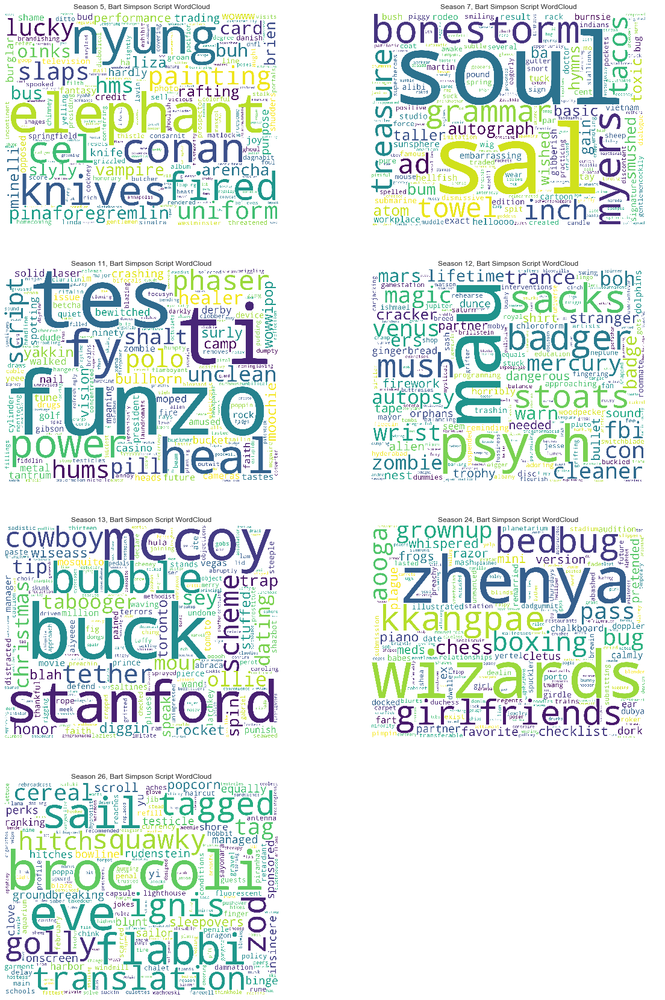

In [168]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(bart_wc_dict[5])
ax[0,0].set_title("Season {}, Bart Simpson Script WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(bart_wc_dict[7])
ax[0,1].set_title("Season {}, Bart Simpson Script WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(bart_wc_dict[11])
ax[1,0].set_title("Season {}, Bart Simpson Script WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(bart_wc_dict[12])
ax[1,1].set_title("Season {}, Bart Simpson Script WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(bart_wc_dict[13])
ax[2,0].set_title("Season {}, Bart Simpson Script WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(bart_wc_dict[24])
ax[2,1].set_title("Season {}, Bart Simpson Script WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(bart_wc_dict[26])
ax[3,0].set_title("Season {}, Bart Simpson Script WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

In [169]:
# Sort the dictionaries to ease the plotting
# SEASON 5
s5 = dict(sorted(main_chars_tf_idf['Bart Simpson'][5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(main_chars_tf_idf['Bart Simpson'][7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(main_chars_tf_idf['Bart Simpson'][11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(main_chars_tf_idf['Bart Simpson'][12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(main_chars_tf_idf['Bart Simpson'][13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(main_chars_tf_idf['Bart Simpson'][24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(main_chars_tf_idf['Bart Simpson'][26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

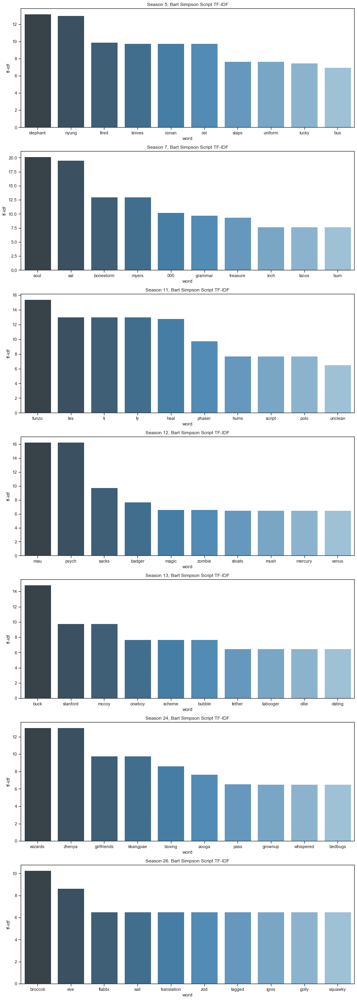

In [170]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Bart Simpson Script TF-IDF".format(5))
ax2.set_title("Season {}, Bart Simpson Script TF-IDF".format(7))
ax3.set_title("Season {}, Bart Simpson Script TF-IDF".format(11))
ax4.set_title("Season {}, Bart Simpson Script TF-IDF".format(12))
ax5.set_title("Season {}, Bart Simpson Script TF-IDF".format(13))
ax6.set_title("Season {}, Bart Simpson Script TF-IDF".format(24))
ax7.set_title("Season {}, Bart Simpson Script TF-IDF".format(26))

plt.show()

The first word in season 5 for Bart is **elephant**, because he owned an elephant in that season, projecting him directly into the action, since it is one of the most distinguishing themes. The other indicating word is **conan**, name of the conductor of the program *Late Night with Conan O'Brien* (actually a real Show), where Bart goes to give an interview after becoming famous. Other than this two Bart seems to not have any other big role in distinguishing facts.

**myers** sets Bart as the center of the action once again, in the episode where he helps Roger Meyers (or Myers) to be accredited for the invention o fhte Itchy & Scratchy show. Like that **treasure** as well refers to the treasure Bart and Granpa have to find, also discussed earlier. In this seasons' Halloween dedicated episode it's Bart that tells three scary stories: one is about Homer selling his **soul**.

In season 11 Bart seem to have less relevant topics, the main one being involved in the **funzo** toy episode. The other top words do not hold a lot of information.

Season 12 has some interesting words in it. **mau** is just a slang borrowed from Vietnamese that Bart uses to sound military while bullying Skinner: the meaning is *hurry up*. This follows the previous analysis, in which it was found out that Bart was involved in a marine slogan. **sacks** probably refers to that episode as well. **badger** instead refers to an animal, which takes home in their dog's doghouse: the family is forced to call animal control. This is confirming that environment and animals safeguard is important in season 12. **magic** refers to Bart wanting to learn it and buying a magic kit: this is the first time this theme is encountered in the analysis. 

**buck** **mccoy**, or better *Buck McCoy* is as discussed before a **cowboy** star and he is the target of a never seen before Bart generosity: this because Buck was a star to him as well and the boy tries to help him out. This happens in season 13. There is also evidence of Bart keeping his mocking attitude, taunting Lisa with **stanford** multiple times, saying she's never gonna go to the school of her dreams.

In season 24 important for Bart is **girlfriends**, because even just mentioning it means he is slowly growing and start to confront himself with the opposite sex. Even more when he meets **zhenya**, a beautiful russian girl, with whom he is infatuated, at the point of taking piano lessons from her. **grownup** can refer to adults, but could also be what Bart becomes to define himself because of this.

As said in the script analysis, **broccoli** and **sail** are important because they are a breakpoint in the relationship between Bart and Homer, with Marge having to intervene for it, sending them to the Relation Ship: even if the fight with his father might be a sign of growth, becoming an even more problematic teenager, the reason behind the fight (not eating broccoli) is still pretty childish. To bring evidence on that is **flabbi** that could be used as *flabby*, a word that for sure Bart uses to mock around. To change the relationship again there is **golly**, standing for *Sven Golly*, an hypnotist that makes Homer believe he is 10 years old, becoming short after the new Bart's best friend.

While with Marge it cannot be seen a big involvement into action, with Bart, with big themes at first and still a lot of important appearences during the decline, it can be stated that there's a lot of action going on, he always putting himself into troubles or putting other people into trouble as well.

For what concerns the character Bart is still a boy and so he is staying true to his rebel character, even though in the declining seasons there has been some personal growth in him (for example generosity in season 13). The biggest growing is evident in season 24, where he has interest into girls. Since the ratings have been going down it might be that the first natural Bart character was the most liked by the public.

Also it is interesting to notice how until this point the male family members have still a predominant role wrt to Marge.

### 3.1.3.4 Lisa Simpson<a class="anchor" id="three.one.three.four"></a>

The computation is the same as in the cases before.

In [171]:
lisa_scripts_ready = {}

# Create vectors with frequency counted by TF-IDF measures
for s in analyze_seasons:
    # Support list
    tmp = []
    
    # Append words to tmp wrt their TF-IDF score
    for word, tfidf in main_chars_tf_idf['Lisa Simpson'][s].items():
        for i in range(int(tfidf)):
            tmp.append(word)
    
    # Now append the ready text to the seasons dictionary
    lisa_scripts_ready[s] = ' '.join(tmp)

In [172]:
# Dictionary containing all the WordClouds
lisa_wc_dict = {}

# Cycle on all seasons ready
for s in analyze_seasons:
    lisa_wc_dict[s] = WordCloud(background_color='white', width=1800, height=1400,
                           collocations=False).generate(lisa_scripts_ready[s])

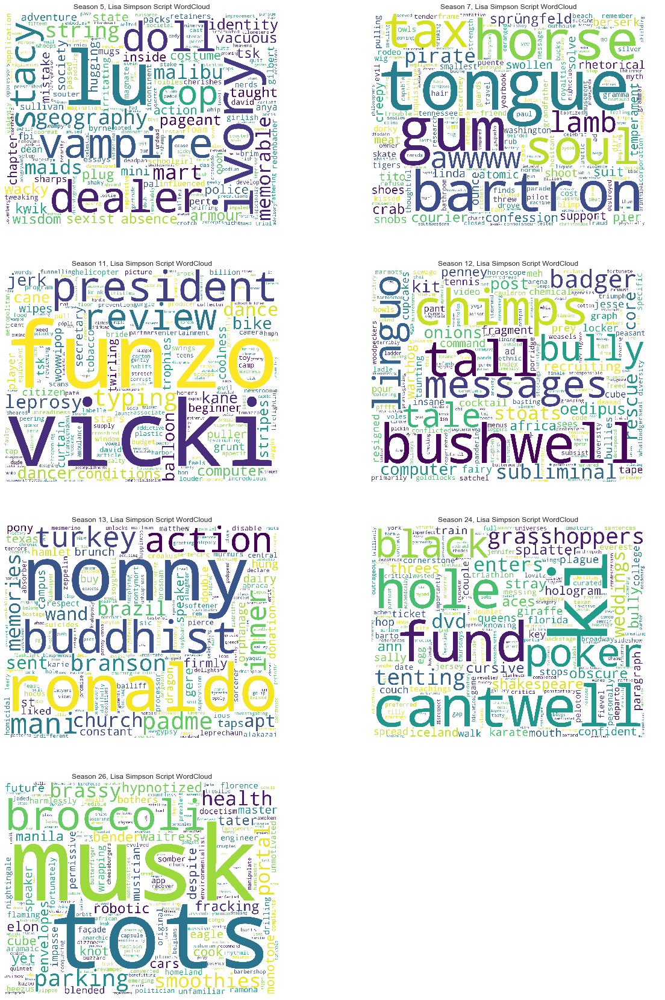

In [173]:
# Plot the wordclouds
fig, ax = plt.subplots(4,2, figsize=(20, 30))

# Now plot all the WordClouds
# To not mess up we'll do every season plot without automation
# SEASON 5
ax[0,0].imshow(lisa_wc_dict[5])
ax[0,0].set_title("Season {}, Lisa Simpson Script WordCloud".format(5))
ax[0,0].axis('off')

# SEASON 7
ax[0,1].imshow(lisa_wc_dict[7])
ax[0,1].set_title("Season {}, Lisa Simpson Script WordCloud".format(7))
ax[0,1].axis('off')

# SEASON 11
ax[1,0].imshow(lisa_wc_dict[11])
ax[1,0].set_title("Season {}, Lisa Simpson Script WordCloud".format(11))
ax[1,0].axis('off')

# SEASON 12
ax[1,1].imshow(lisa_wc_dict[12])
ax[1,1].set_title("Season {}, Lisa Simpson Script WordCloud".format(12))
ax[1,1].axis('off')

# SEASON 13
ax[2,0].imshow(lisa_wc_dict[13])
ax[2,0].set_title("Season {}, Lisa Simpson Script WordCloud".format(13))
ax[2,0].axis('off')

# SEASON 24
ax[2,1].imshow(lisa_wc_dict[24])
ax[2,1].set_title("Season {}, Lisa Simpson Script WordCloud".format(24))
ax[2,1].axis('off')

# SEASON 26
ax[3,0].imshow(lisa_wc_dict[26])
ax[3,0].set_title("Season {}, Lisa Simpson Script WordCloud".format(26))
ax[3,0].axis('off')

# Since there's an empty slot delete its axis
ax[3,1].axis('off')
        
plt.show()

In [174]:
# Sort the dictionaries to ease the plotting
# SEASON 5
s5 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][5].items(), reverse=True, key=lambda x: x[1]))
s5 = pd.DataFrame.from_dict(s5, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 7
s7 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][7].items(), reverse=True, key=lambda x: x[1]))
s7 = pd.DataFrame.from_dict(s7, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 11
s11 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][11].items(), reverse=True, key=lambda x: x[1]))
s11 = pd.DataFrame.from_dict(s11, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 12
s12 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][12].items(), reverse=True, key=lambda x: x[1]))
s12 = pd.DataFrame.from_dict(s12, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 13
s13 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][13].items(), reverse=True, key=lambda x: x[1]))
s13 = pd.DataFrame.from_dict(s13, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 24
s24 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][24].items(), reverse=True, key=lambda x: x[1]))
s24 = pd.DataFrame.from_dict(s24, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

# SEASON 26
s26 = dict(sorted(main_chars_tf_idf['Lisa Simpson'][26].items(), reverse=True, key=lambda x: x[1]))
s26 = pd.DataFrame.from_dict(s26, orient='index').reset_index().rename(columns={'index':'word', 0:'tf-idf'})

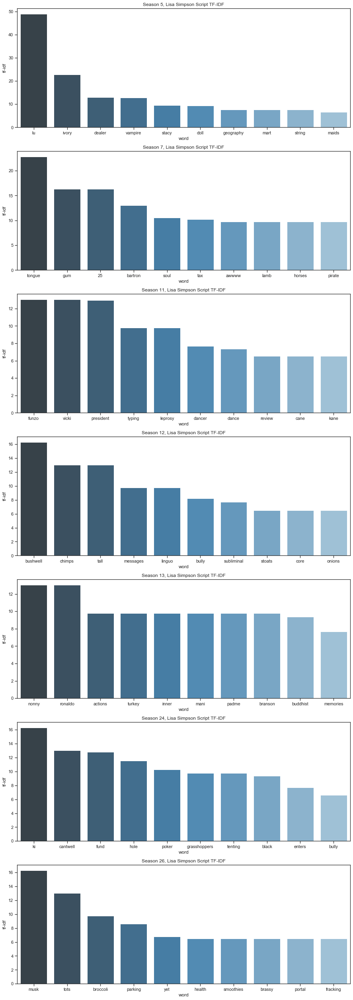

In [175]:
# Instantiate the figure with the various subplots
fig = plt.figure(figsize=(15,45))
ax1 = fig.add_subplot(711)
ax2 = fig.add_subplot(712)
ax3 = fig.add_subplot(713)
ax4 = fig.add_subplot(714)
ax5 = fig.add_subplot(715)
ax6 = fig.add_subplot(716)
ax7 = fig.add_subplot(717)
                                                                                       
# Create the barplots with the data
sns.barplot(x='word', y='tf-idf', data=s5.head(10), ax=ax1, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s7.head(10), ax=ax2, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s11.head(10), ax=ax3, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s12.head(10), ax=ax4, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s13.head(10), ax=ax5, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s24.head(10), ax=ax6, palette='Blues_d')
sns.barplot(x='word', y='tf-idf', data=s26.head(10), ax=ax7, palette='Blues_d')

# Set plot titles
ax1.set_title("Season {}, Lisa Simpson Script TF-IDF".format(5))
ax2.set_title("Season {}, Lisa Simpson Script TF-IDF".format(7))
ax3.set_title("Season {}, Lisa Simpson Script TF-IDF".format(11))
ax4.set_title("Season {}, Lisa Simpson Script TF-IDF".format(12))
ax5.set_title("Season {}, Lisa Simpson Script TF-IDF".format(13))
ax6.set_title("Season {}, Lisa Simpson Script TF-IDF".format(24))
ax7.set_title("Season {}, Lisa Simpson Script TF-IDF".format(26))

plt.show()

Season 5 is not one in which Lisa doesn't look too central, apart from the **stacy doll** episode. She talk a lot in the elephant episode as well, as **ivory** and **dealer** suggest.

With **tongue** in season 7 Lisa is for the second time in this analysis the absolute protagonist of the episode, one in which she discovers the truth about Jebediah Springlfield and wants to demonstrate everyone the truth, as Lisa's open mind does not always realize how that might negatively effect the town. To do that she had to show that Jebediah had a silver tongue, but after finding out it was stolen she finally realizes how the man's heritage inspired a lot of people and decides to keep the truth a secret. This is a behaviour that who watches the show can certainly find in Lisa: she always wants to know the truth or discover something and she wants to sare as well, sometimes, though, imposing herself in an almost violent manner, just to discover at the end that sometimes it's better leave people with  their beliefs. After this **gum** refers to Lisa being bullied by Bart, who attaches a gum to her hairs: this bullying is another thing happening frequently in the show. Another typical seeing is her love for animals as **lamb** and **horse** especially demonstrate. It looks like Lisa's character is built up very well in this season.

In season 11 she finds space in the main topic of **funzo**, the toy build with children's ideas. It is shown even the artistic side of Lisa, bringing in **dance**, **dancer** and **vicki**, who is a dance teacher: here it can be seen the volatile nature of some of Lisa's interest, because she gets inspired to join the dance just right after having seen a movie about it. **president** is there because of a jump into the future, where Lisa has but her abilities to work and she has become the president of the US: this shows that all the effort she is putting into knowledge will be rewarded. **leprosy** is a bit of a change because she is the pranker this time, making Bart and Homer believe they have leprosy to better control them while Marge is in the hospital.

Season 12 is the best one between the middle seasons and then Lisa can be expected to not have big roles: in fact the top word is **bushwell**, just related to the Halloween special. Apart from that she seems to actually have active roles, not quite what was expected. The animal topic comes in this season, with **chimps**, appearing in an episode in which the family goes to a safari and finds monkeys mining diamonds and saves them: once again animal appearing in this season seems that it's the most liked topic by the audience when it comes to environment. **subliminal** refers to another main topic, which was the message Bart had in his band's song telling to join the navy, which Lisa discovers: this is, though, the only role she plays in that episode. **linguo** refers to a grammar robot Lisa invented and she shares the main role of the episode with Homer and Bart, each one having a segment showing their day.

The decline begins again in season 13, right away with a revisitation of Hamlet, in which a distinctive word seems to be **nonny**, not meaningful in itself, but used in refrains: this artistic side is then not well perceived by the audience. Another theme that is ethic but not very interesting to the audience is the adoption Lisa did in Brazil, of an orphan named **ronaldo**, who's gone missing: that's the reason that sets the family in motion and travel to Brazil, Lisa having the lead of the expedition. **turkey**, even if for thanksgiving, brings back once again the love Lisa has for animals and the horror in killing and eating them a lot. She brings up the religious theme as well, being **padme** a part of a tibetan buddhist chant: not really of interest to the audience.

In season 24 it still cannot be seen a big match between Lisa's distinctive words and the most distinctive words of the season. There is the obsession of Lisa with a tv show here, **ki**-Ya, together with her brother: this is strange wrt her character because the show is about cretures using karate to fight. There is then **cantwell**, or better *Miss Cantwell*, the substitute teacher that seem to hate Lisa: this is another episode very dedicated to women, something that's emerging in this analysis to not be very liked by the audience. Again she is in the center of the action when Homer puts her **fund** for the college into online **poker**: she has then to be the woman who gets back what the man has taken away from her (which sounds very feminist) by becoming a poker player.

Finally in season 26 she is involved as well with **elon** musk, a figure she most definetly looks at as an example. She is involved in the main topic of Mr. Burn's **fracking** as well as the **broccoli** episode (even if probably not a lot since this is more focused on the male characters of the family) which also is connected to the word **smoothies**. From the rise Lisa was undergoing maybe more central roles were expected for her in this season. 

Looks like Lisa's character is more constantly into the main action than his mother, but there is definetly a rise of her role in the lastest seasons. Her interests remain pretty much the same during the seasons, same as her character, but from season to season there is one that stands out.

In season 11, which is a very declining one she has big roles and her character is expanded even more: this complies with the rise of female and a bit of decline of male characters, which seems connected with the declining of the show. It is a big unexpected, though, that she has big roles in season 12, where the rating was going a bit up again.

## 3.1.4 Summary of Findings<a class="anchor" id="three.one.four"></a>

It is not easy at first sight to find patterns in the main topics and it was often necessary to delve deep in which episode the found words were to gather information. Still, all the various analysis have big points in common: most of what was found in the synopsis analysis is confirmed and expanded by the scripts one.

The topics, in general, have been evolving and following what was happening in that particular historic period when the season was aired, even if their arguments are the same. An example is how the **environmental** and **political** and **ethical** issues were more marginal in the first seasons and then gained more space during time and followed the dire situation the world was experiencing.

This late rise, may arise the suspicion that the show went from representing a parody of a typical american family to educate people on the current relevant hot topics. This might have beeen seen by fans as a forced introduction into the show, changing its nature and so lowering its value. Another possible explanation is just that the few political topics in the first seasons were presented in a different and in a way that better suited the interest of the audience.

In fact looks like people are not liking a lot the **environmental** issues, presented in a more pervasive after season 10, probably because they feel like it's a distant problem: vice-versa immigration of season 7 seems to affect them in a more direct way. This, though, is in contrast with season 5 that exposes the safeguard of animals problem: maybe animated beings have more value to people than plants, or maybe that season was simply very appreciated that this topic didn't affect it too much.

The **military** instead seems to be a well perceived and important argument to the audience: this can be understood by looking at how much americans feel the importance of having a respected army. Along with this Granpa Abe seems to gain a more relevance as the seasons go on, to the point of having some episodes focused on him. This, on the contrary wrt the military topic, has not brought a lot of interest in the show, since we can see how many episodes are focused on Granpa in the latest series: the audience may perceive having the focus this much on an old character and flashbacks as boring or not too interesting.

Also a **religious** topic is exposed, but it is likely not really appreciated as it appears in one of the worst seasons.

Another of the good perceived topics is instead **music**, more than arts in general, as for example it plays a big role in distinguishing season 5 with Homer's quartet.

There is also the need to confront this with the audience graphs. Both male adults and teens ratings did decrease a lot during the years. This happens for the female audience as well, but more aged women (45+) do give higher scores to some of the lastest seasons. This is probably because of the introduction of more appealing topics for them: the nigerian princess in season 26, given a lot of power and the quest to negotiate with a powerful buisnessman is a clear example of this. Still the number of these viewers is not enough to stop the drop of the rating.

For the characters, starting with **Homer**, the thing to notice is that words that distinguish the various seasons are mostly pretty short, which usually reflects on the words to be common and easy, while long and elaborate words are more complex. This usage suites Homer's character since he is supposed to be simple-minded. Overall it can be said the data has no real evidence to say Homer's behaviours changed a lot during time. Still, judging by the matches with the most relevant themes emerged from the TF-IDF scripts analysis it can be seen how his role is the most central in the main arguments, but it gets less central as the seasons go on.

It can be stated that **Marge** stands out a bit from her role of mother and typical woman after the first seasons, being involved more with the action, but at the end she doesn't seem too central in distinguishing topics of the seasons. Still her character and characterization seems stronger in the last seasons, even though she has always been a strong woman. From the analysis looks like her role as a mother is also becoming more central in the action and more dynamic, not just remaining in the house, but even acting in dangerous situations to protect her children. This importance growth seem to not have been perceived well by the audience, by seeing the raise of Marge during the worst seasons. It seems like the public preferred Marge to stay more in a classical mother role.

While with Marge a big involvement into action cannot be seen, for **Bart**, with big themes at first and still a lot of important appearences during the decline, it can be stated that there's a lot of action going on, he always putting himself into troubles or putting other people into trouble as well. For what concerns the character Bart is still a boy and so he is staying true to his rebel character, even though in the declining seasons there has been some personal growth in him (for example generosity in season 13). The biggest growing is evident in season 24, where he has interest into girls. Since the ratings have been going down it might be that the first natural Bart character was the most liked by the public.

Looks like **Lisa**'s character is more constantly into the main action wrt his mother, but there is definetly a rise of her role in the lastest seasons. Her interests remain pretty much the same during the seasons, same as her character, but from season to season there is one that stands out. In season 11, which is a very declining one she has big roles and her character is expanded even more: this complies with the rise of female and a bit of decline of male characters, which seems connected with the declining of the show. It is a big unexpected, though, that she has big roles in season 12, where the rating was going a bit up again. Important is her connection with the environment

To wrap-up, there are no big changes, but small constant ones, not just in the arguments that adapt during time, but also in the way the topics are treated, that have brought the show from being called "the best show ever" to the low rating it has now.

## 3.2 Sentimental Analysis <a class="anchor" id="three.two"></a>

To be able to look into the sentiments of scripts and synopsis a datafile with 10,222 words and their happiness score is used. 

The data is from the paper *Emporal Patterns of Happiness and Information in a Global Social Network: Hedonometrics and Twitter*

In [5]:
labMT = pd.read_excel('data.xlsx')

In [6]:
labMT.head(5)

,word,happiness_rank,happiness_average,happiness_standard_deviation,twitter_rank,google_rank,nyt_rank,lyrics_rank
0,laughter,1,8.50,0.9313,3600,--,--,1728
1,happiness,2,8.44,0.9723,1853,2458,--,1230
2,love,3,8.42,1.1082,25,317,328,23
3,happy,4,8.30,0.9949,65,1372,1313,375
4,laughed,5,8.26,1.1572,3334,3542,--,2332


In [7]:
labMT[labMT['word']=='laughter']['happiness_average'].values[0]

8.5

**A function that calculates sentiment given a list of tokens, as the mean sentimentscore of words in a text.** 


Note that here the seniment score is calculated as the sum of the sentiment values devided by the number of words that have a sentiment value. This means that the total sentiment value is the average of the sentiment values given, where words that don't have a sentiment value from the list are not considered.

In [8]:
'''
Calculates the averagesentiment given a list of tokens based on Data Set S1 from
"Temporal Patterns of Happiness and Information in a Global Social Network: Hedonometrics and Twitter"

parameters: tokens - a list of tokens
returns: int - The average amount of each token's "happiness_average" 

'''

def get_sentiment(tokens):
  #  print(len(tokens))
    values = []
    words = [word for word in labMT['word']]
    for token in tokens:
        #print("hello"+token)
        token_val = 0
        token = token.lower()
        if(token in words):
            token_val = labMT[labMT['word']==token]['happiness_average'].values[0]
            values.append(token_val)
    #print(values)
    #print(np.sum(values))
   # print(len(values))
    sentiment = np.sum(values)/len(values)
    return sentiment

**The data needed for the Sentimental Analysis is the scripts.**

In [9]:
scripts = pd.read_csv("script_extended.csv")

The data holds a column for *lines spoken*: 

In [10]:
scripts[scripts["speaking_line"] == False]

,Unnamed: 0,episode_id,number,raw_text,speaking_line,raw_character_text,raw_location_text,spoken_words,normalized_text,episode_name,no_overall,season,no_in_season
8,8,32,225,(Springfield Elementary School: EXT. ELEMENTAR...,False,NaN,Springfield Elementary School,NaN,NaN,Lisa's Substitute,32,2,19
19,19,32,236,Bart Simpson: (ANGUISHED SCREAM),False,Bart Simpson,Springfield Elementary School,NaN,NaN,Lisa's Substitute,32,2,19
21,21,263,106,(Moe's Tavern: Int. Moe's - evening),False,NaN,Moe's Tavern,NaN,NaN,"Hungry, Hungry Homer",263,12,15
24,24,32,217,(Apartment Building: Ext. apartment building -...,False,NaN,Apartment Building,NaN,NaN,Lisa's Substitute,32,2,19
35,35,32,243,(Train Station: int. train station - afternoon),False,NaN,Train Station,NaN,NaN,Lisa's Substitute,32,2,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...
131024,131024,505,11,(CRUISE SHIP: ext. cruise ship - deck - contin...,False,NaN,CRUISE SHIP,NaN,NaN,A Totally Fun Thing That Bart Will Never Do Again,505,23,19
131029,131029,505,16,(Simpson Home: int. simpson house - Master bed...,False,NaN,Simpson Home,NaN,NaN,A Totally Fun Thing That Bart Will Never Do Again,505,23,19
131043,131043,505,29,Moe Szyslak: (TEETH-CRUNCHING NOISES),False,Moe Szyslak,Simpson Home,NaN,NaN,A Totally Fun Thing That Bart Will Never Do Again,505,23,19
131067,131067,505,52,(Highway: ext. highway - day - later),False,NaN,Highway,NaN,NaN,A Totally Fun Thing That Bart Will Never Do Again,505,23,19


By looking into the dataframe it can be seen that the non speaking text doesn't make sence for the sentimental analysis. It it mostly decribing places. Some of the lines decribe feeling or responses to event, fx. "Gasp of Joy" and "Annoyed Grunt". In the dataset, the `speaking_line` column will be `Null` for these kind of events. 

### 3.2.1 Sentimental Analysis for the Seasons  <a class="anchor" id="three.two.one"></a>

Here, the sentimental value for the scripts for each season is analyzed and the change in sentimental value and how it has developed over the last 30 years is visualized. 

Here, the words spoken will be used. Since the scripts for seasons 27-30 are not available we only look at the first 26 seasons.

**Create a list of words spoken, from the script dataframe, using the normalized_text columnn.**

In [11]:
season = []

for i in range(1,27):
    text = list(scripts[scripts["season"] == i]["normalized_text"]) #take the normalized text from the scripts dataframe in a specified season
    text = [x for x in text if str(x) != 'nan']  #clear out all the nans
    text = "".join(text) #get one string with all the text
    text = text.split(" ") #split the words up to strings in a list
    season.append(text)  #save the text for one season into a list 

**Calculate the sentiment score for each season and plot it with the ratings.**

In [12]:
sentiment_season = []

for sublist in season:
    sentiment = get_sentiment(sublist)
    sentiment_season.append(sentiment)

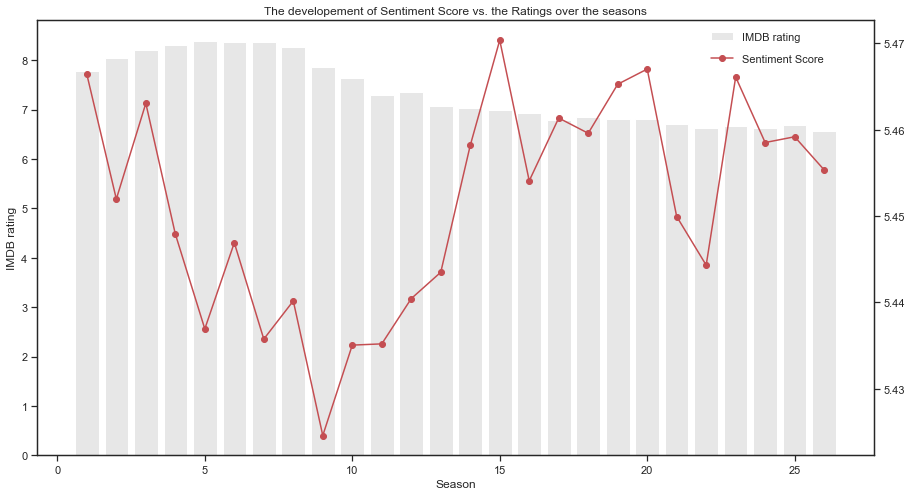

In [49]:
seasons = list(range(1,27)) # create a list for the seasons which are 26

#first axis
fig, ax = plt.subplots(figsize=(15,8))

plt.title("The developement of Sentiment Score vs. the Ratings over the seasons")
plt.bar(seasons,df_episodes_ratings.groupby('season').mean()['IMDB rating'].iloc[0:26], label = "IMDB rating", color=(0.1, 0.1, 0.1, 0.1) )
plt.ylabel("IMDB rating")
plt.xlabel("Season")
L = ax.legend(loc=(.80,0.94), frameon = False)
L.get_texts()[0].set_text("IMDB rating")
#ax.tick_params(range(1,27), colors='r')

#second axis
ax2 = ax.twinx()
plt.plot(seasons, sentiment_season, "r", label = "Sentiment Scores", marker = "o")
ax2.legend()
L = ax2.legend(loc=(.80,.89), frameon = False)
L.get_texts()[0].set_text("Sentiment Score")

Here it can be seen that the sentiment score of the seasons changes from 5.42 to 5.47 for the first 26 seasons. For the first 9 seasons there seems to be a downwards ternd in the sentiment score while the ratings are getting higher. From season 10 to 15 there is an upward trend while the ratings are getting lower. Then the sentiment score becomes seady for the rest of the seasons. This hints that there is a correlation between the ratings and the sentiment score.

**Calculate the correlation between the ratings and sentiment score.**

In [50]:
ratings = df_episodes_ratings.groupby('season').mean()['IMDB rating'].iloc[0:26]

# Normalise X and Y
sentiment_season -= np.mean(sentiment_season)
ratings -= np.mean(ratings)
# Standardise X and Y
sentiment_season /= sentiment_season.std(0)
ratings /= ratings.std(0)

pg.corr(x=ratings, y=sentiment_season )

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,26,-0.484,"[-0.73, -0.12]",0.234,0.167,0.012281,4.753,0.73


The results are that there is a negative correlation of -0.483 which is quite high. The 95\% confidence interval does not include 0 which confirmes that the null hypothesis that the correlation is 0 can be rejected. 

**Plot the sentiment score and the regression of it to see if there is a trend.**

In [51]:
#Store the sentiment values in a dataframe
sent_dataf_2 = pd.DataFrame(index = list(range(1,27)), columns = ["Season","Sentiment_score"]) #create an empty dataframe
sent_dataf_2["Season"] = list(range(1,27))
sent_dataf_2["Sentiment_score"] = sentiment_season

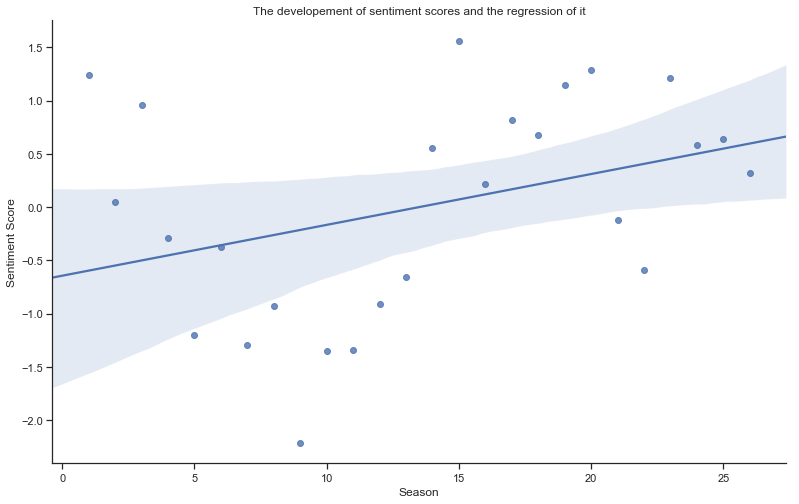

In [52]:
sns.lmplot(x = "Season", y = "Sentiment_score", data=sent_dataf_2, height = 7, aspect=1.6)
plt.title("The developement of sentiment scores and the regression of it")
plt.xlabel('Season')
plt.ylabel('Sentiment Score')
plt.show()

Here it can be seen that there is an upwards trend in the sentimental score throughout the seasons. This tells us that the spoken words throughtout the seasons are becoming happier, while the ratings and number of viewers are falling. This could indicate that the viewers of the simpsons like dark humor.

### 3.2.2 Sentiment Analysis of each Caracter in each Season <a class="anchor" id="three.two.three"></a>
Here we look at how the sentiment scores of each of the main character has developed through the seasons. We only look at the top 20 speaking characters. Again we only look at the first 26 seasons.

In [53]:
count_lines = scripts.groupby("raw_character_text").count().sort_values("normalized_text", ascending=False)

print("Top speaking characters:")
count_lines[:20]["normalized_text"]

Top speaking characters:


raw_character_text
Homer Simpson              27909
Marge Simpson              13191
Bart Simpson               13011
Lisa Simpson               10767
C. Montgomery Burns         3086
Moe Szyslak                 2810
Seymour Skinner             2390
Ned Flanders                2056
Grampa Simpson              1807
Chief Wiggum                1796
Milhouse Van Houten         1750
Krusty the Clown            1704
Nelson Muntz                1145
Lenny Leonard               1144
Apu Nahasapeemapetilon       988
Waylon Smithers              965
Kent Brockman                884
Carl Carlson                 852
Edna Krabappel-Flanders      725
Dr. Julius Hibbert           673
Name: normalized_text, dtype: int64

In [54]:
season_no_of_lines = scripts.groupby(["raw_character_text", "season"]).count()["normalized_text"]

**Lets look into the 20 characters that speak the most.**

In [55]:
top_20_char = list(count_lines[:20].index) #save the top 20 characters

seasons = list(range(1,27)) # create a list for the seasons which are 26

sent_dataf = pd.DataFrame(index = list(range(1,20*26+1)), columns = ['Character', "Season"]) #create an empty dataframe

counter = 0
for char in top_20_char:  #fill up the dataframe with characters and seasons
    for num in seasons:
        sent_dataf.iloc[counter]["Character"] = char
        sent_dataf.iloc[counter]["Season"] = num
        counter = counter+1

**Now we save the spoken words for each character in each season.**

In [56]:
season_char = []

for char in top_20_char: #loop over all 20 characters
    df = scripts[scripts["raw_character_text"] == char]
    for no in range(1,27): #loop over all 26 seasons
        text = list(df[df["season"] == no]["normalized_text"]) #take the normalized text from the scripts dataframe in a specified season
        text = [x for x in text if str(x) != 'nan']  #clear out all the nans
        text = "".join(text) #get one string with all the text
        text = text.split(" ") #split the words up to strings in a list
        season_char.append(text)  #save the text for one character in season into a list 

Now each character has a sublist in season_char for each season.

**Lets calculate the sentiment score of each character for each season.**

In [57]:
sentiment_char_season = []

for sublist in season_char:
    sentiment = get_sentiment(sublist)
    sentiment_char_season.append(sentiment)

In [58]:
sent_dataf["Sentiment_score"] = sentiment_char_season

**Save the number of words said in each season by each of the characters considered into the dataframe.** 

The words spoken per season is considered an important attribute when looking at the sentiment score. It can be useful to see if how much a character speaks is correlated with the sentiment score.

In [59]:
t=[]
for item in season_char:
    t.append(len(item))

sent_dataf["Words_spoken"] = t
sent_dataf["Season"]=pd.to_numeric(sent_dataf["Season"])
sent_dataf.head()

,Character,Season,Sentiment_score,Words_spoken
1,Homer Simpson,1,5.462407,7333
2,Homer Simpson,2,5.465724,12700
3,Homer Simpson,3,5.480161,10783
4,Homer Simpson,4,5.457862,8088
5,Homer Simpson,5,5.433838,10407


**Save the total number of words spoken each season.**

In [60]:
sent_datafnew = sent_dataf.groupby("Season").sum()
sent_datafnew["Words_spoken_total"] = sent_datafnew["Words_spoken"]
sent_datafnew = sent_datafnew.drop(columns=["Words_spoken", "Sentiment_score"])
sent_datafnew.head()


,Words_spoken_total
Season,
1,19863
2,36190
3,36786
4,26893
5,32859


**Calculate the presentage of total words spoken for each character.**

In [61]:
sent_dataf = pd.merge(sent_dataf,sent_datafnew, on = ["Season"], how = "left")
sent_dataf["Words_spoken_pr"] = sent_dataf["Words_spoken"]/sent_dataf["Words_spoken_total"]


**The mean and standard deviation of the sentiment score and words spoken for each character.**

In [62]:
mean_sent = sent_dataf.groupby(["Character"]).mean().sort_values(["Sentiment_score"])["Sentiment_score"]
std_sent = sent_dataf.groupby(["Character"]).std()["Sentiment_score"]

mean_words = sent_dataf.groupby(["Character"]).mean().sort_values(["Words_spoken"])["Words_spoken"]
std_words = sent_dataf.groupby(["Character"]).std()["Words_spoken"]



In [63]:
mean_words

(9359+4290+3697+3403)/30292
#30292

0.6849663277432986

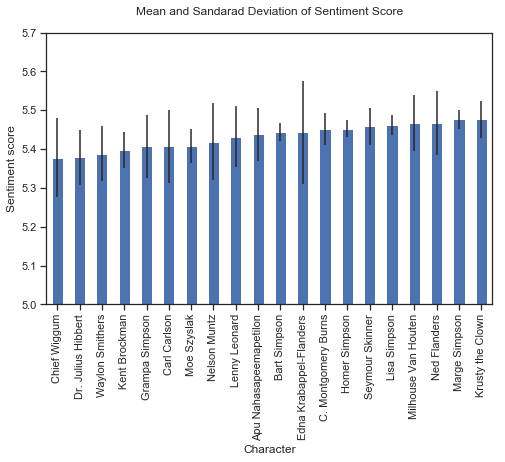

In [64]:
#mean_sent.plot(yerr=std_sent, kind='bar', bottom = 0)
plt.figure(figsize=(8,5))
mean_sent.plot(yerr=std_sent, kind='bar', bottom = 0)  
plt.title("Mean and Sandarad Deviation of Sentiment Score\n")
plt.xlabel("Character")
plt.ylabel("Sentiment score")
plt.ylim((5,5.7))
plt.show()

Here it can be seen that the mean sentiment score is does not change alot between characters, and is ranging from 5.38 to 5.48 on the 9 point scale. The standard deviation of the sentiment score has higher variation.

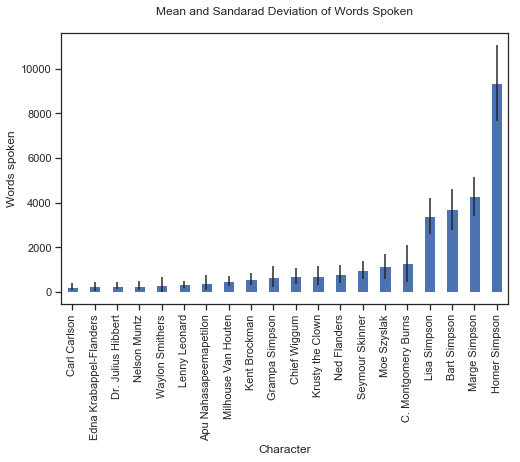

In [65]:
mean_words.plot(yerr=std_words, kind='bar', bottom = 0)
plt.gcf().set_size_inches(8, 5)
plt.title("Mean and Sandarad Deviation of Words Spoken\n")
plt.xlabel("Character")
plt.ylabel("Words spoken")
plt.ylim()
plt.show()

The number of words spoken on average in the seasons varies alot between characters. Here it can be seen that the simpson family speak much more than the other top speaking characters. 

**Plot the sentiment score for each character and the regression of it to show how it developes through the seasons.**

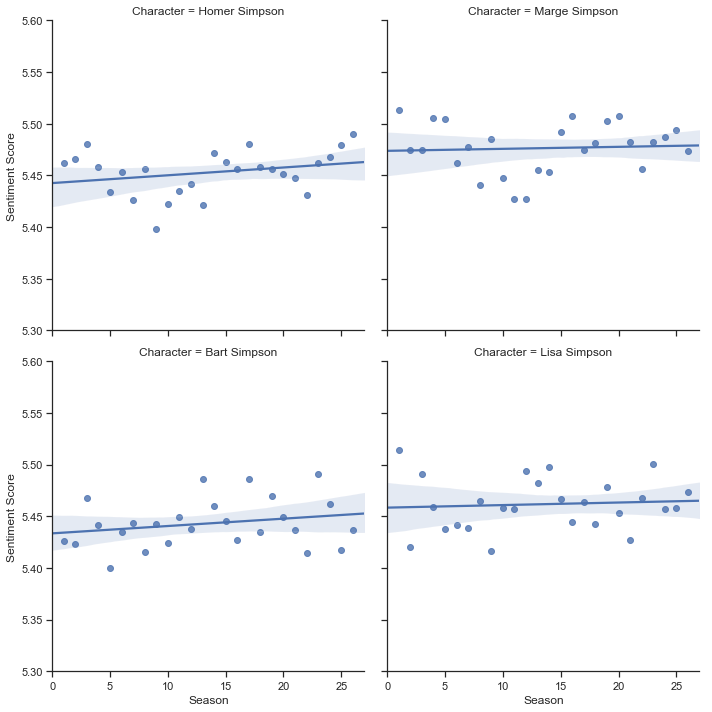

In [66]:
top4=top_20_char[0:4]
sent_dataf_top4 = sent_dataf[sent_dataf["Character"].isin(top4)]

g = sns.lmplot(x = "Season", y = "Sentiment_score", col = "Character", data= sent_dataf_top4 , col_wrap = 2)
g = (g.set_axis_labels("Season", "Sentiment Score").set(xlim=(0, 27), ylim = (5.3,5.6)))

Here it can be seen that the top 5 characters all have really steady sentiment score, compared to the other characters. They all have an small upwards trend, when looking at their regression lines. This confirmes what was found earlier, that the sentiment scores have been becoming higher throughout the seasons.

The other 15 characters exmined have a higher standard deviations in their sentiment score and 8 of them have an upwards trend, 6 have a downwards trend and 1 is neutral. Five characters have an noticable high upwards trend, Milhouse Can Houten, Nelson Muntz, Lenny Leonard, Carl Carlsson and Julius Hibbert.

**Plot the number of words spoken by each character and the regression of it.**

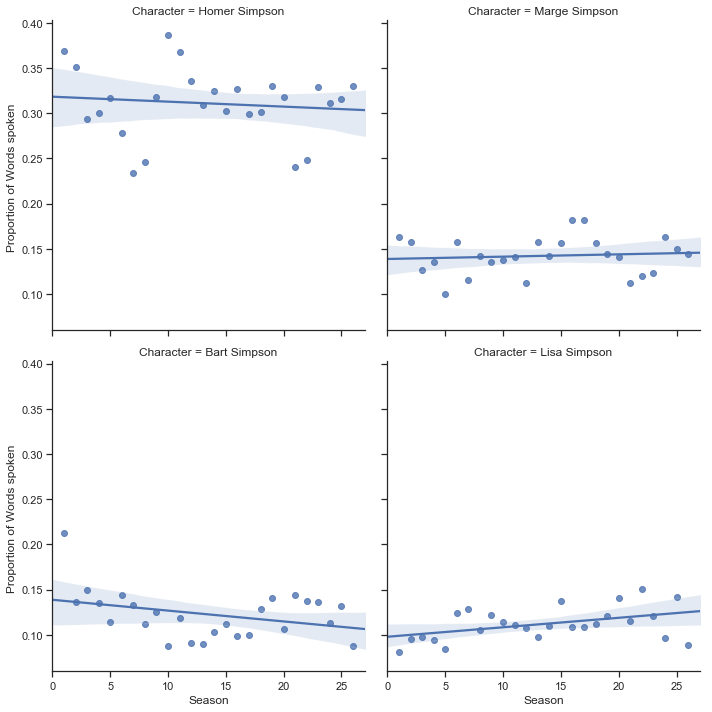

In [67]:
g = sns.lmplot(x = "Season", y = "Words_spoken_pr", col = "Character", data= sent_dataf_top4 , col_wrap = 2)
g = (g.set_axis_labels("Season", "Proportion of Words spoken ").set(xlim=(0, 27)))
#sns.lmplot(x='Season',y='Words_spoken',col='Character', data=sent_dataf, height=8, col_wrap=1,)
#plt.text(2,4,"Each (main) family member's change in importance (Degree-Centrality) and the regression of it")
#plt.xlabel('Season')
#plt.ylabel('Degree Centrality')
#plt.xlim(-1,28)
#plt.show()

Here it can be seen that the role of **Homer** and **Bart** are declining while the roles of **Lisa** and **Merge** are getting bigger.

**Plot the number of words spoken on average per episode per season.**

Since the seasons consist of different number of episodes the average number of words spoken in an episode in an season is calculated.

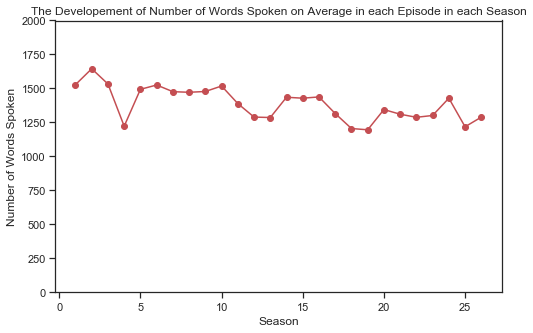

In [68]:
sent_dataf_words = sent_dataf.groupby("Season").sum()
sent_dataf_words["Words_spoken_episode"]=sent_dataf_words["Words_spoken"]/scripts.groupby("season").max()["no_in_season"]

plt.figure(figsize=(8,5))
plt.title("The Developement of Number of Words Spoken on Average in each Episode in each Season")
plt.plot(seasons, sent_dataf_words["Words_spoken_episode"], "r", marker = "o")
plt.xlabel("Season")
plt.ylabel("Number of Words Spoken")
plt.ylim(0,2000)
plt.show()

It is apperent that the number of spoken words has a downwards trend as time goes by. The second season has the maximum number of words spoken over 1600. In the last season, seasons 26 the number of words spoken 1289.

### 3.2.3 Sentiment Analysis of the Synopsis <a class="anchor" id="three.two.three"></a>

Here we look at thow the sentiment score of the Synopsis changes through the seasons.

**Lets begin by loading in the dataframe containing all the information needed.**

In [202]:
data = pd.read_csv("synopsis_dataframe.csv")
data.head()

,Unnamed: 0,no_overall,season,no_in_season,episode_name,viewers (millions),IMDB rating,year,month,day,wiki_link,synopsis
0,0,1,1,1,Simpsons Roasting on an Open Fire,26.7,8.2,1989,12,17,Simpsons_Roasting_on_an_Open_Fire,"['merry', 'plans', 'cut', 'bonuses', 'spend', ..."
1,1,2,1,2,Bart the Genius,24.5,7.8,1990,1,14,Bart_the_Genius,"['swaps', 'papers', 'class', 'intelligence', '..."
2,2,3,1,3,Homer's Odyssey,27.5,7.4,1990,1,21,Homer%27s_Odyssey,"['fired', 'job', 'technical', 'supervisor', 'n..."
3,3,4,1,4,There's No Disgrace Like Home,20.2,7.7,1990,1,28,There%27s_No_Disgrace_Like_Home,"['takes', 'family', 'unorthodox', 'counselor',..."
4,4,5,1,5,Bart the General,27.1,8.1,1990,2,04,Bart_the_General,"['defending', 'school', 'bully', 'becomes', 'l..."


**Now we calculate the sentiment score of each episode**

In [203]:
sentiment_synopsis = []

for sublist in data["synopsis"]:
    sentiment = get_sentiment(sublist)
    sentiment_synopsis.append(sentiment)

In [204]:
len(sentiment_synopsis)

662

**Store the sentiment values in a dataframe**

In [205]:
sent_dataf_3 = pd.DataFrame(index = list(range(0,662)), columns = ["Episode","Season","Sentiment_score"]) #create an empty dataframe
sent_dataf_3["Episode no overall"] = data["no_overall"]
sent_dataf_3["Episode"] = data["no_in_season"]
sent_dataf_3["Season"] = data["season"]
sent_dataf_3["Sentiment_score"] = sentiment_synopsis

sent_dataf_3.head()


,Episode,Season,Sentiment_score,Episode no overall
0,1,1,4.968944,1
1,2,1,4.991100,2
2,3,1,4.989402,3
3,4,1,4.959600,4
4,5,1,4.990833,5


**Plot the sentiment score of each episode and the regerssion line.**

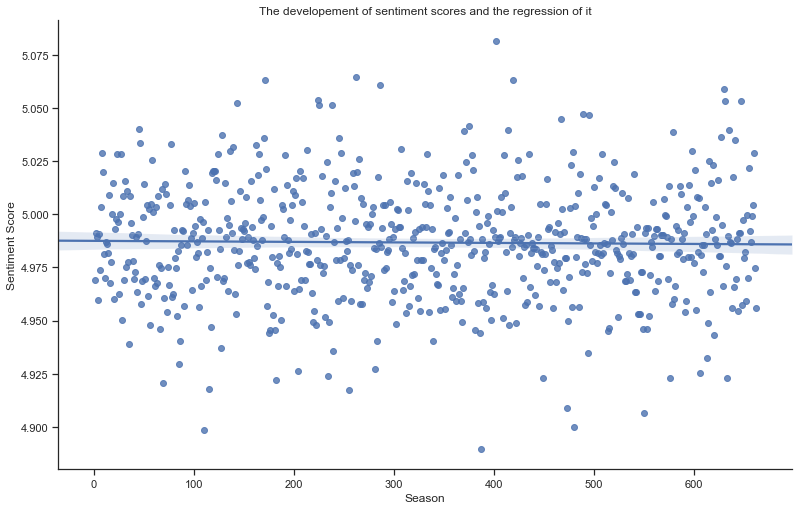

In [206]:
sns.lmplot(x = "Episode no overall", y = "Sentiment_score", data=sent_dataf_3, height = 7, aspect=1.6)
plt.title("The developement of sentiment scores and the regression of it")
plt.xlabel('Season')
plt.ylabel('Sentiment Score')
plt.show()

Here it can be seen that the regression line has slope almost equal to zero so there does not seem to be a trend. 

**Lets calculate the correlation between the sentiment score of each episode and the rating for the episode.**

In [207]:
pg.corr(x=df_episodes_ratings['IMDB rating'], y=sent_dataf_3["Sentiment_score"])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,662,-0.019,"[-0.1, 0.06]",0.0,-0.003,0.625984,0.055,0.078


This confirms that there does not seem to be a correlation between the rating of an episode and the and the sentiment score of the synopsis.

### 3.2.4 Summary of Findings <a class="anchor" id="three.two.four"></a>

The sentiment score of scripts for seasons has a correlation with the ratings of -0.48 so the rating of the seasons is negatively correlated with the sentiment score. The sentiment score of the scripts have a small upwards trend, which means that the spoken lines in the episodes have been getting happier.

The sentiment score of the top 20 characters tells the same story. 13 out of the 20 top charcter have an upwards trend in the sentiment score, most of them small. The four main characters, the Simpsons family all have an upwards trend in sentiment score. Five characters have an noticable high upwards trend, Milhouse Can Houten, Nelson Muntz, Lenny Leonard, Carl Carlsson and Julius Hibbert.

The number of spoken words on average also has a steady downwards trend, in the second season the number of words spoken in each episode on average is 1527 and in the season 26 it is 1289. 

The sentiment of the synopsis does not have a trend and does not seem to be correlated with the ratings.

## 3.3 The Networks for each Season <a class="anchor" id="three.three"></a>

In this chapter the networks for each season will be created and analysed.

Each node is a character's name that appears in a synopsis of an episode in the season.

Each link is between two characters that appeared together in the same synopsis for an episode in the season. 

A node's size is dependant on how often the character appeared in a synopsis in the season. 

A link's size is dependant on how often the two characters appeared together in the same synopsis for an epsiode in the season

### 3.3.1 Creating the Network(s) <a class="anchor" id="three.three.one"></a>

In [514]:
simpson_family = ['Homer','Marge','Bart','Lisa','Maggie']

**Create the nodes (extract characters from each synopsis).**

In [515]:
def extract_characters(episode):
    characters = []
    final_characters = []
    season = df_episodes[df_episodes['no_overall'] == episode]['season'].values[0]
    path = 'synopsis/season{}/{}.txt'.format(season,episode)
    text = io.open(path,'r',encoding='utf-8').read()
    
    # Look for main characters
    if(df_episodes_ratings[df_episodes_ratings['no_overall'] == episode]['main_characters'].values[0]):
        for char in df_episodes_ratings[df_episodes_ratings['no_overall'] == episode]['main_characters'].values[0]:
            characters.append(char)
        
    characters.append(main_chars)
    chars = re.findall(r'href=\"\/wiki\/(.*?)\"',text) # Characters in sentence
    for char in chars:
        characters.append(char)

    for char in characters:
        if(char in df_char['char_wiki_link'].unique() or char in df_char['extra_wiki_link'].unique()):
            final_characters.append(char)
            
    
    tokenizer = RegexpTokenizer(r'\b[^\d\W]+\b') #Gets rid of punctiations and numbers
    tokens = tokenizer.tokenize(text)
    tokens = [w for w in tokens if len(w) > 1]
    tokens = [w for w in tokens if w[0].isupper()]
    for token in tokens:
        if(token in simpson_family):
            char = token+'_Simpson'
            final_characters.append(df_char[df_char['char_wiki_link']==char]['char_wiki_link'].values[0])
            
    for fchar in final_characters:
        # Check if both small and big wiki links exist
        if(fchar in df_char['char_wiki_link'].unique()):
            small_link = df_char[df_char['char_wiki_link']==fchar]['extra_wiki_link'].values[0]
            if(small_link in final_characters):
                final_characters.remove(small_link)
    return list(set(final_characters))
    

**Create node weights, depending on whether the character was a main character in that episode or not.**

In [516]:
def get_node_weights(episode):
    node_weights = {}
    characters = extract_characters(episode)
    main_chars = df_episodes_ratings[df_episodes_ratings['no_overall']==episode]['main_characters'].values[0]
    for char in characters:
        if(char in main_chars):
            node_weights[char] = 5 # A main character gets a 5 times higher importance than the others. 
        else:
            node_weights[char] = 1
    return node_weights

**Create edges for each episode.**

If a character appears in the same episode as another character, they will have an edge between them in the network. 

In [517]:
def create_episode_edges(episode):
    nodes = extract_characters(episode)
    nodes_to_remove = []
    for node in nodes:
        if(node in df_char['extra_wiki_link'].unique()):
            # Replace this node with the longer wiki name
            nodes_to_remove.append(node)
    for node in nodes_to_remove:
        nodes.remove(node)
        nodes.append(df_char[df_char['extra_wiki_link']==node]['char_wiki_link'].values[0])
    edges = []
    for subset in itertools.combinations(nodes, 2):
        if(len(subset)==2):
            edges.append([subset[0],subset[1]])
    return edges

**Create a graph for each episode:**

In [518]:
def create_episode_graph(episode):
    G = nx.Graph()
    nodes = extract_characters(episode)
    G.add_nodes_from(nodes)
    node_weights = get_node_weights(episode)
    edges = get_edges(episode)
    add_edges(G, edges)
    return G, node_weights

**Create a graph for each season:**

In [519]:
def create_season_graph(season):
    G = nx.Graph(season=season)
    # Nodes
    episodes = df_episodes_ratings[df_episodes_ratings['season']==season]['no_overall'].unique()
    nodes = []
    nodes_array = []
    for episode in episodes:
        nodes_array.append(extract_characters(episode))
    for node_set in nodes_array:
        for node in node_set:
            nodes.append(node)
    
    nodes_to_remove = []
    for node in nodes:
        if(node in df_char['extra_wiki_link'].unique()):
            # Replace this node with the longer wiki name
            nodes_to_remove.append(node)
    
    # Remove the nodes that appear twice with different names.
    for node in nodes_to_remove:
        nodes.remove(node)
        nodes.append(df_char[df_char['extra_wiki_link']==node]['char_wiki_link'].values[0])
    overall_nodes = list(set(nodes))
    # Node weights
    node_weights = Counter(nodes)
    # Edges
    overall_edges = []
    for episode in episodes:
        episode_edges = create_episode_edges(episode)
        for edge in episode_edges:
            overall_edges.append(edge)
    overall_edges_weights = {}
    for edge in overall_edges:
        overall_edges_weights[edge[0],edge[1]] = overall_edges.count([edge[0],edge[1]]) + overall_edges.count([edge[1],edge[0]])
     
    for edge in overall_edges:
        G.add_edge(edge[0],edge[1],weight=overall_edges_weights[edge[0],edge[1]])
    for node in overall_nodes:
        G.add_node(node,weight=node_weights[node])
    
        
    return G

**The function below will serve as a drawing function in order to draw a graph for each season.**

In [520]:
def draw_season_graph(G):
    
    forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.2,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.2,
                        strongGravityMode=False,
                        gravity=1.5,

                        # Log
                        verbose=False)
    
    
    plt.figure(figsize=(18,15))
    positions = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=2000)
    
    
    edge_weights = [G[u][v]['weight'] for u,v in G.edges()]
    nodelist = list(dict(G.nodes.data('weight')).keys())
    node_weights = list(dict(G.nodes.data('weight')).values())
    labels = {}
    for node in nodelist:
        if(node in df_char['char_wiki_link'].unique()):
            labels[node] = (df_char[df_char['char_wiki_link']==str(node)]['name'].values[0])
        else:
            labels[node] = (df_char[df_char['extra_wiki_link']==str(node)]['name'].values[0])
    nx.draw_networkx_labels(G, positions,labels=labels)
    
    nx.draw_networkx_nodes(G, positions, nodelist = nodelist, node_size= [v*1000 for v in node_weights], 
                           with_labels=True,node_color='yellow',alpha=0.75)
    
    nx.draw_networkx_edges(G, positions, width=[v*1.5 for v in edge_weights],alpha=0.5)
    
    ax = plt.gca()
    ax.collections[0].set_edgecolor("black") 
    plt.axis('off')
    plt.title('Season' + ' ' + str(G.graph['season']))
    plt.show()

The three best rated seasons can be visualized along with the three worst rated seasons:

**The 3 best seasons visualized as a network**

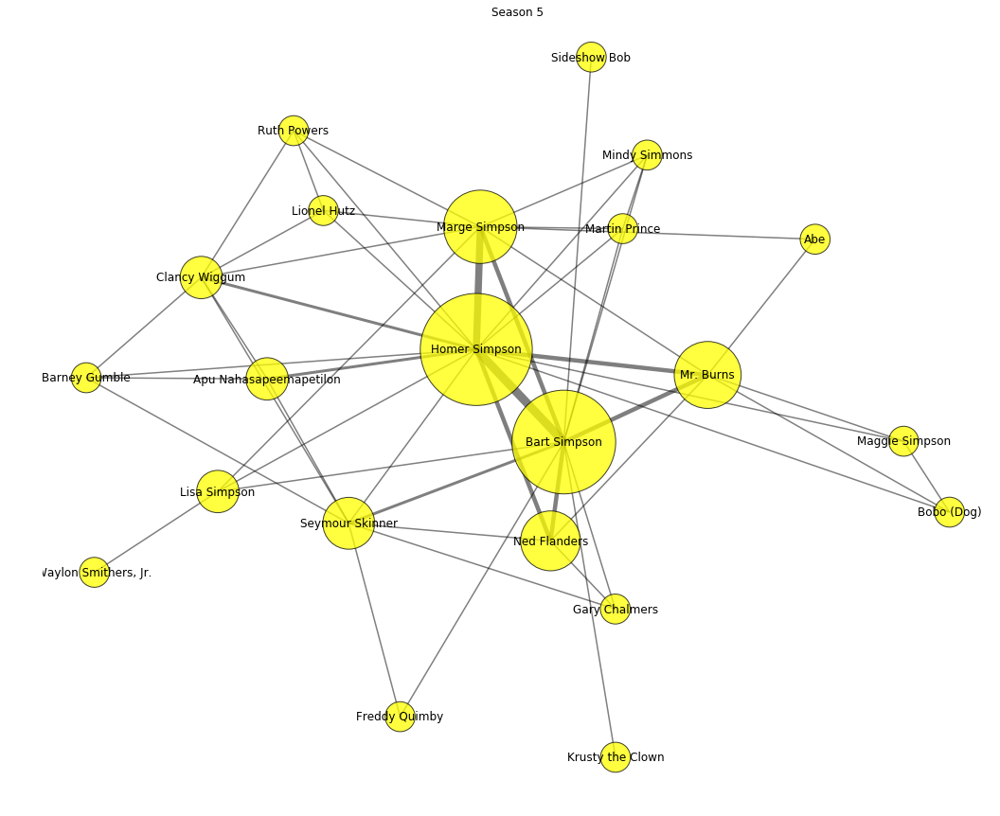

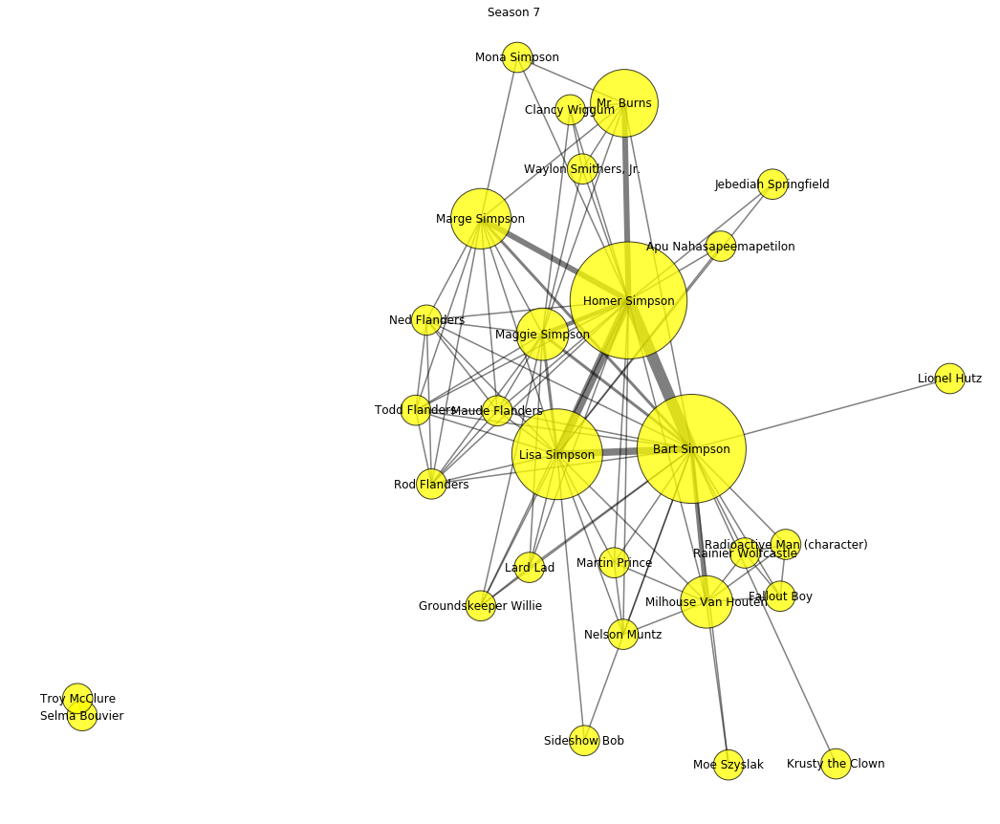

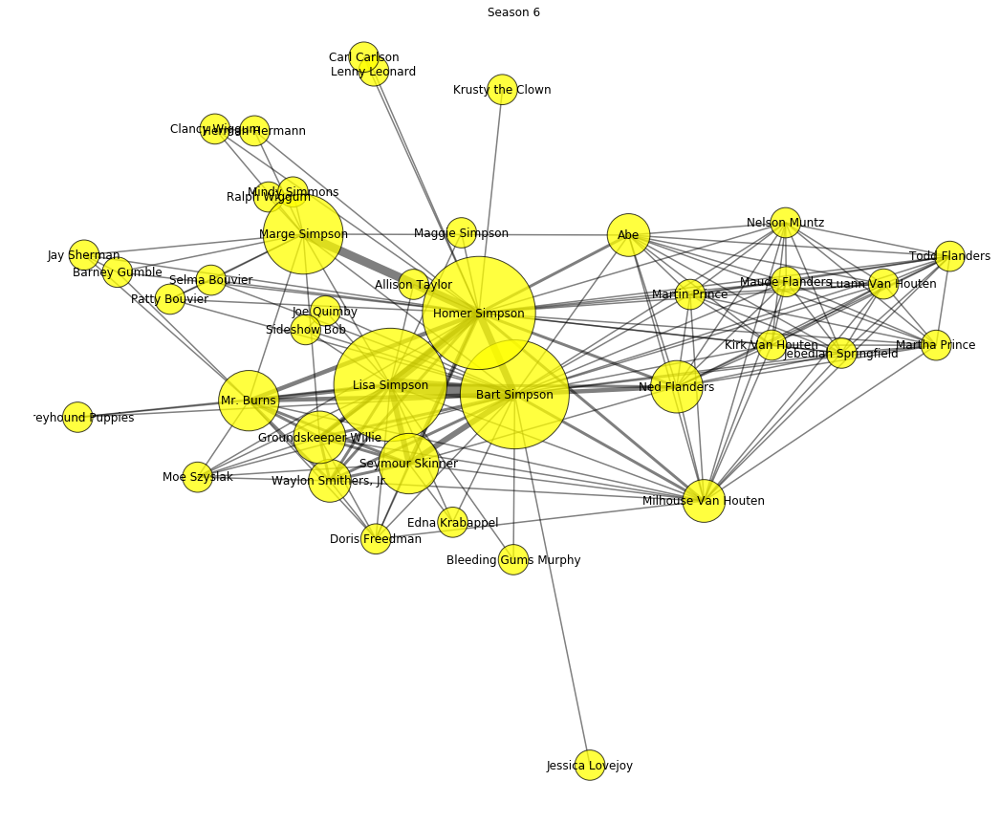

In [726]:
draw_season_graph(create_season_graph(5))
draw_season_graph(create_season_graph(7))
draw_season_graph(create_season_graph(6))

**The 3 worst rated seasons visualized as networks**

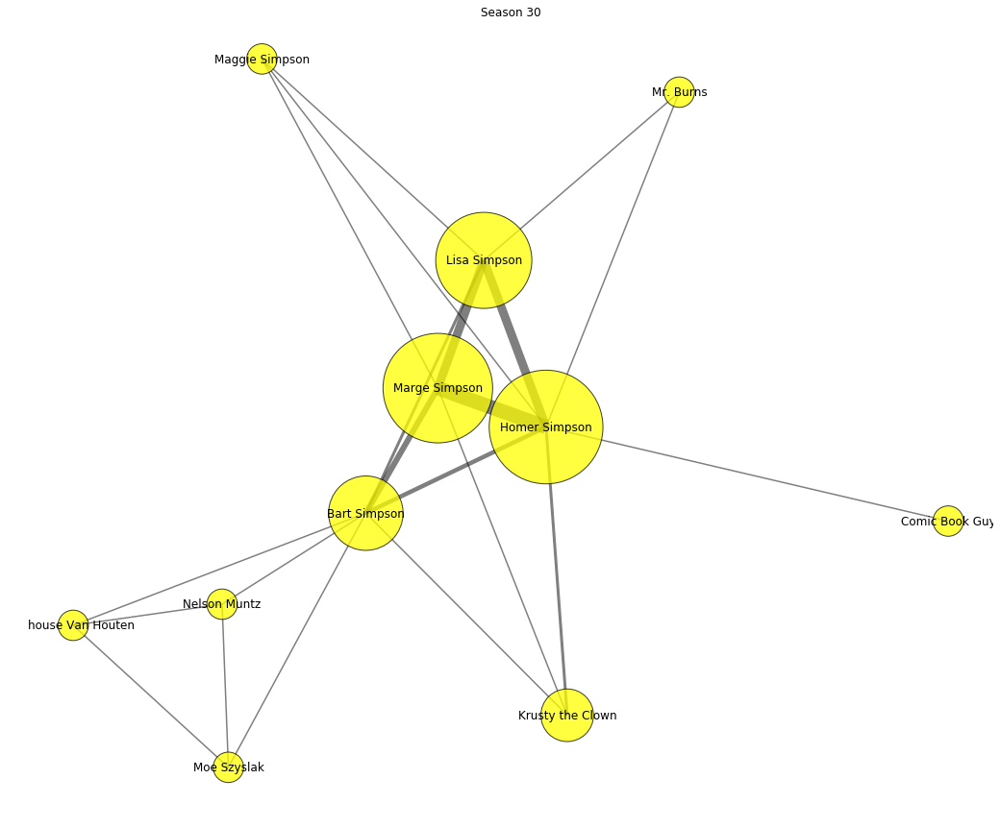

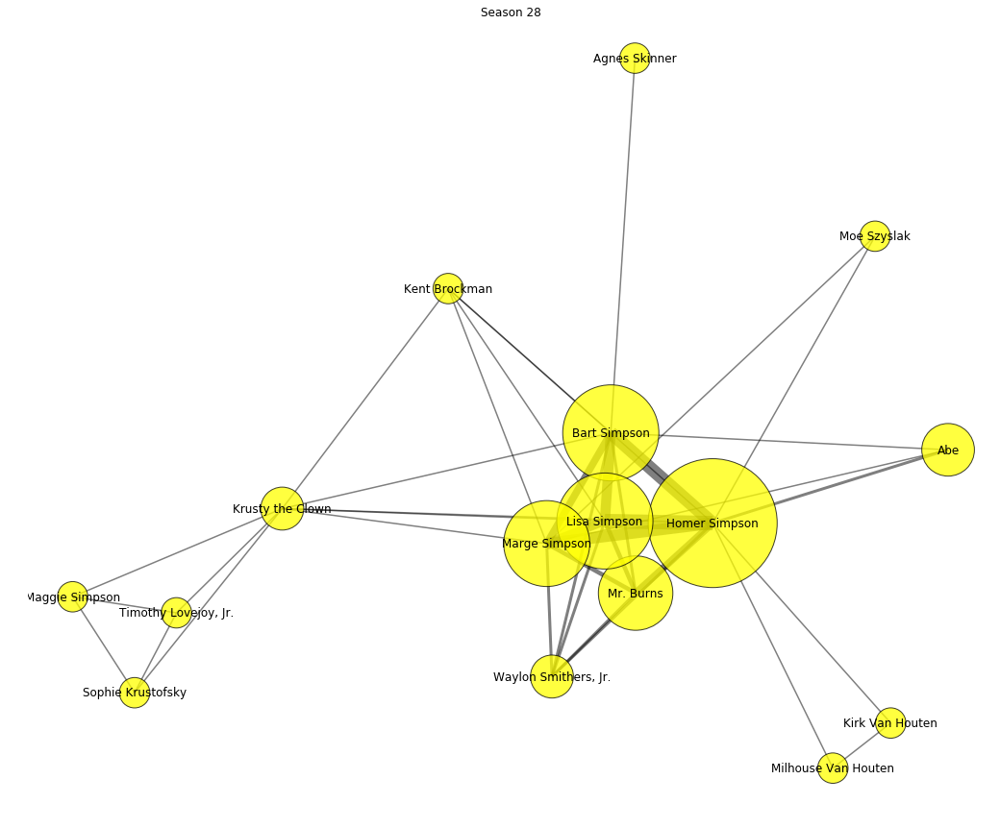

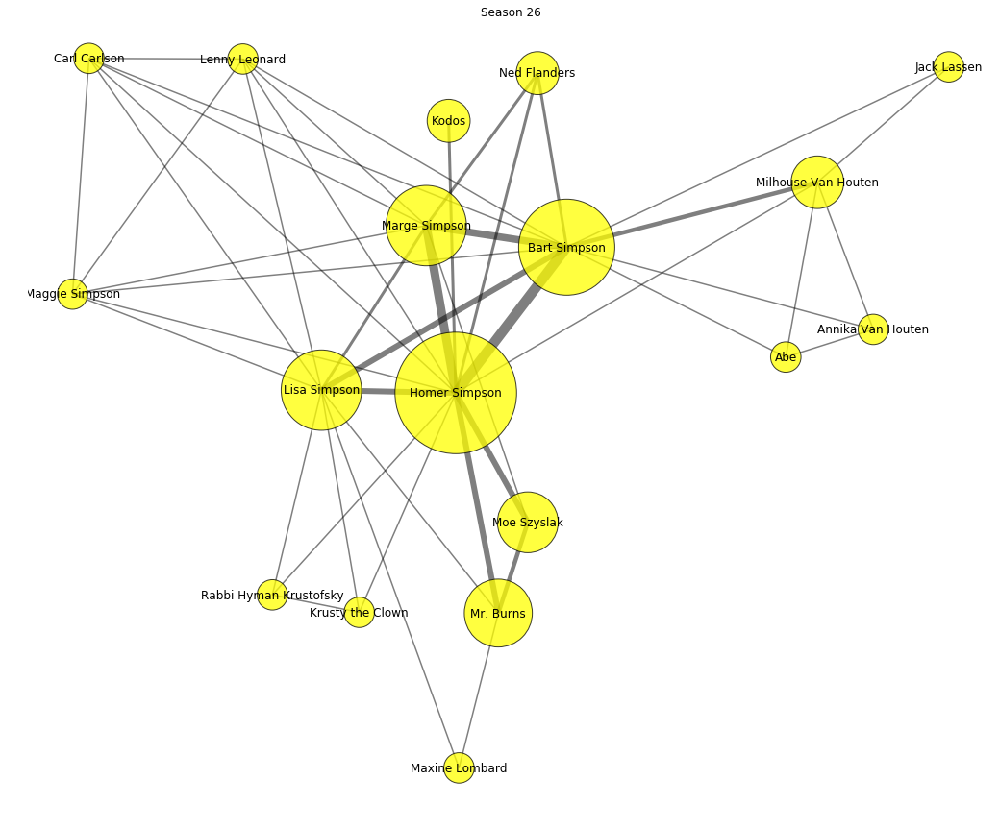

In [727]:
draw_season_graph(create_season_graph(30))
draw_season_graph(create_season_graph(28))
draw_season_graph(create_season_graph(26))

There seems to be a bit more of a complex structure in the networks that received the best ratings compared to those that received the worst, in regards to links and nodes. Further analysis is carried on in the next subsection. 

After visualizing the 30 seasons, no dramatic changes emerge. The visualization of each season will be omitted in this notebook, as they would take up a lot of space. 

Further analysis is needed in order to see if there are any significant changes between the years. It is however apparent that the center of "gravity" for each network is around the Simpsons family, which is to be expected. This can be seen in every season. The edges between the Simpson family carry more weight as they do appear more often together in an episde, and form a center of gravity for each season's network. 

### 3.3.2 Analyzing the Networks <a class="anchor" id="three.three.two"></a>

As the analysis of the networks begins, it is useful to see if there are nodes that appear in all networks, i.e. a character that appears in a synopsis of an episode for every season. The *"change"* in these characters could potentially expose the change in the essence of the show.  

It will also prove valuable to see which nodes appear the most often aside from the nodes that appear in every season.

**Begin by finding the top 25 nodes which appear the most seasons.**

In [522]:
season_nodes = []
for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    for node in G.nodes():
        season_nodes.append(node)
        
count_season_nodes = Counter(season_nodes)

In [523]:
arr_name_count = []
for name, count in count_season_nodes.most_common():
    arr_name_count.append([name,count])
df_appear = pd.DataFrame(arr_name_count, columns=['Name','Appearances'])

**Plot the top 25 character season appearances.**

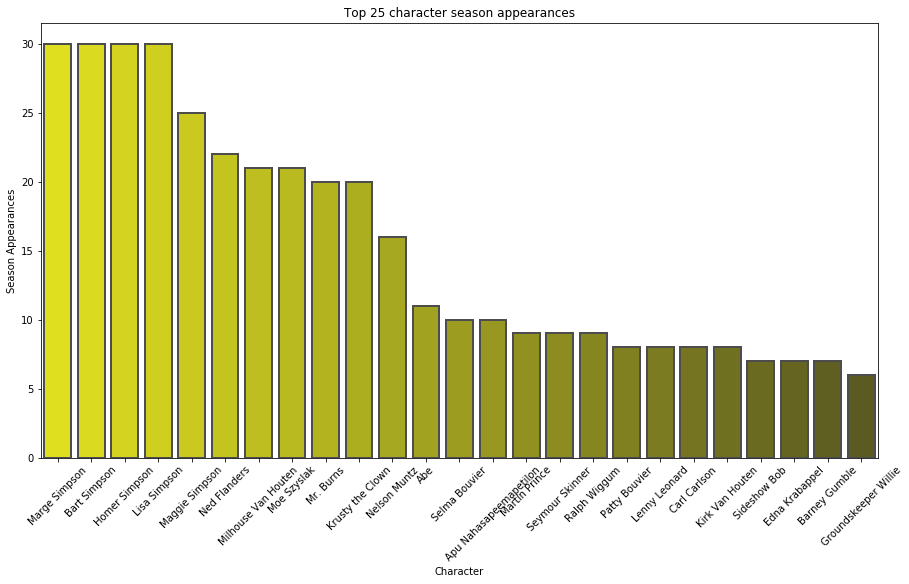

In [524]:
palette = sns.dark_palette("yellow", n_colors=35, reverse=True, as_cmap=False, input='rgb')


plt.figure(figsize=(15,8))
top = 25
sns.barplot(x='Name',y='Appearances',data=df_appear[:top], linewidth=2.0, edgecolor="0.3", palette=palette)
names = []
for name in df_appear[:top]['Name']:
    name_ = df_char[df_char['char_wiki_link']==name]['name'].values[0]
    names.append(name_)

plt.xticks(ticks=range(top),labels=names,rotation=45)
plt.title("Top {} character season appearances".format(top))
plt.ylabel("Season Appearances")
plt.xlabel("Character")
plt.show()

The *core* Simpsons family appears in the synopsis of every season, as was suspected, with Maggie not appearing in a synopsis in 5 seasons of the 30 analyzed. 

These 25 characters depicted in this graph can be considered to be the *"main characters"* of the series, so analyzing the change in their *"network behaviour"*, e.g. their *centrality measures*, could prove useful in seeing the change in the series between years. 

In [525]:
most_common_nodes = [node for node in df_appear[:25]['Name']]

#### 3.3.2.1 Changes in Number of Nodes and Edges <a class="anchor" id="three.three.two.one"></a>

Each node in the network identifies a character that appeared in an episode's synopsis in the season. It could prove useful to see if the number of nodes has altered drastically over the years. 

**Plot the number of nodes in the network of each season.**

In [526]:
season_no_nodes = {}
for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    season_no_nodes[season] = G.number_of_nodes()
    
df_nodes = pd.DataFrame.from_dict(season_no_nodes,orient='index').reset_index()
df_nodes.columns = ['Season','Nodes']

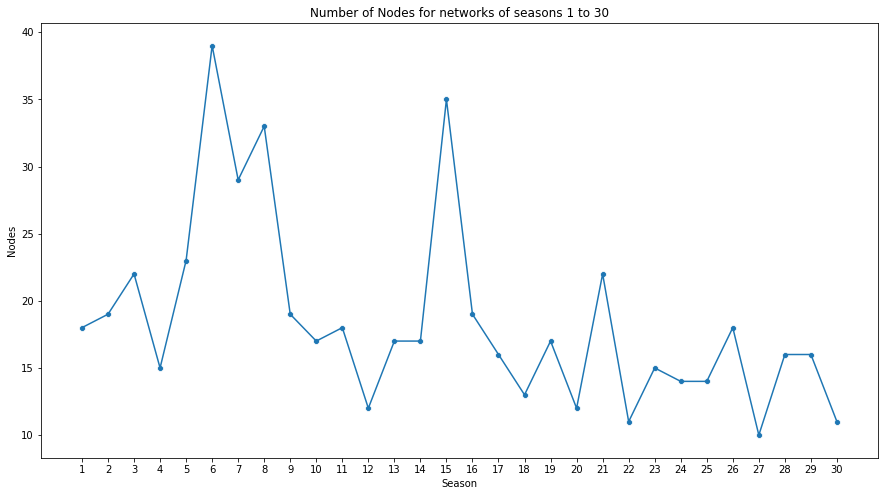

In [527]:
plt.figure(figsize=(15,8))

sns.lineplot(x='Season',y='Nodes',data=df_nodes)
sns.scatterplot(x='Season',y='Nodes',data=df_nodes)

plt.title("Number of Nodes for networks of seasons 1 to 30")
plt.xticks(ticks=range(1,31))
plt.show()

From this it can be deducted that the number of characters in each season's synopsis doesn't seem to have drastically changed since the show's inception, except for in seasons **6, 7, 8** and **15**. All seasons seem to have nodes ranging from 10 to 25 except for those seasons. There are of course fluctuations but no patterns seem to emerge. 

Each edge between nodes represents that those characters appeared in an episode within the same season. Seeing the difference between connections over the years could potentially express a change in character connection and season essence.

More nodes would potentially mean that there are more characters per episode and less nodes could portray a season where the epiosdes revolve around less characters. 

**Plot the number of edges in the network for each season.**

In [528]:
season_edges = {}
for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    season_edges[season] = G.number_of_edges()
    
df_edges = pd.DataFrame.from_dict(season_edges,orient='index').reset_index()
df_edges.columns = ['Season','Edges']

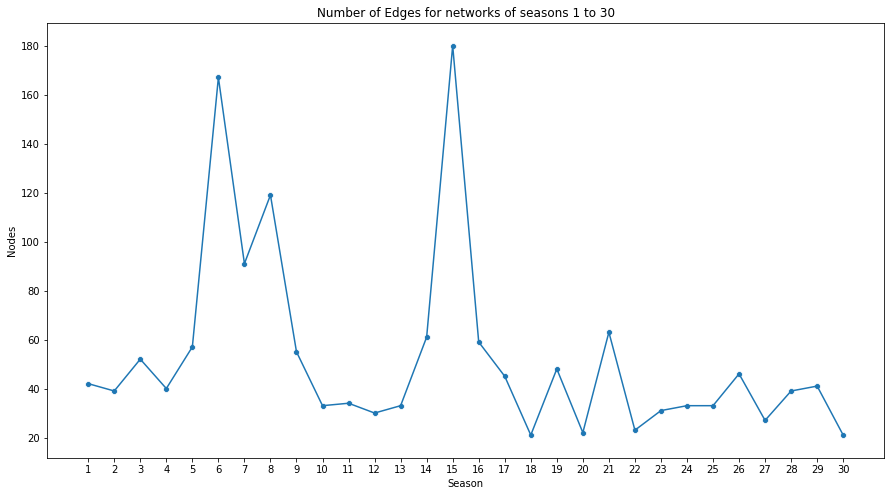

In [529]:
plt.figure(figsize=(15,8))

sns.lineplot(x='Season',y='Edges',data=df_edges)
sns.scatterplot(x='Season',y='Edges',data=df_edges)

plt.title("Number of Edges for networks of seasons 1 to 30")
plt.xticks(ticks=range(1,31))
plt.ylabel("Nodes")
plt.xlabel("Season")
plt.show()

Similar results are demonstrated as before, some fluctuations but no patterns. There doesn't seem to be that much "overall" change in edges except for a few seasons, namely **6,7,8** and **15**. 

It can thus be asserted that the overall characters and the links between them do not seem to change that much between seasons. 

**Do edges and nodes seem to correlate with ratings?**

It could be that simply looking at the number of nodes and edges between season could portray some correlation with the season's average rating. 

In [530]:
df_avg_rating = df_episodes_ratings.groupby('season').mean()['IMDB rating'].reset_index()
df_avg_rating.columns = ['Season','Avg Rating']

In [531]:
df_networks = pd.merge(df_nodes, df_edges)
df_networks = pd.merge(df_networks, df_avg_rating)
df_networks_norm = df_networks

For this analysis, normalizing the columns is necessary as they all carry values on different scales. 

In [532]:
df_networks_norm[['Nodes','Edges','Avg Rating']] = (df_networks[['Nodes','Edges','Avg Rating']]-df_networks[['Nodes','Edges','Avg Rating']].mean())/df_networks[['Nodes','Edges','Avg Rating']].std()

**Plotting Nodes vs. Avg Rating per season (Normalized)**

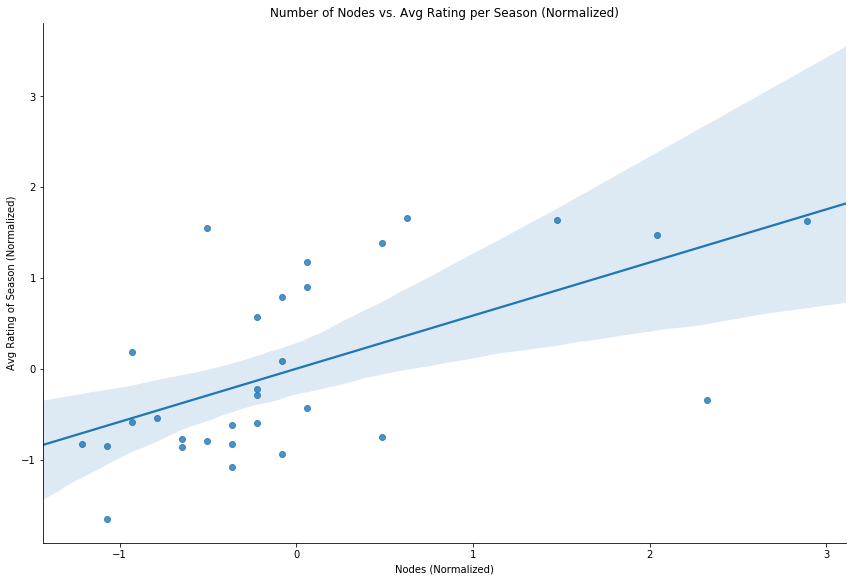

In [533]:
sns.lmplot(x='Nodes',y='Avg Rating',data=df_networks_norm, height=8, aspect=1.5)


plt.title("Number of Nodes vs. Avg Rating per Season (Normalized)")
plt.ylabel("Avg Rating of Season (Normalized)")
plt.xlabel("Nodes (Normalized)")
plt.show()

This graph does infer that the number of characters per season could have something to do with the average rating of the season, as it can be seen that there is a positive correlation between the normalized variables.

**Plotting Edges vs. Avg Rating (Normalized)**

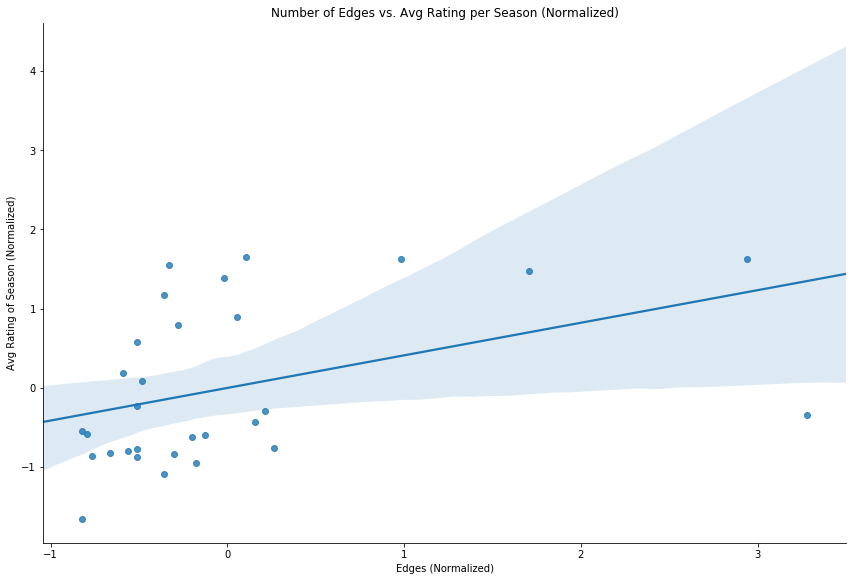

In [534]:
sns.lmplot(x='Edges',y='Avg Rating',data=df_networks_norm, height=8, aspect=1.5)


plt.title("Number of Edges vs. Avg Rating per Season (Normalized)")
plt.ylabel("Avg Rating of Season (Normalized)")
plt.xlabel("Edges (Normalized)")
plt.show()

Same as above. Some correlation between these normalized features.

It seems to be that there more nodes there are in a network, the higher the rating will be, or at least that season will be more likely to receive a higher rating than that of a season which has few nodes. 

**But what about the actual weights of nodes of The Simpsons family?**

Because a node's weight indicates how often that node appeared in a synopsis within the season (with a boost if that node is a main character in an episode in the season), a change in nodes' weight over the years could indicate a change in their influence. 

In [ ]:
season_no_nodes = {}
for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    season_no_nodes[season] = G.number_of_nodes()
    
df_nodes = pd.DataFrame.from_dict(season_no_nodes,orient='index').reset_index()
df_nodes.columns = ['Season','Nodes']

In [679]:
G = create_season_graph(2)

In [686]:
node_info = []
for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    for node in G.nodes(data=True):
        node_info.append([season, node[0], node[1]['weight']])

In [687]:
df_node_info = pd.DataFrame(node_info, columns = ['season','name','weight'])

In [694]:
df_node_info_family = df_node_info[df_node_info['name'].isin(['Homer_Simpson','Marge_Simpson','Bart_Simpson','Lisa_Simpson'])]

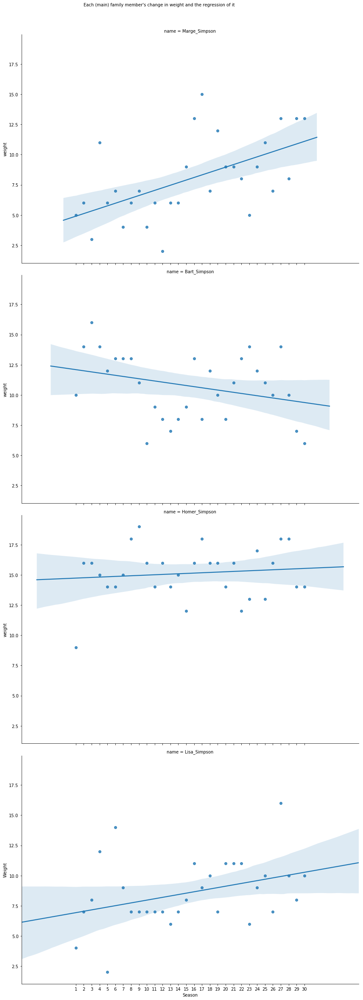

In [704]:
g = sns.lmplot(x='season',y='weight',col='name', data=df_node_info_family, height=8, aspect=1.5, col_wrap=1)
g.set(xticks=df_node_info['season'].unique())
plt.text(2,82,"Each (main) family member's change in weight and the regression of it")
plt.xlabel('Season')
plt.ylabel('Weight')
plt.show()

Just by looking at the weight changes of the nodes that represent the main characters of the series it can be seen that **Lisa** and **Marge** have started to make more appearances over the years, or at least more important appearances. 

#### 3.3.2.2 The Importance of Characters - Centrality Analysis <a class="anchor" id="three.three.two.two"></a>

In graph theory and network analysis, indicators of centrality identify the most important vertices within a graph [[1]](https://en.wikipedia.org/wiki/Centrality). Investigating the aformentioned *most common nodes'* centrality measures could potentially yield interesting results about the change in the series' essence. 

##### 3.3.2.2.1 **Degree Centrality** <a class="anchor" id="three.three.two.two.one"></a>
 
Degree centrality, which is defined as the number of links incident upon a node (i.e., the number of ties that a node has) can indicate which node might be the most important in a network, as it can show the *flow* through that particular node. 

In [595]:
degree_cents = []

for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    dc = nx.degree_centrality(G)
    for char, val in dc.items():
        degree_cents.append([char,val,season])

In [596]:
df_degree_centrality = pd.DataFrame(degree_cents,columns=['char_wiki_link','degree_centrality','season'])

The dataframe that holds every character's degree centrality makes it easy to investigate the "*change in character's importance"* over the years. 

**Plot the degree centarliy of the charactes for each season**

Get the characters' actual names and then sort them by degree centrality for each season.

In [597]:
df_degree_centrality = pd.merge(df_degree_centrality, df_char, on='char_wiki_link', how='left')
df_degree_centrality_sorted = df_degree_centrality.sort_values(['season','degree_centrality'],ascending=[True, False]).groupby('season').head(10)

The most important character of each season with regards to degree centrality can be viewed here:

In [331]:
df_degree_centrality.sort_values(['season','degree_centrality'],ascending=[True, False]).groupby('season').head(1)

,char_wiki_link,degree_centrality,season,name,extra_wiki_link
70,Bart_Simpson,0.941176,1,Bart Simpson,Bart
71,Bart_Simpson,0.722222,2,Bart Simpson,Bart
72,Bart_Simpson,0.857143,3,Bart Simpson,Bart
103,Homer_Simpson,0.785714,4,Homer Simpson,Homer
104,Homer_Simpson,0.681818,5,Homer Simpson,Homer
105,Homer_Simpson,0.815789,6,Homer Simpson,Homer
76,Bart_Simpson,0.750000,7,Bart Simpson,Bart
107,Homer_Simpson,0.906250,8,Homer Simpson,Homer
108,Homer_Simpson,0.722222,9,Homer Simpson,Homer
109,Homer_Simpson,0.812500,10,Homer Simpson,Homer


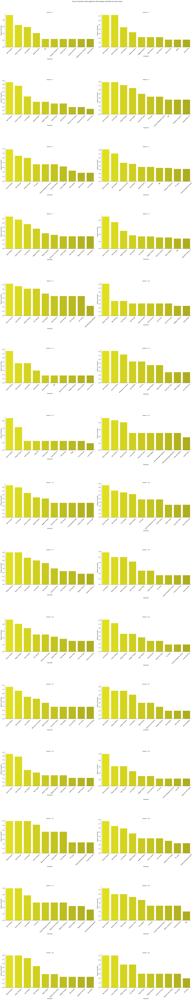

In [323]:

palette = sns.dark_palette("yellow", n_colors=35, reverse=True, as_cmap=False, input='rgb')

g = sns.FacetGrid(col_wrap=2,
                  data=df_degree_centrality_sorted, 
                  col='season',
                  height=8,aspect=1.5,
                  sharex=False, sharey=False, palette=palette)

g.map(sns.barplot, "name","degree_centrality", palette=palette)
for ax in g.axes.flat:
    true_labels = []
    labels = ax.get_xticklabels()
    ax.set_xticklabels(labels, rotation=45)
    ax.set_ylabel('Degree Centrality')
    ax.set_xlabel('Character')
plt.subplots_adjust(hspace=1)
plt.suptitle("Top 10 characters with regards to their degree centrality for each season", y=1.01)
plt.show()

When looked at closely, it can be seen that **Homer** and **Bart** dominate the top 2 spots for the first seasons, with an exception of season 4 where **Lisa** has the number one spot. However, as the seasons progress, **Marge** and **Lisa** start making more and more appearances in the top 2 spots, meaning that they are gaining importance with regards to Degree Centrality.

**Plot the developement of the degree centrality for the top 5 characters.**

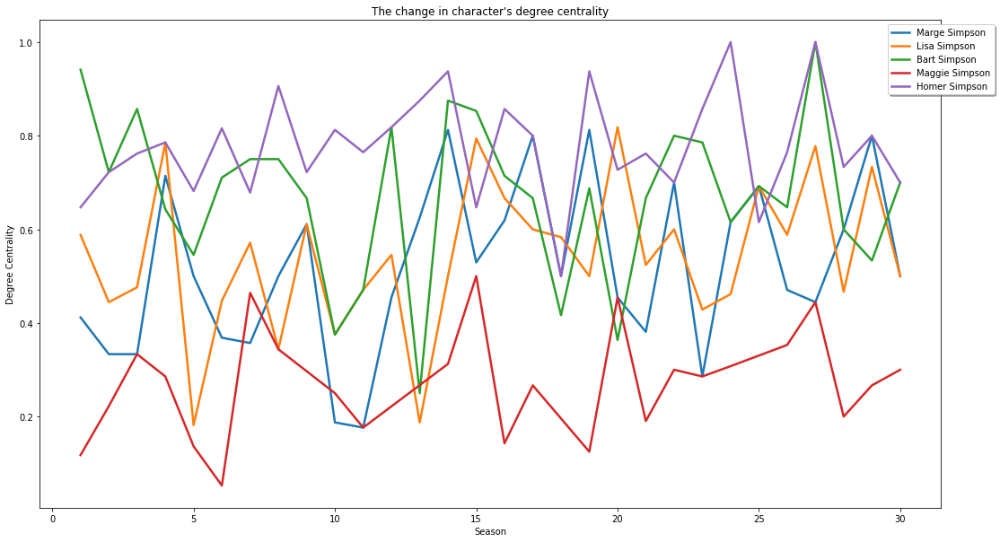

In [328]:
fig = plt.figure(figsize=(18,10))

ax = fig.add_subplot(111)

members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson','Maggie_Simpson']
df_members = df_degree_centrality[df_degree_centrality['char_wiki_link'].isin(members)].sort_values(by='season')

sns.lineplot(x='season',y='degree_centrality',hue='char_wiki_link', data=df_members, ax = ax, lw=2.5)


ax.legend(loc='upper center', bbox_to_anchor=(1, 1),
          fancybox=True, shadow=True, ncol=1, labels=['Marge Simpson',
                                                      'Lisa Simpson',
                                                      'Bart Simpson',
                                                      'Maggie Simpson',
                                                      'Homer Simpson'])

plt.title("The change in character's degree centrality")
plt.xlabel('Season')
plt.ylabel('Degree Centrality')
plt.show()

The importance of characters does seem to fluctuate a lot throughout the years, but no apparent pattern seems to emerge. 

However, it should be noted that **Lisa** and **Merge** seem to have a bigger role during the years when the show isn't doing so good.

Lisa's and Merges's role seems to be gaining importance (from Degree Centrality) over the years, while the ratings have been going down. 

**Lets do a regression of the degree centrality for these top 4 characters to see wheter there is a trend.**

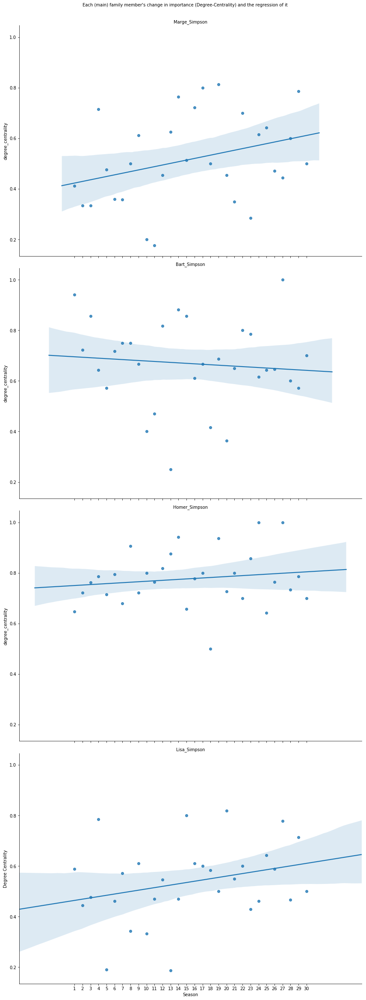

In [760]:
members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson'] 
# Exclude Maggie, as she does not seem to be an important character

df_members = df_degree_centrality[df_degree_centrality['char_wiki_link'].isin(members)].sort_values(by='season')
g = sns.lmplot(x='season',y='degree_centrality',col='char_wiki_link', data=df_members, height=8, aspect=1.5, col_wrap=1,)
g.set_titles('{col_name}')
g.set(xticks=range(1,31))
plt.text(2,4,"Each (main) family member's change in importance (Degree-Centrality) and the regression of it")
plt.xlabel('Season')
plt.ylabel('Degree Centrality')
plt.show()

From this, it can clearly be seen that while the series are declining, **Marge** and **Lisa** are becoming more and more **important** to the show while **Bart's** importance is dwindling. **Homer's** importance has always been very much and still is. 

##### 3.3.2.2.2 Betweenness centarlity <a class="anchor" id="three.three.two.two.two"></a>

Betweenness centrality quantifies the number of times a node acts as a bridge along the shortest path between two other nodes. This centrality measure also identifies the most influencial characters in each season. The same tactics will be deployed as before.

In [600]:
between_cents = []

for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    bc = nx.betweenness_centrality(G)
    for char, val in bc.items():
        between_cents.append([char,val,season])

In [601]:
df_between_cents = pd.DataFrame(between_cents,columns=['char_wiki_link','betweenness_centrality','season'])

In [602]:
df_between_cents = pd.merge(df_between_cents, df_char)
df_between_cents_sorted = df_between_cents.sort_values(['season','betweenness_centrality'],ascending=[True, False]).groupby('season').head(10)

The most important character with regards to betweenness centrality for each season can be viewed here: 

In [339]:
df_between_cents.sort_values(['season','betweenness_centrality'],ascending=[True, False]).groupby('season').head(1)

,char_wiki_link,betweenness_centrality,season,name,extra_wiki_link
70,Bart_Simpson,0.552083,1,Bart Simpson,Bart
101,Homer_Simpson,0.279956,2,Homer Simpson,Homer
72,Bart_Simpson,0.500794,3,Bart Simpson,Bart
103,Homer_Simpson,0.324542,4,Homer Simpson,Homer
104,Homer_Simpson,0.314863,5,Homer Simpson,Homer
105,Homer_Simpson,0.390544,6,Homer Simpson,Homer
76,Bart_Simpson,0.355071,7,Bart Simpson,Bart
107,Homer_Simpson,0.438105,8,Homer Simpson,Homer
108,Homer_Simpson,0.281046,9,Homer Simpson,Homer
109,Homer_Simpson,0.526389,10,Homer Simpson,Homer


Again, **Marge** and **Lisa** start making appearances as the most important character later on in the series, taking the spot of either **Bart** or **Homer**.

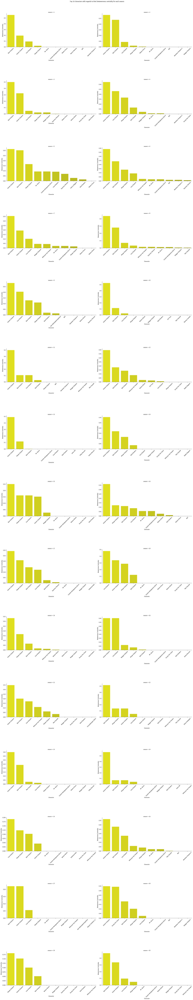

In [340]:

palette = sns.dark_palette("yellow", n_colors=35, reverse=True, as_cmap=False, input='rgb')

g = sns.FacetGrid(col_wrap=2,
                  data=df_between_cents_sorted, 
                  col='season',
                  height=8,aspect=1.5,
                  sharex=False, sharey=False, palette=palette)

g.map(sns.barplot, "name","betweenness_centrality", palette=palette)
for ax in g.axes.flat:
    true_labels = []
    labels = ax.get_xticklabels()
    ax.set_xticklabels(labels, rotation=45)
    ax.set_ylabel('Betwenness Centrality')
    ax.set_xlabel('Character')
plt.subplots_adjust(hspace=1)
plt.suptitle("Top 10 characters with regards to their betweenness centrality for each season", y=1.01)
plt.show()

Again, the same pattern can be seen. **Marge** and **Lisa** start making more and more appearances in the top 2 spots as the series progress.

**Plot the developement of the main charactes betweenness centrality throghout the seasons.**

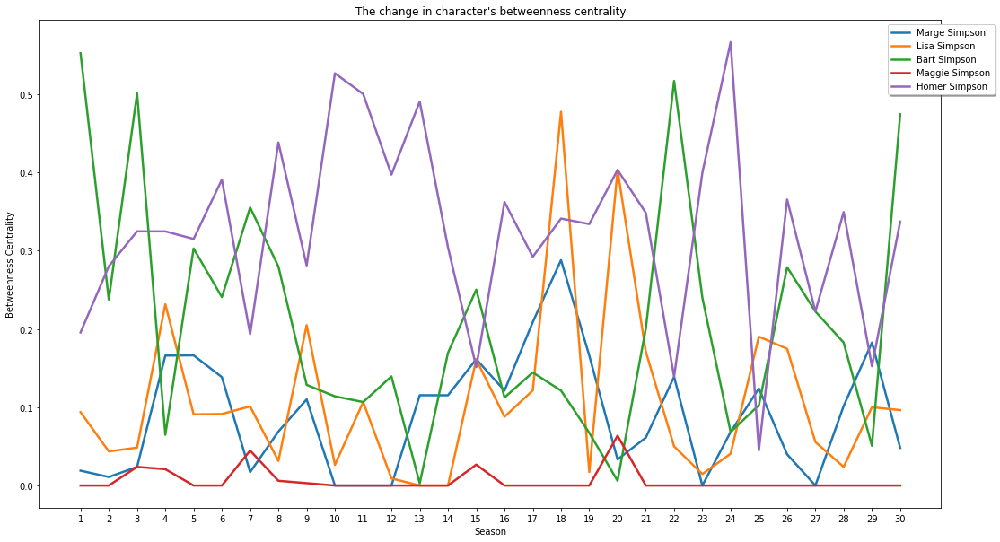

In [343]:
fig = plt.figure(figsize=(18,10))

ax = fig.add_subplot(111)

members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson','Maggie_Simpson']
df_members = df_between_cents[df_between_cents['char_wiki_link'].isin(members)].sort_values(by='season')

sns.lineplot(x='season',y='betweenness_centrality',hue='char_wiki_link', data=df_members, ax = ax, lw=2.5, markers=True)


ax.legend(loc='upper center', bbox_to_anchor=(1, 1),
          fancybox=True, shadow=True, ncol=1, labels=['Marge Simpson',
                                                     'Lisa Simpson',
                                                     'Bart Simpson',
                                                     'Maggie Simpson',
                                                     'Homer Simpson'])
plt.xticks(range(1,31))

plt.title("The change in character's betweenness centrality")
plt.xlabel('Season')
plt.ylabel('Betweenness Centrality')
plt.show()

Bart and Homer do seem to be the most influencial characters throughout all seasons except for **season 18**, where **Lisa** is the most influencial node. This also holds for **season 25**. 

In season 29, **Marge** is the most influencial character. 

**Lets do a regression of the betweeness centrality for these top 4 characters to see wheter there is a trend.**

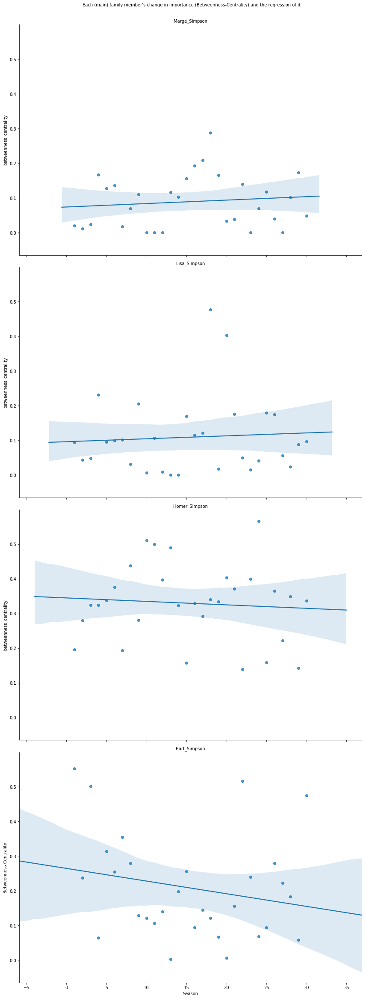

In [762]:
members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson'] 
# Exclude Maggie, as she does not seem to be an important character

df_members = df_between_cents[df_between_cents['char_wiki_link'].isin(members)].sort_values(by='season')

g = sns.lmplot(x='season',y='betweenness_centrality',col='char_wiki_link', data=df_members, height=8, aspect=1.5, col_wrap=1,)
g.set_titles("{col_name}")
plt.text(2,2.75,"Each (main) family member's change in importance (Betweenness-Centrality) and the regression of it")
plt.xlabel('Season')
plt.ylabel('Betweenness Centrality')
plt.show()

Here it can be seen that the importance of the **women** of the family is on the uprise, while the importance of the **men** of the family is going down (with respect to Betweenness Centrality). Could this be the reason for the decline of the show?, i.e. is the importance of **Homer** and **Bart** more important to the viewers than the role of the **women** in the series? 

##### 3.3.2.2.3 Eigenvector Centrality <a class="anchor" id="three.three.two.two.three"></a>

Another influence-measure, but now the connection to *high-profile* nodes will contribute more to a nodes influence. 

In [605]:
eigenvector_cents = []

for season in df_episodes_ratings['season'].unique():
    G = create_season_graph(season)
    bc = nx.eigenvector_centrality(G)
    for char, val in bc.items():
        eigenvector_cents.append([char,val,season])

In [606]:
df_eigenvector_cents = pd.DataFrame(eigenvector_cents,columns=['char_wiki_link','eigenvector_centrality','season'])

In [607]:
df_eigenvector_cents = pd.merge(df_eigenvector_cents, df_char)
df_eigenvector_cents_sorted = df_eigenvector_cents.sort_values(['season','eigenvector_centrality'],ascending=[True, False]).groupby('season').head(10)

The most important character in regards to eigenvector centrality for each season can be seen here:

In [357]:
df_eigenvector_cents.sort_values(['season','eigenvector_centrality'],ascending=[True, False]).groupby('season').head(1)

,char_wiki_link,eigenvector_centrality,season
2,Bart_Simpson,0.472821,1
19,Bart_Simpson,0.462215,2
37,Bart_Simpson,0.434784,3
61,Lisa_Simpson,0.398930,4
76,Homer_Simpson,0.457837,5
101,Homer_Simpson,0.333121,6
137,Homer_Simpson,0.370622,7
167,Homer_Simpson,0.394225,8
199,Homer_Simpson,0.348686,9
219,Homer_Simpson,0.512095,10


Not much can be inferred from the eigenvector centralities, but there seems to be more appearances from **Lisa** and **Marge** as the series progresses, *again*. 

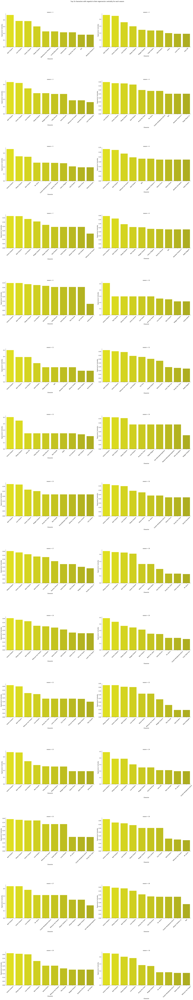

In [358]:

palette = sns.dark_palette("yellow", n_colors=35, reverse=True, as_cmap=False, input='rgb')

g = sns.FacetGrid(col_wrap=2,
                  data=df_eigenvector_cents_sorted, 
                  col='season',
                  height=8,aspect=1.5,
                  sharex=False, sharey=False, palette=palette)

g.map(sns.barplot, "name","eigenvector_centrality", palette=palette)
for ax in g.axes.flat:
    true_labels = []
    labels = ax.get_xticklabels()
    ax.set_xticklabels(labels, rotation=45)
    ax.set_ylabel('Eigenvector Centrality')
    ax.set_xlabel('Character')
plt.subplots_adjust(hspace=1)
plt.suptitle("Top 10 characters with regards to their eigenvector centrality for each season", y=1.01)
plt.show()

The eigenvector centrality progression does not seem to indicate that much of a change within the seasons. 

**Plot the developement of the eigenvector centarlity of the top characters.**

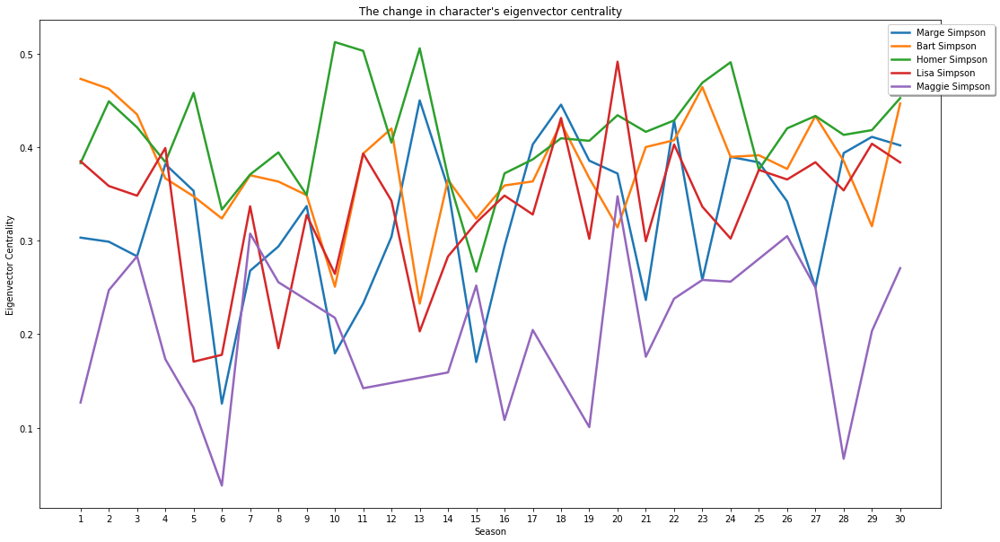

In [360]:
fig = plt.figure(figsize=(18,10))

ax = fig.add_subplot(111)

members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson','Maggie_Simpson']
df_members = df_eigenvector_cents[df_eigenvector_cents['char_wiki_link'].isin(members)].sort_values(by='season')

sns.lineplot(x='season',y='eigenvector_centrality',hue='char_wiki_link', data=df_members, ax = ax, lw=2.5, markers=True)


ax.legend(loc='upper center', bbox_to_anchor=(1, 1),
          fancybox=True, shadow=True, ncol=1, labels=['Marge Simpson','Bart Simpson','Homer Simpson',
                                                     'Lisa Simpson', 'Maggie Simpson'])
plt.xticks(range(1,31))

plt.title("The change in character's eigenvector centrality")
plt.xlabel('Season')
plt.ylabel('Eigenvector Centrality')
plt.show()

Here it can be seen that **Lisa** and **Marge** seem to have an upwards trend in regards to the eigenvector centrality, while **Bart** and **Homer** don't seem to have a trend thoughout the graph even though there are high flunctuations in their eiginvector centarlity.

**Lets make a regression of the eigenvector centarlity of each of the top characters.**

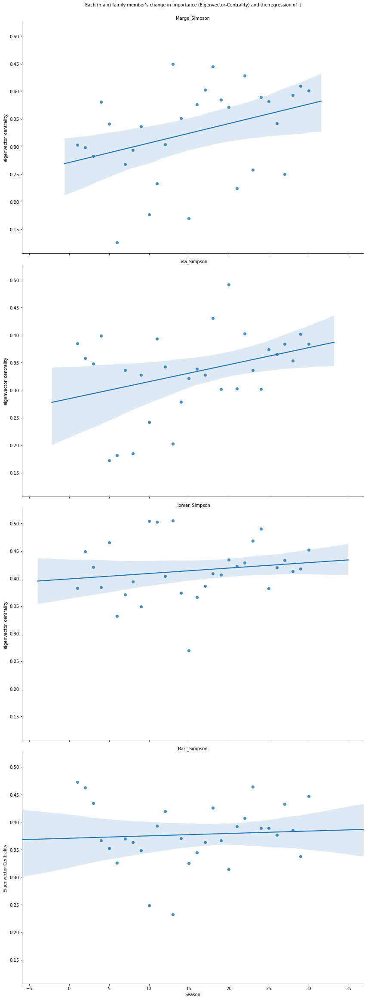

In [766]:
members = ['Homer_Simpson','Bart_Simpson','Lisa_Simpson','Marge_Simpson'] 
# Exclude Maggie, as she does not seem to be an important character

df_members = df_eigenvector_cents[df_eigenvector_cents['char_wiki_link'].isin(members)].sort_values(by='season')
g = sns.lmplot(x='season',y='eigenvector_centrality',col='char_wiki_link', data=df_members, height=8, aspect=1.5, col_wrap=1,)
g.set_titles('{col_name}')
plt.text(2,1.88,"Each (main) family member's change in importance (Eigenvector-Centrality) and the regression of it")
plt.xlabel('Season')
plt.ylabel('Eigenvector Centrality')
plt.show()

The results appear to be the same as before, i.e. the importance in respect to eigenvector-centrality seems to state that **Lisa** and **Marge** have a bigger role to play than they did before, while **Bart and Homer's importance** seem to stay the same.

## 3.3.3 Summary of Findings <a class="anchor" id="three.three.three"></a>

While the collection of synopsis for each episode in order to create a representative network for each season of the series might not be the best way to pinpoint the change over the years, there are some very interesting results that see the light of day. 

The importance of the main characters seems to change over the years, with **Marge** and **Lisa** gaining a more important role in the series while the previously dominating importance of **Bart** and **Homer** seems to take a small side step to that. 

This could suggest that viewers respond better to episodes that include **Bart** or **Homer** rather than **Marge** or **Lisa**.

Since the vast majority of the viewers of the show are men, it could be that they better relate to male characters. Thus a possible explanantion of a part of the decline in ratings could be because of female characters gaining more importance in the show.

**Limitations**

These networks are created from the synopsis for each episode of a season. These synopsis sometimes create links between characters which do not represent their interaction within the episode, i.e. if there are subplots (A-plot and B-plot) for an episode, those that appear together in the
A-plot (the main plot of the episode) are linked with those that appear in the B-plot (the subplot of an episode) maybe without them actually interacting together in the episode. 

# 3.4 The Combined Network of all Seasons <a class="anchor" id="three.four"></a>

In order to create a clear image of The Simpsons, a network of all the seasons combined was created. This creates a holistic view of "30 years of The Simpsons" and creates opportunity for community detection and more.

### 3.4.1 Creating the Network  <a class="anchor" id="three.four.one"></a>

**Lets create the combined network.**

In [363]:
def create_series_graph():
    
    season_graphs = []
    
    for season in df_episodes_ratings['season'].unique():
        G = nx.Graph(season=season)
        # Nodes
        episodes = df_episodes_ratings[df_episodes_ratings['season']==season]['no_overall'].unique()
        nodes = []
        nodes_array = []
        for episode in episodes:
            nodes_array.append(extract_characters(episode))
        for node_set in nodes_array:
            for node in node_set:
                nodes.append(node)

        nodes_to_remove = []
        for node in nodes:
            if(node in df_char['extra_wiki_link'].unique()):
                # Replace this node with the longer wiki name
                nodes_to_remove.append(node)

        # Remove the nodes that appear twice with different names.
        for node in nodes_to_remove:
            nodes.remove(node)
            nodes.append(df_char[df_char['extra_wiki_link']==node]['char_wiki_link'].values[0])
        overall_nodes = list(set(nodes))
        # Node weights
        node_weights = Counter(nodes)
        # Edges
        overall_edges = []
        for episode in episodes:
            episode_edges = create_episode_edges(episode)
            for edge in episode_edges:
                overall_edges.append(edge)
        overall_edges_weights = {}
        for edge in overall_edges:
            overall_edges_weights[edge[0],edge[1]] = overall_edges.count([edge[0],edge[1]]) + overall_edges.count([edge[1],edge[0]])

        for edge in overall_edges:
            G.add_edge(edge[0],edge[1],weight=overall_edges_weights[edge[0],edge[1]])
        for node in overall_nodes:
            G.add_node(node,weight=node_weights[node])
            
        season_graphs.append(G)
    
    G_series = nx.Graph()
    
    series_nodes = []

    series_edges = []
    
    for G in season_graphs:
        series_nodes.extend(G.nodes())
        series_edges.extend(G.edges())
    
    series_nodes_weights = Counter(series_nodes)
    for node in series_nodes:
        G_series.add_node(node, weight = series_nodes_weights[node])
    
    series_edges_weights ={}

    for edge in series_edges:
        series_edges_weights[edge[0], edge[1]] = series_edges.count((edge[0], edge[1])) + series_edges.count((edge[1], edge[0]))
    
    for edge in series_edges:
        G_series.add_edge(edge[0], edge[1], weight = series_edges_weights[(edge[0], edge[1])])

    return G_series


In [364]:
G_series = create_series_graph()

**Create a function to make a nice drawing of the network.**

In [365]:
def draw_series_graph():
    
    G = create_series_graph()
    
    forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.2,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.002,
                        strongGravityMode=False,
                        gravity=1.0,

                        # Log
                        verbose=False)
    
    
    fig = plt.figure(figsize=(18,15))
    positions = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=2000)
    
    bc = nx.degree_centrality(G)
    cw = plt.cm.get_cmap('coolwarm')    
    nodelist = G.nodes()
    cmap = []
    for node in nodelist:
        cmap.append(cw(bc[node]))
    
    edge_weights = [G[u][v]['weight'] for u,v in G.edges()]
    nodelist = list(dict(G.nodes.data('weight')).keys())
    node_weights = list(dict(G.nodes.data('weight')).values())

    
    nx.draw_networkx_nodes(G, positions, nodelist = nodelist, node_size= [v*100 for v in node_weights], 
                           node_color=cmap,alpha=0.75)
    
    nx.draw_networkx_edges(G, positions, width=[v*0.5 for v in edge_weights],alpha=0.5)
    
    ax = plt.gca()
    ax.collections[0].set_edgecolor("black") 
    plt.axis('off')
    plt.title('30 years of The Simpsons')

    
    colors=range(20)
    cmap=plt.cm.coolwarm
    vmin = min(bc.values())
    vmax = max(bc.values())

    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = 0, vmax=1))
    sm._A = []
    plt.colorbar(sm, shrink=0.25,label='Betweenness Centrality')
    plt.show()

**Draw the graph where the node size depends on number of apperances and color on their betweenness centrality.**

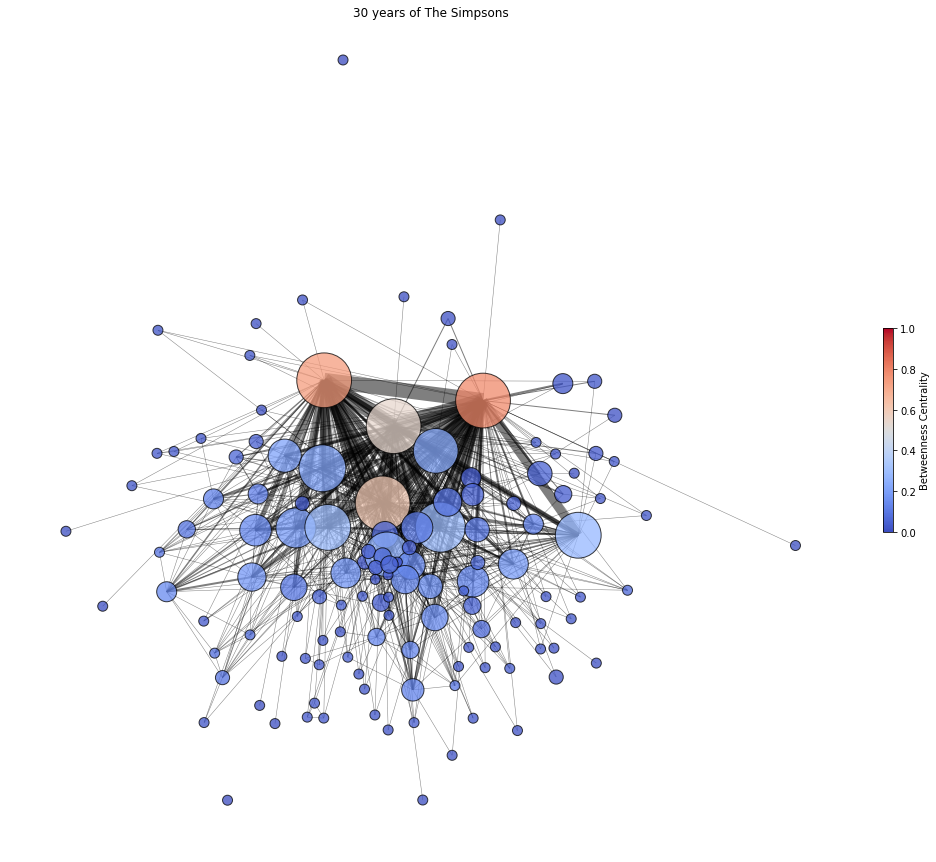

In [366]:
draw_series_graph()

In order to make the visualization cleaner, node labels have been omitted. In this graph, each node's size is in relation to the character's appearances in all 30 seasons. 

The edges are again in relation to how often two characters appear in the same episode. 

Here, the color is in respect to each node's **betweenness centrality**, the warmer the color, the higher the node's **betweenness centrality** is.  

From this graph, the most influencial nodes can quickly be identified. It can be suspected that the **four** nodes that appear the warmest are *Homer, Bart, Lisa* and *Marge* because of the analysis that has been carried out above. 

These nodes seem to be the only *influencial* nodes within the graph.

### 3.4.2 Community Analysis  <a class="anchor" id="three.four.two"></a>

It can be assumed that there exist some communities within this network because of the nature of the show, i.e. the show revolves around one **family** in which the members have different connections to different **recurring characters**. 

**Using Louvain Community Partition, seperate communities can be found.**

In [367]:
best_mod = -np.inf
for i in range(1000):
    louvain_community_partition = community_louvain.best_partition(G_series)
    if community.modularity(louvain_community_partition,G_series) > best_mod:
        best_mod = community.modularity(louvain_community_partition,G_series)
        best_partition = louvain_community_partition

**Find the number of communities found.**

In [368]:
len(set(best_partition.values()))

8

**Find the modularity.**

In [369]:
best_mod

0.1375702720848494

From this partition, the graph is split into **eight different communities** with a modularity of only 0.138. From this, it can be gathered that the communities that this graph is partitioned into are not easily detected, i.e. are not *clean partitions*.

This might be because simply connecting characters that appear in an episode together might not be the best way to simplify their connection.

**Visualizing the partitions might shed light on the partition.**

In [370]:
df_communities = pd.DataFrame.from_dict(best_partition, orient='index')
df_communities.reset_index(inplace=True)
df_communities.columns = ['name','community']

In [371]:
for com in range(len(set(best_partition.values()))):
    names = df_communities[df_communities['community'] == com]['name'].unique()
    print("Community",com)
    print(names)
    print("\n")

Community 0
['Marge_Simpson' 'Lisa_Simpson' 'Bleeding_Gums_Murphy' 'Maggie_Simpson'
 'Princess_Kashmir' 'Robert_Terwilliger' 'Lucille_Botzcowski' 'Artie_Ziff'
 'Patty_Bouvier' 'Selma_Bouvier' 'Leon_Kompowsky' 'Lurleen_Lumpkin'
 'Llewellyn_Sinclair' 'Lyle_Lanley' 'Roger_Meyers,_Jr.'
 'Jacqueline_Bouvier' 'Allison_Taylor' 'Joe_Quimby' 'Lard_Lad'
 'Shary_Bobbins' 'Cecil_Terwilliger' 'Dash_Dingo' 'Judge_Constance_Harm'
 'Cletus_Spuckler' 'Lindsey_Naegle' 'Coach_Krupt' 'Kent_Brockman'
 'Donny_(The_Debarted)' 'Bashir_bin_Laden' 'Juliet_Hobbes' 'Andy_Hamilton'
 'Emily_Winthrop' 'Mary_Spuckler' 'Isabel_Gutierrez' 'Lucas_Bortner'
 'Snowball_V' 'Dewey_Largo']


Community 1
['Charles_Montgomery_Burns' 'Homer_Simpson' 'Marvin_Monroe'
 'Krusty_the_Clown' 'Kodos' 'Herbert_Powell' 'Fat_Tony' 'Moe_Szyslak'
 'Groundskeeper_Willie' 'Barney_Gumble' 'Nick_Riviera' 'Bobo_(Dog)'
 'Waylon_Smithers,_Jr.' 'Doris_Freedman' 'Lenny_Leonard' 'Carl_Carlson'
 'Jay_Sherman' 'Rainier_Wolfcastle' 'Mona_Simpson' 'Hugo_S

It does seem that the **3 largest communities** are centered around **Homer**, **Bart** and **Marge & Lisa** respectively, with Marge and Lisa "sharing" a community. By going through the names that exist within the main characters' communities, it can be seen that most characters have strong links *within the show* to these characters, e.g. 

*Homer Simpson* and *Mr. Burns* (employee/employer)

*Homer Simpson* and *Herbert Powell* (half brothers)

*Bart, Martin* and *Nelson* (school-mates)

*Bart* and *Edna Krabappel* (student and teacher)

*Bart* and *Milhouse* (best friends)

*Marge* and *Artie Ziff* (former lovers)

*Marge, Patty* and *Selma* (sisters)

etc. 

So there seems to be some sensible community detection, at least in the two biggest communities. This does seem to boost the theory that **Homer** and **Bart** are the most influencial characters of the series. 

**Lets draw the network with the different commuities in different colors.**

In [386]:
def draw_series_communities():
    
    forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.0002,
                        strongGravityMode=False,
                        gravity=0.5,

                        # Log
                        verbose=False)
    fig = plt.figure(figsize=(18,15))

    positions = forceatlas2.forceatlas2_networkx_layout(G_series, pos=None, iterations=2000)

    color_map = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8",
             "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45", "#fabebe", 
             "#469990", "#e6beff", "#9A6324", "#fffac8", "#800000", "#aaffc3",
             "#808000", "#ffd8b1", "#000075", "#a9a9a9","#000000"]

    for com in set(best_partition.values()) :
        list_nodes = [nodes for nodes in best_partition.keys()
                                    if louvain_community_partition[nodes] == com]
        nx.draw_networkx_nodes(G_series, positions, list_nodes, node_size = 250, alpha=0.75,
                                    node_color = color_map[com])

    new_cm = ListedColormap(color_map[:len(set(best_partition.values()))])
    nx.draw_networkx_edges(G_series,positions, width=0.2,alpha=0.8)
    ax = plt.gca()
    
    for i in range(len(set(best_partition.values()))-1):
        ax.collections[i].set_edgecolor("black") 


    sm = plt.cm.ScalarMappable(cmap=new_cm,norm=plt.Normalize(vmin = 0, vmax=len(set(best_partition.values()))))
    sm._A = []
    cbar = plt.colorbar(sm, shrink=0.25,drawedges=True,label='Community')
    
    plt.axis('off')
    plt.title("The communities of characters from The Simpsons")
    plt.show()


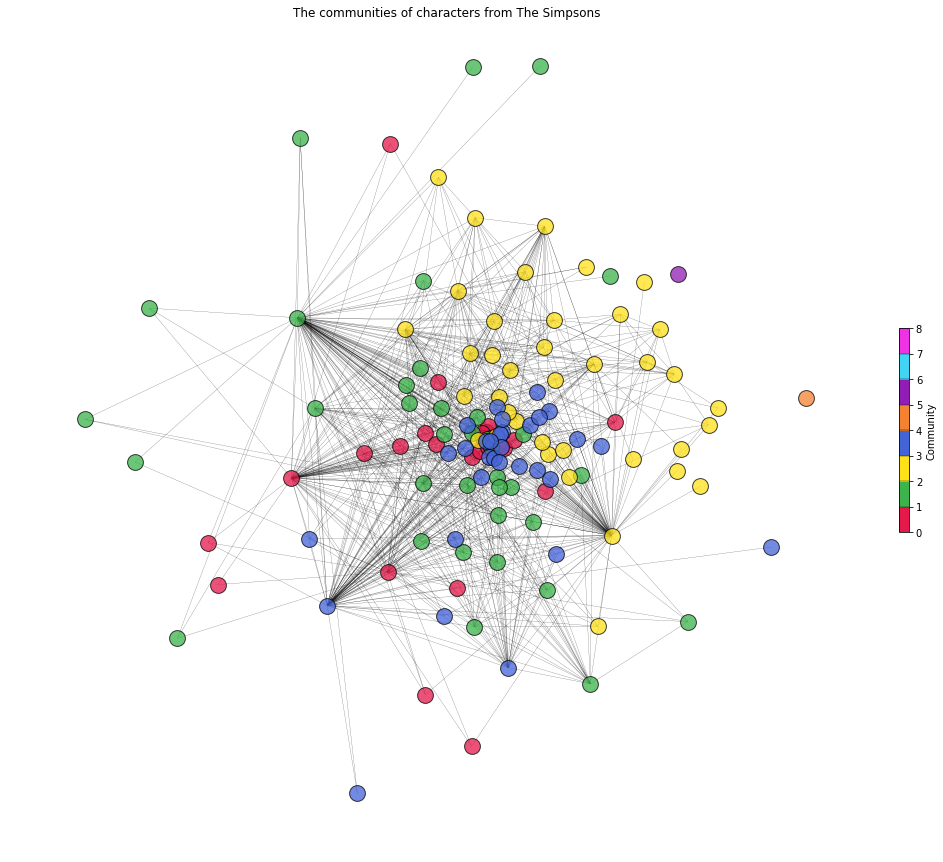

In [387]:
draw_series_communities()

### 3.4.3 Summary of Findings <a class="anchor" id="three.four.three"></a>

The combined network for all the seasons gave insight into the main characters and their connections. The four main characters, the Simpsons family, have the largest degree as well as highest betweenness centrality and play a key role in the network of characters and interactions.

In the community detection eight commuities were detected. Two of the commuities only consisted of one character (blue and purple nodes), which have no connections. Theses caracters seem to appear in the synopsis of one episode where non other caracters are mentioned. 

The four biggest commuities gave some insight into the groups in the shows. One of them was centered around **Bart**, and consisted mainly of his schoolmates and friend. The secound community evolved around **Homer** and his connections, fx. employees and relatives. The third community included **Merge** and **Lisa**, where Merge's sisters and a former lover were among the members of the community.

## 3.5 Summary of Findings <a class="anchor" id="three.five"></a>

It can be seen that by looking into the synopsis and the scripts there are some changes throughout the seasons that could explain why the ratings and the number of viewers have been declining. The main findings are:

- **Merge** and **Lisa** are gaining a more important role in the series according to all centrality measures of the network, while the importance of **Homer** and **Bart** is declining. 
- The developement in the networks shows that the **lower rated seasons have fewer nodes and links**.
- When looking at the **sentiment scores of spoken words** in the seasons it can be seen that it has a **small upwards trend**. It also has a correlation of -0.48 to the ratings, which tells us that while the sentiment score has been going up the ratings have been going down. 
- The number of **words spoken on average per episode in a season has been falling** almost since the start. The average number of words spoken in an episode in season 1 was 1527 vs. 1289 in season 26. 
- When looking at the sentiment scores of each character it can be seen that the members of **the Simpsons family are getting slightly happier** in regards to spoken words. Five of the top 20 speaking characters have a noticable high upwards trend: **Milhouse Can Houten**, **Nelson Muntz**, **Lenny Leonard**, **Carl Carlsson** and **Julius Hibbert**.
- **Merge** and **Lisa** have a higher sentiment score on average than **Homer** and **Bart**.
- When looking at the **td-idf scores of the different seasons**:
	- The most liked seasons seem to have **music** or **military** as main topics, or even a non apperant main topic but revolve about the parody of a **stereotypical americal family**. 
	- The least liked seasons are those which have high importance on **politics**, **religion** and **ethics**.
	- The topic **environment**, seem to be present along all the observed seasons and is very linked to Lisa's "green" character. It looks like when it comes to animal safeguard people are more sensible than what they are with the wilderness.
- Looking into the four main characters and their developement in regards to the most important spoken words, their **personalities and role do not seem to have changed alot during the seasons**.
	- **Bart** has been a rebel throughout the series, but has lately been showing increasing interest in girls.
	- **Homer** has the biggest role and contributes most to the main topics of the seasons, speaking over 30% of all the spoken words.
	- **Marge** has been showing bigger importance to motherhood as the show goes on, but stays true to herself.
	- **Lisa** is mostly connected with arts and evironment.

The results of the demographic analysis were that **men are the vast majority of the raters** and the main age group that is rating the series is people from 30-44 for both genders. When looking at the ratings in respect to gender it can be seen that the **fall in the ratings is not as big for the female audience as the male audience**. 

From the findings it could be suggested that the **viewers respond better to more sad episodes**, where **many words are spoken**, where there is **no apperent specific topic** and where **Bart and Homer play a big role**. When linking thoses results to the fact that the ratings for women audience have not fallen as much as for the male audience, this hints that women have different prefrences than men in regards to the tv-show.

Even though the findings suggests some factors that could affect the ratings of the Simpsons, **these factors are not likely explain all the decines in ratings**. Even though the spoken words and the synopsis tell alot about the content of the show, the environment, circumstances, how things are said also affect how people relate to the characters and the show.



# 4. Discussion <a class="anchor" id="four"></a>

The results gained from the analysis provided valuable insight into the possible causes of the delining popularity of **the Simpsons.** As stated earlier, it is hard to confirm whether some of the findings are directly linked to the delining rates, but they shed a light on possible causes. 

Being able to get the most important topics out of each episode/season from big datasets like the scrips is really valuable. It gives the opportunity to obtain knowleadge which otherwise would take much more work, fx. by watching all the episodes. The downside to this was that it was hard to find an effiecent way to diplay all the wordclouds and make sence of them, and the possiblities were endless. There is possibly a more efficient way to do this than presented in this notebook, but the analysis took a lot of time and effort and in the end produced some interesting results.

In the sentimental analysis the interval changes of the happinesscore over the seasons were really low, but showed some trends which were interpreted and used for the results. Possibly the results relied to much on these small changes, but it was hard to say how big the changes had to be to be considered significant. That put aside the insights gained from the sentimental was valuable and showed how the seasons were getting happier.

The links in the networks were built based on whether two charactes appered toghether in a synopsis for an episode, which means that it is not known if they interact in that given episode. This may cause some inaccuracy in the networks, but was considered to be the most efficient way to build the network with the data available. The networks provied some interesting results in how the main characters importance has been changing throughout the seasons.

What was interesting with the findings was they all aligned really well together and seemed to make sence as whole as was showed in the last chapter.

# 5. Contributers  <a class="anchor" id="five"></a>

All team members were equally involved in planning, discussing, analysing and solving the problems. The responsibility of the each part of the project was split up in the following way:

| Person   | Contribution                                                                     |   |
|----------|----------------------------------------------------------------------------------|---|
| **Auður**    | Sentimental Creation and Analysis                                                |   |
| **Nicoló**   | TF-IDF Creation and Analysis                                                     |   |
| **Matthías** | Data Collection and Cleaning. Network(s) Creation and Analysis |   |